# Lesson 3: Basic Python for Data Analytics (Stocks Prediction)

# Introduction of Pandas


pandas is a DataFrame Framework, a library that stores data in a highly efficient spreadsheet format and functions.
Efficient in:
1. Data Structure (numpy)
2. Computing time (since DataFrame is processed by C++, it runs in a well streamlined computing environment)
3. Highly optimized and updated processes


[For more details of numpy](https://en.wikipedia.org/wiki/NumPy)

[For more details of pandas cookbook and 10 minutes basic](http://pandas.pydata.org/pandas-docs/stable/10min.html)

## Objective

* To use pandas to load the latest updated data from Yahoo Finance
* To explore and understand the dataset 
    * Viewing the data
    * Correlation Analysis
    * Graphing using matplotlib
* To predict the return of the stocks in the next period - Prediction analysis
    * Simple Linear Analysis
    * Quadratic Linear Analysis (QDA)
    * K Nearest Neighbor (KNN)
* Comparing models and discuss improvements
* Challenges:
    * Assuming economic qualitative factors such as news (news sourcing and sentimental analysis)
    * Assuming economic quantitative factors such as HPI of a certain country, economic inequality among origin of company
    * Cleaning out the data
    * Importing data files
* Next lesson:
    * Lesson 4 Basic Python for Data Analytics (Predicting Employee Retention)

## Loading YahooFinance Dataset

In this demonstration, we will use pandas web data reader. This is an extension of pandas library to communicate with most updated financial data. 

This will include sources as:
* Yahoo! Finance
* Google Finance
* Enigma
* FRED
* Fama/French
* World Bank
* OECD
* Eurostat
* EDGAR Index
* TSP Fund Data
* Oanda currency historical rate
* Nasdaq Trader Symbol Definitions

[For more details of pandas webreader](https://pandas-datareader.readthedocs.io/en/latest/)  

In [15]:
import sys
print (sys.prefix)

/usr


In [16]:
!pip install pandas
!pip show pandas_datareader
!pip install --upgrade pandas_datareader

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Name: pandas-datareader
Version: 0.10.0
Summary: Data readers extracted from the pandas codebase,should be compatible with recent pandas versions
Home-page: https://github.com/pydata/pandas-datareader
Author: The PyData Development Team
Author-email: pydata@googlegroups.com
License: BSD License
Location: /usr/local/lib/python3.7/dist-packages
Requires: lxml, pandas, requests
Required-by: 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [17]:
pip install pandas-datareader

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [18]:
!pip install yfinance
import yfinance as yf


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [19]:
ipsa = ['HLAG.DE','MAERSK-B.CO','VALE','INVERCAP.SN','SQM-B.SN','CHILE.SN','BSANTANDER.SN','COPEC.SN','CENCOSUD.SN','FALABELLA.SN','ENELAM.SN','CMPC.SN','BCI.SN','VAPORES.SN','CAP.SN','CCU.SN','ENELCHILE.SN','ANDINA-B.SN','CONCHATORO.SN','PARAUCO.SN','ITAUCORP.SN','AGUAS-A.SN','COLBUN.SN','CENCOSHOPP.SN','ENTEL.SN','MALLPLAZA.SN','IAM.SN','SMU.SN','ECL.SN','SONDA.SN','RIPLEY.SN','SECURITY.SN', 'QUINENCO.SN', 'BESALCO.SN','MASISA.SN', 'LTM.SN','ENJOY.SN','NVDA','AMD','TSLA', 'LMT','AMZN', 'FB','AAPL','ALB','BABA','MELI','GPS','JNJ','WMT']
accion_predecir = 'QUINENCO.SN'


In [20]:
import pandas as pd
import datetime
import pandas_datareader.data as web
from pandas import Series, DataFrame

#start = datetime.datetime(2002, 1, 1)
start = datetime.datetime(2000, 1, 1)
end = datetime.datetime(2022, 11, 22)

df = web.DataReader(accion_predecir, 'yahoo', start, end)
df.tail()

,High,Low,Open,Close,Volume,Adj Close
Date,,,,,,
2022-11-16,2678.699951,2660.0,2675.0,2673.699951,12080.0,2673.699951
2022-11-17,2700.000000,2650.0,2700.0,2670.100098,236915.0,2670.100098
2022-11-18,2691.000000,2651.0,2691.0,2691.000000,24671.0,2691.000000
2022-11-21,2730.000000,2680.5,2700.0,2700.000000,62311.0,2700.000000
2022-11-22,2750.000000,2646.0,2700.0,2696.600098,600185.0,2696.600098


In [21]:
#CODIGO EN DESARROLLO

def acciones(accion_predecirs):
  df = accion_predecirs[0:-3]
  globals()[str(accion_predecirs.replace(".",""))] = web.DataReader(accion_predecirs, 'yahoo', start, end)
  return globals()[str(accion_predecirs).replace(".","")]
 
for i in ipsa:
  print("******************************************************************************")
  print(i)
  d = acciones(i)
  print(d)
  d.tail()
  print(d)

  print(type(d))
  print("dataframe name: "+str(d))
 

******************************************************************************
HLAG.DE
                  High         Low        Open       Close     Volume  \
Date                                                                    
2015-11-06   20.181255   19.785543   19.835009   19.993292  1775788.0   
2015-11-09   20.131790   19.859739   20.131790   19.924044    52918.0   
2015-11-10   20.240612   19.785543   19.933935   19.825115   236784.0   
2015-11-11   20.428574   19.513493   19.884472   19.736080  1004556.0   
2015-11-12   19.958668   19.686617   19.696508   19.785543    56239.0   
...                ...         ...         ...         ...        ...   
2022-11-16  190.199997  185.100006  190.000000  188.000000    26424.0   
2022-11-17  191.899994  185.199997  188.199997  187.699997    11621.0   
2022-11-18  189.699997  182.800003  187.000000  187.000000    16268.0   
2022-11-21  191.199997  185.300003  186.199997  190.000000    11068.0   
2022-11-22  192.699997  185.600006  1

Get the dimension of dataframe

In [22]:
'''
for i in ipsa:
  print("******************************************************************************")
  print(i)
  d = acciones(i)
  d.tail()
  print(d)
  print("******************************************************************************")

'''

'\nfor i in ipsa:\n  print("******************************************************************************")\n  print(i)\n  d = acciones(i)\n  d.tail()\n  print(d)\n  print("******************************************************************************")\n\n'

## Exploring the data 

First we will need to explore the data.
This means understanding the stocks data trend thoroughly by finding key measures
* rolling mean (moving average) -- to determine trend
* return deviation -- to determine return deviation

[For more details of rolling mean](http://www.investopedia.com/articles/active-trading/052014/how-use-moving-average-buy-stocks.asp) 


In [23]:
close_px = VAPORESSN['Adj Close']
mavg = close_px.rolling(window=100).mean()
mavg.tail(10)

Date
2022-11-09    80.3795
2022-11-10    80.2000
2022-11-11    80.0720
2022-11-14    79.9375
2022-11-15    79.8405
2022-11-16    79.7407
2022-11-17    79.6097
2022-11-18    79.4197
2022-11-21    79.2899
2022-11-22    79.1721
Name: Adj Close, dtype: float64

In [24]:

for i in ipsa:

  globals()["close_px_" + str(i).replace(".","")] = globals()[str(i).replace(".","")]['Adj Close']
  globals()["mavg" + str(i).replace(".","")] = close_px.rolling(window=100).mean()
  globals()["mavg" + str(i).replace(".","")].tail(10)

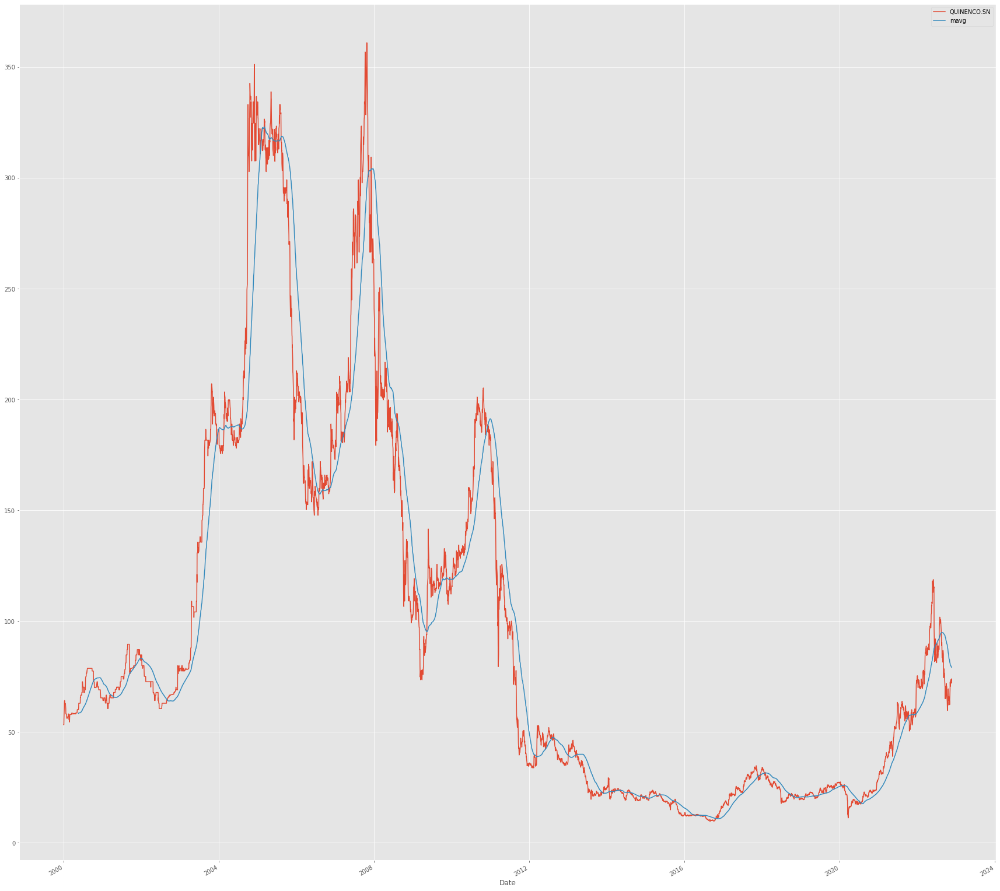

In [25]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import style

# Adjusting the size of matplotlib
import matplotlib as mpl
mpl.rc('figure', figsize=(30, 30))
mpl.__version__

# Adjusting the style of matplotlib
style.use('ggplot')

close_px.plot(label=accion_predecir)
mavg.plot(label='mavg')
plt.legend()

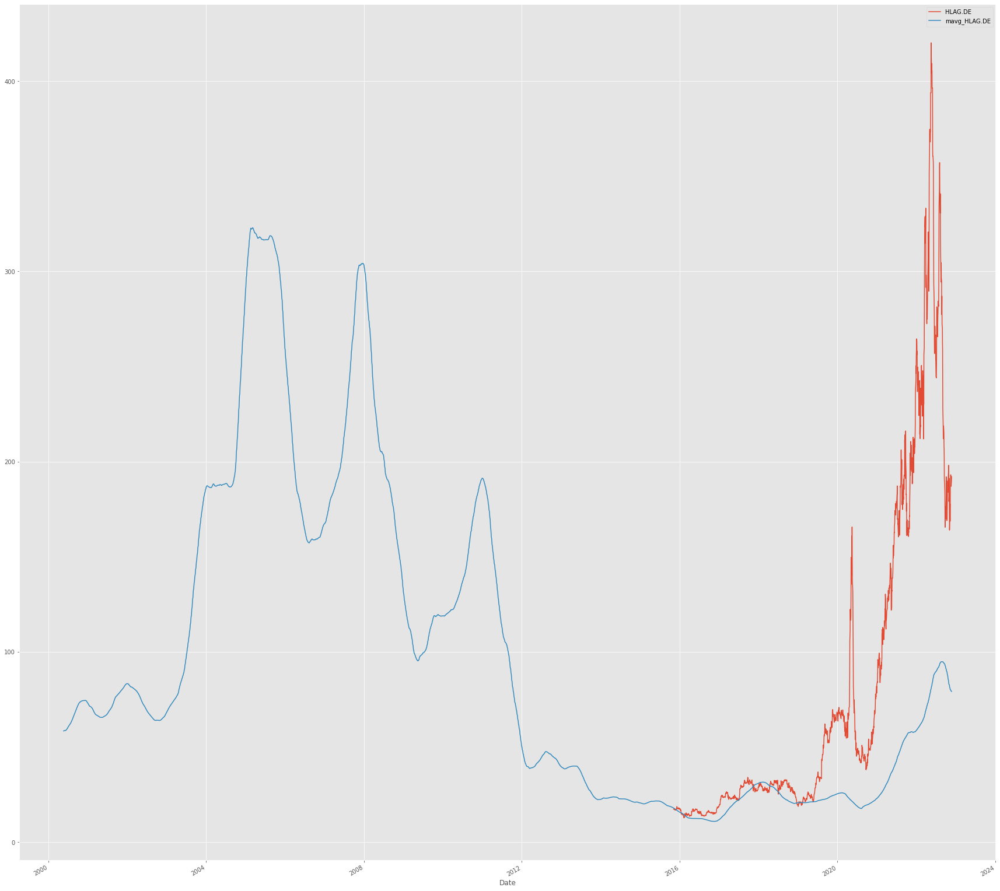

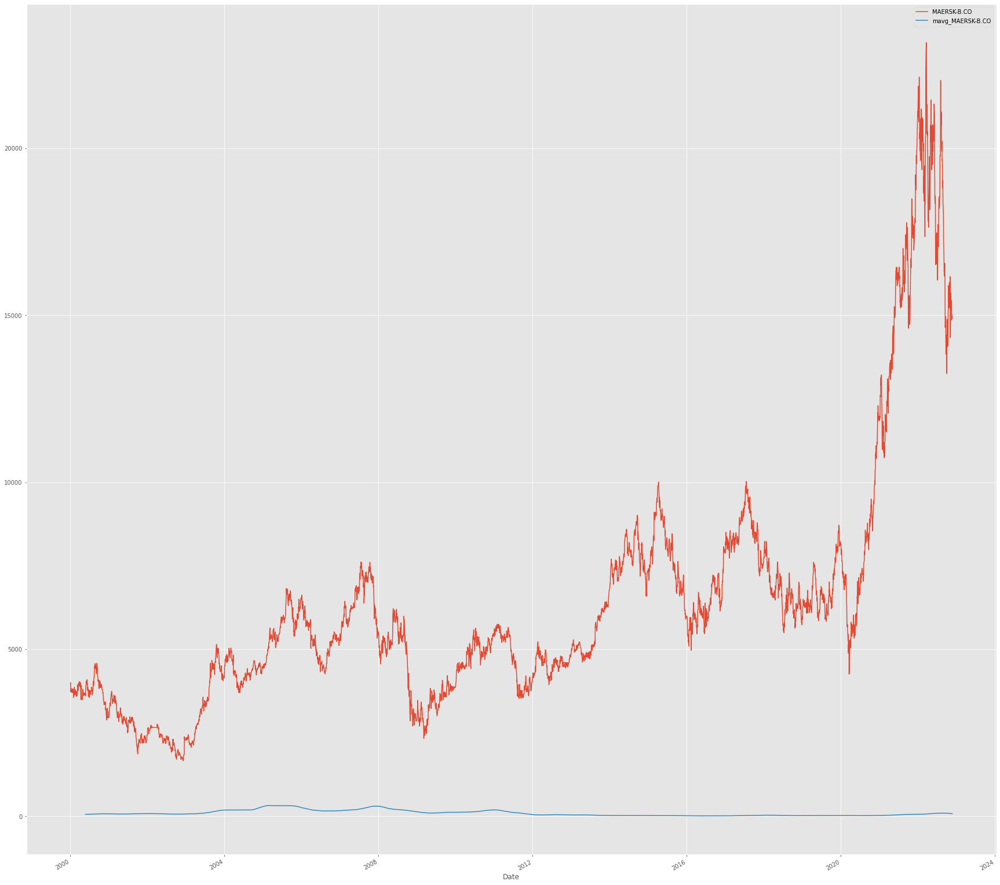

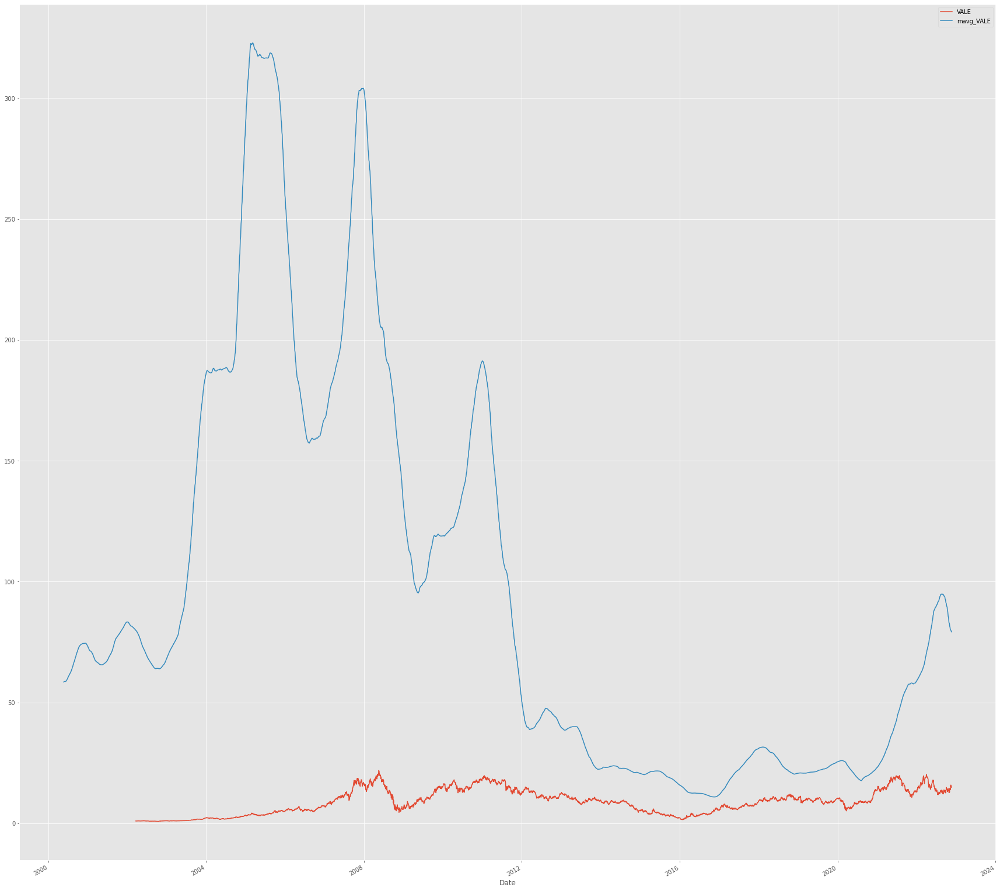

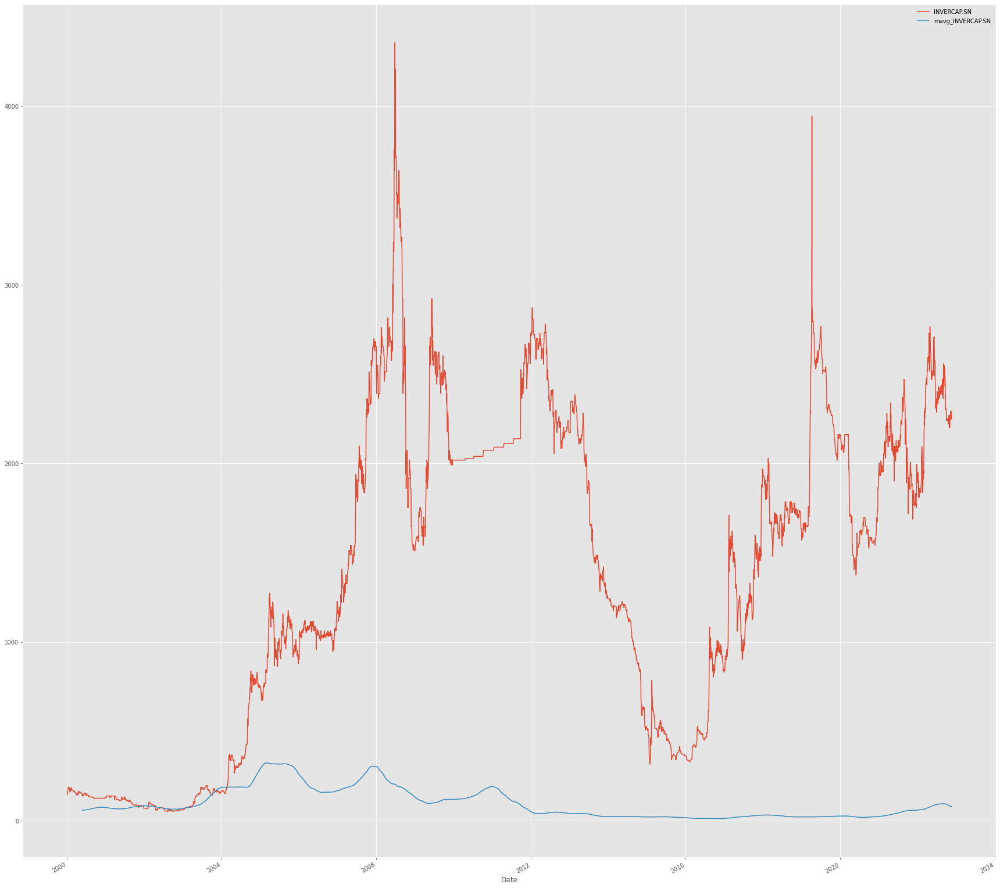

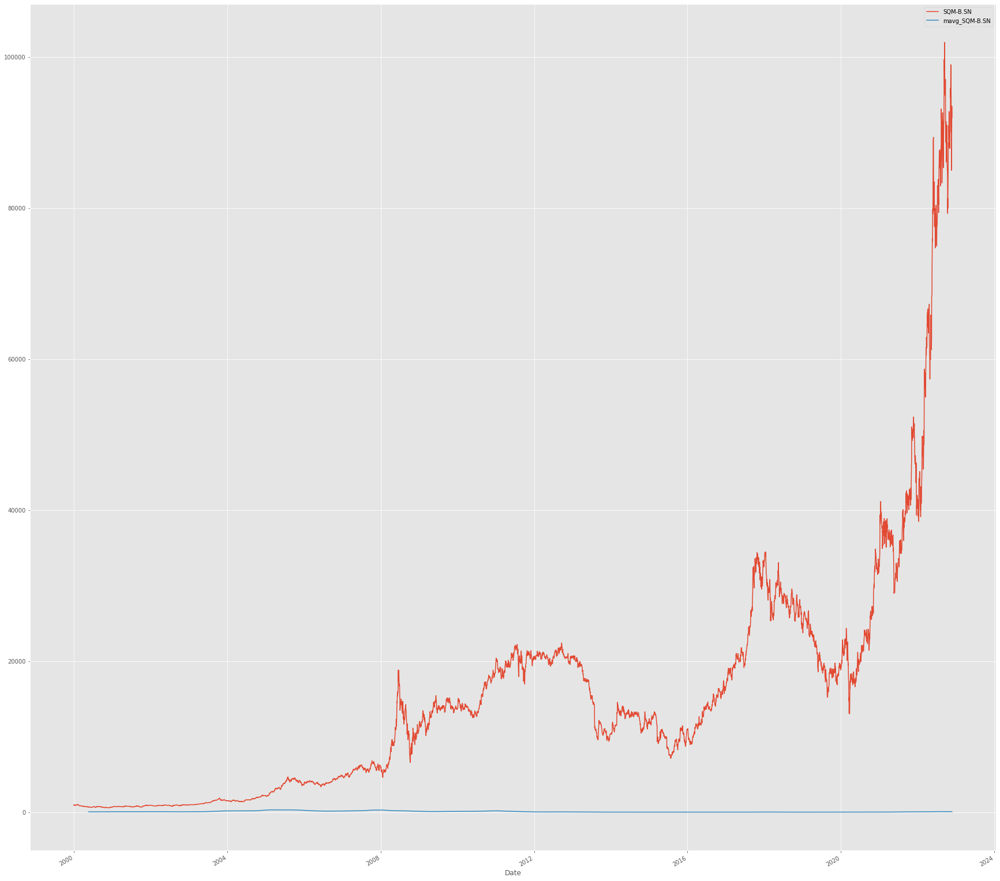

...

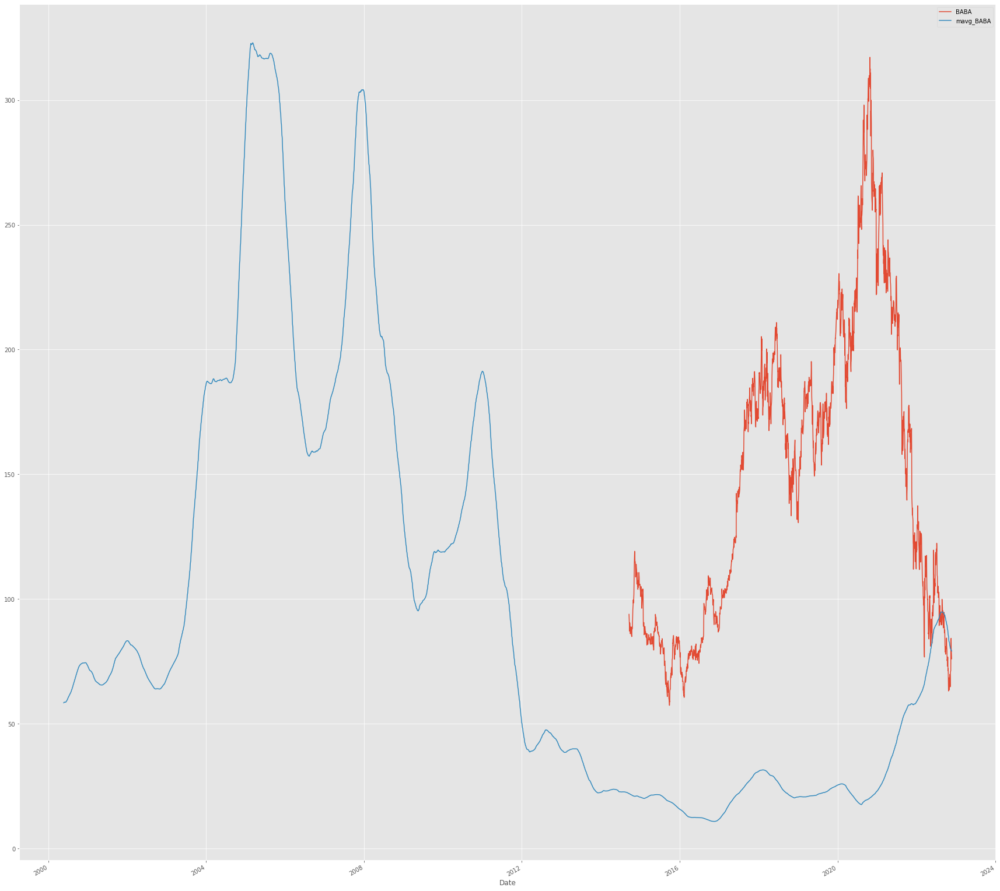

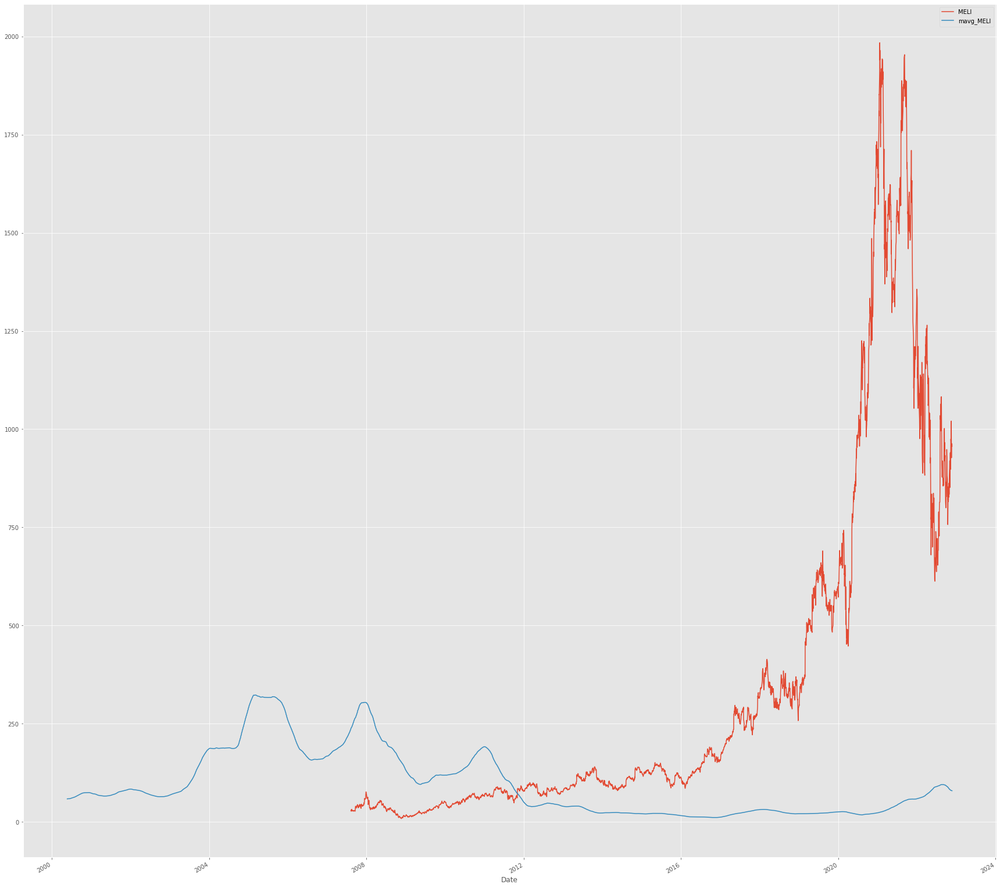

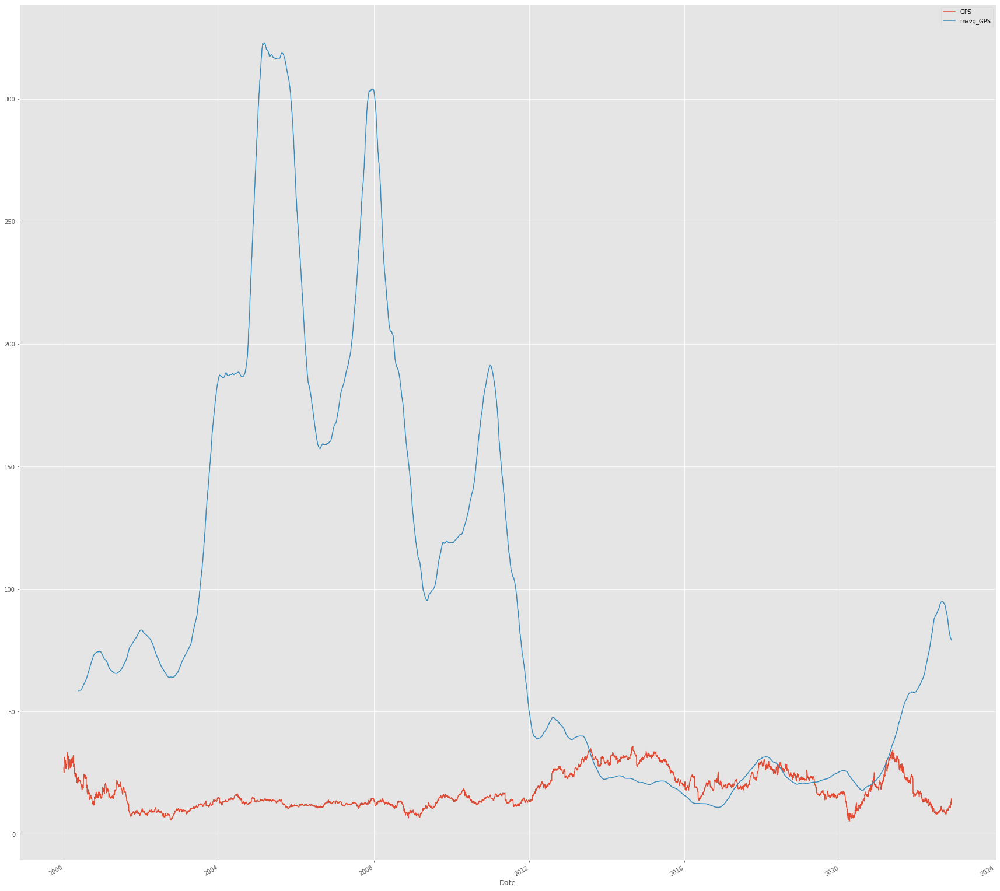

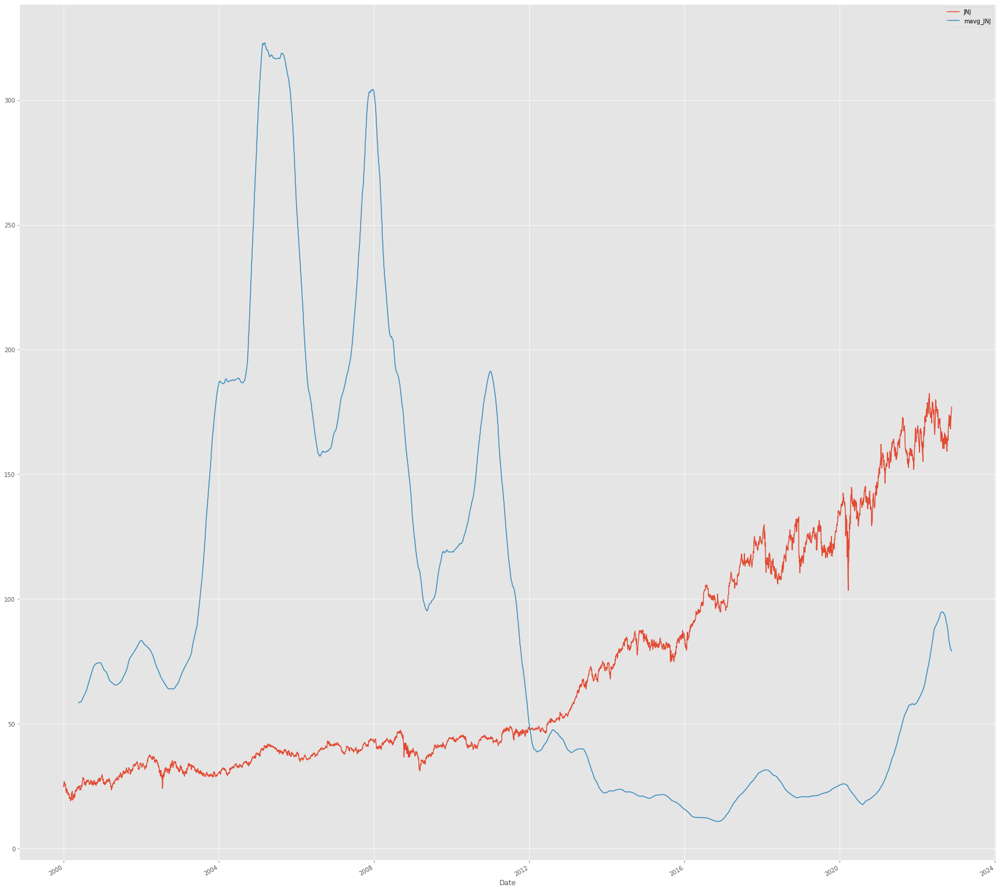

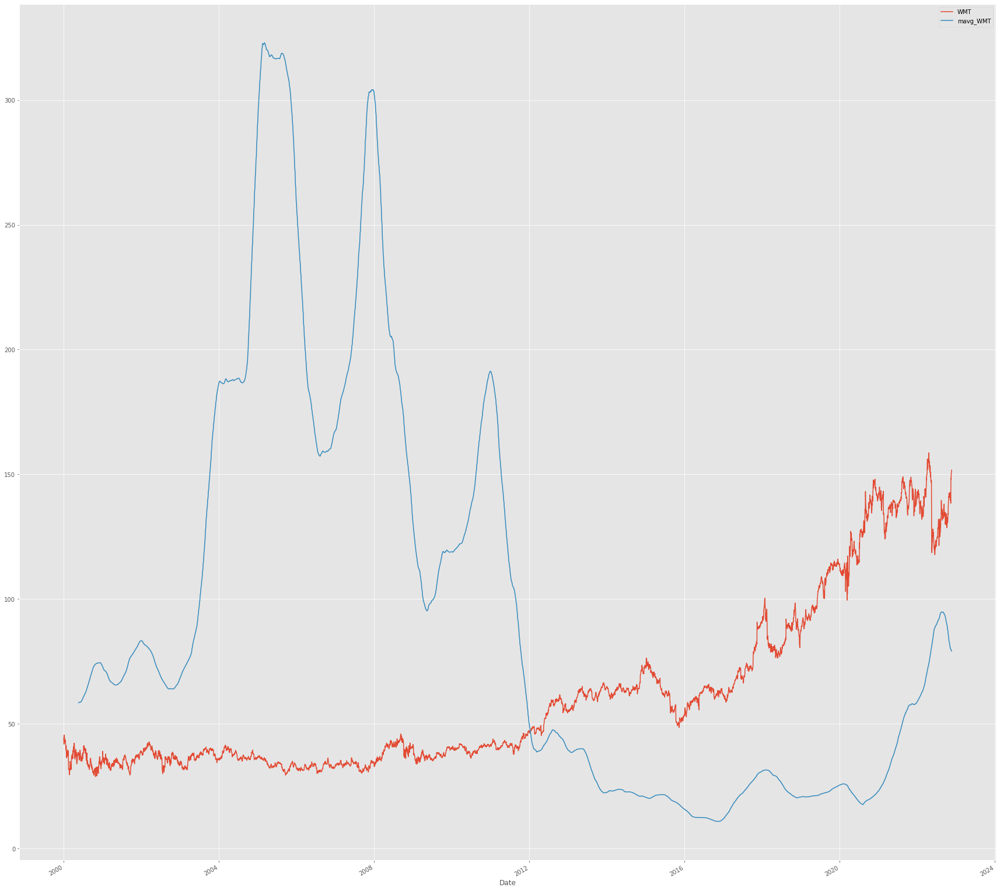

In [26]:
for i in ipsa:
  %matplotlib inline
  import matplotlib.pyplot as plt
  from matplotlib import style

  # Adjusting the size of matplotlib
  import matplotlib as mpl
  mpl.rc('figure', figsize=(30, 30))
  mpl.__version__

  # Adjusting the style of matplotlib
  style.use('ggplot')

  globals()["close_px_" + str(i).replace(".","")].plot(label=i)
  globals()["mavg" + str(i).replace(".","")].plot(label='mavg_'+i)
  plt.legend()
  plt.show()


Returns defined as: 
$$ $$
$$r_t = \frac{p_t - p_{t-1}}{p_{t-1}} = \frac{p_t}{p_{t-1}} - 1$$

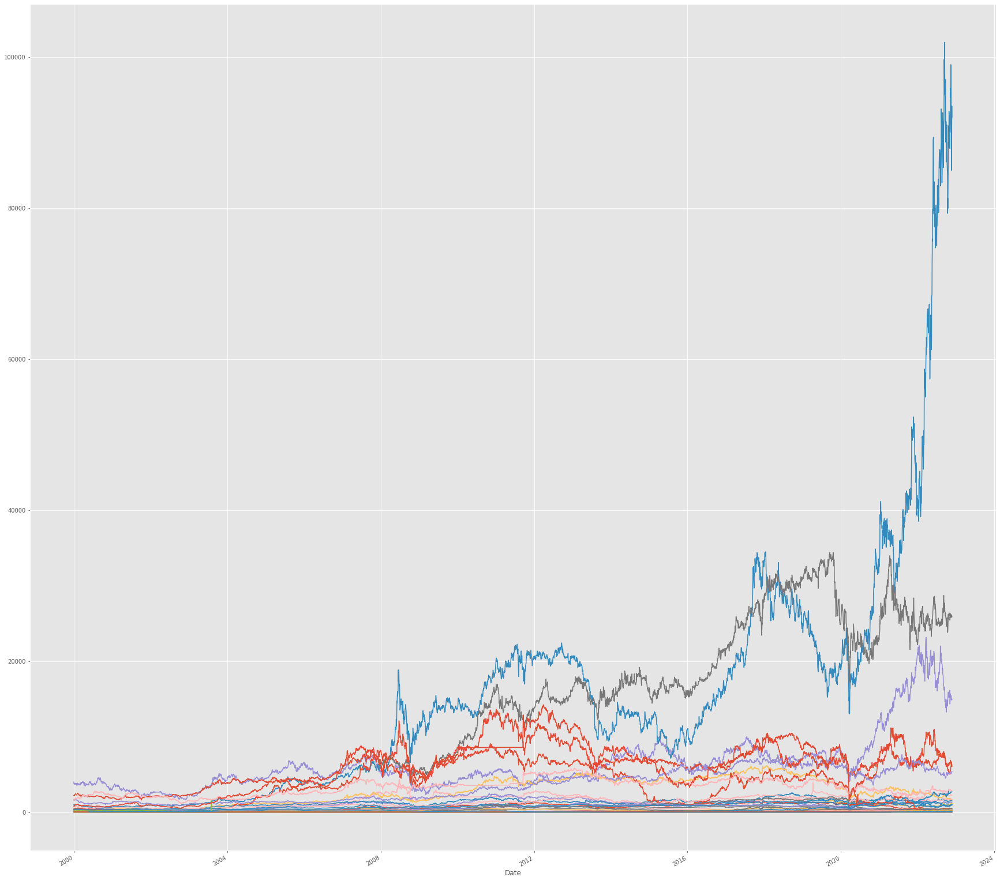

In [27]:
for i in ipsa:
  globals()["close_px_" + str(i).replace(".","")].plot(label=i)
  globals()["mavg" + str(i).replace(".","")].plot(label='mavg_'+i)

  globals()["rets"+str(i).replace(".","")] = globals()["close_px_" + str(i).replace(".","")] / globals()["close_px_" + str(i).replace(".","")] - 1
  globals()["rets"+str(i).replace(".","")].head()

  globals()["close_px_" + str(i).replace(".","")].pct_change().head()

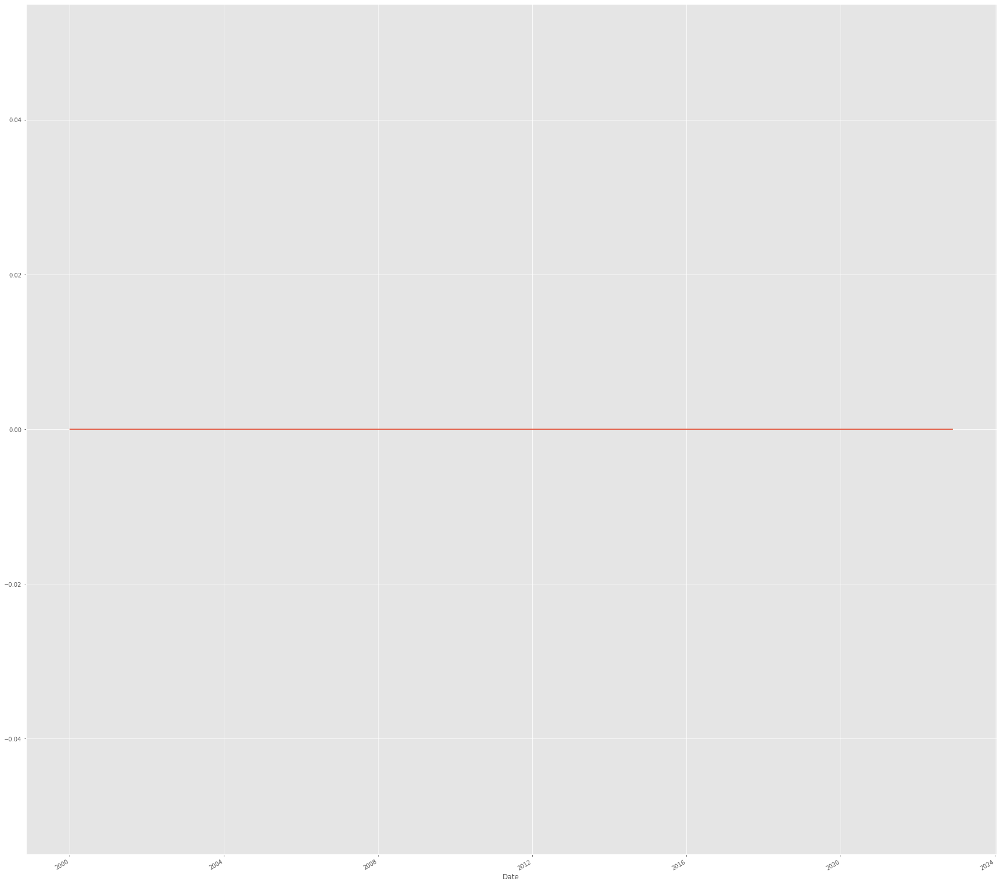

In [28]:
for i in ipsa:
  globals()["rets"+str(i).replace(".","")].plot(label='return')

## Doing the competitor analysis/Correlation

1. How does one company perform in relative with its competitor
2. What are the correlations among these companies

In [29]:

dfcomp = web.DataReader(ipsa,'yahoo',
                               start=start, 
                               end=end)['Adj Close']
dfcomp.tail()

Symbols,HLAG.DE,MAERSK-B.CO,VALE,INVERCAP.SN,SQM-B.SN,CHILE.SN,BSANTANDER.SN,COPEC.SN,CENCOSUD.SN,FALABELLA.SN,...,LMT,AMZN,FB,AAPL,ALB,BABA,MELI,GPS,JNJ,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2022-11-16,188.000000,14855.0,15.220,2293.199951,90900.0,84.389999,33.000000,6360.000000,1300.0,1646.0,...,466.239990,97.120003,113.230003,148.789993,286.769989,78.160004,972.820007,12.040,173.460007,148.500000
2022-11-17,187.699997,14970.0,15.330,2278.300049,85000.0,84.959999,33.000000,6389.899902,1300.0,1605.0,...,472.769989,94.849998,111.449997,150.720001,277.450012,84.260002,927.130005,12.710,174.860001,148.000000
2022-11-18,187.000000,15020.0,15.070,2248.199951,85400.0,84.760002,33.700001,6330.000000,1285.0,1601.0,...,476.820007,94.139999,112.050003,151.289993,276.980011,80.480003,962.080017,13.670,176.199997,150.229996
2022-11-21,190.000000,14895.0,15.040,2253.600098,93500.0,84.989998,34.020000,6350.000000,1301.0,1595.0,...,480.940002,92.459999,109.860001,148.009995,282.880005,76.930000,963.030029,14.250,175.970001,151.149994
2022-11-22,192.100006,14945.0,14.835,NaN,91998.0,84.989998,34.380001,6250.000000,1310.0,1560.0,...,480.339996,92.955002,111.105003,150.059998,282.470001,76.099998,956.929993,14.635,177.029999,151.735001


Get the dimension of dataframes

In [30]:
dfcomp.shape

(5936, 50)

In [31]:
retscomp = dfcomp.pct_change()

corr = retscomp.corr()
corr

Symbols,HLAG.DE,MAERSK-B.CO,VALE,INVERCAP.SN,SQM-B.SN,CHILE.SN,BSANTANDER.SN,COPEC.SN,CENCOSUD.SN,FALABELLA.SN,...,LMT,AMZN,FB,AAPL,ALB,BABA,MELI,GPS,JNJ,WMT
Symbols,,,,,,,,,,,,,,,,,,,,,
HLAG.DE,1.000000,0.388432,0.117482,0.036396,0.113712,0.059356,0.080543,0.062689,0.006550,0.083694,...,0.080999,0.136482,0.226968,0.166243,0.174027,0.109569,0.168841,0.099239,0.123775,0.045626
MAERSK-B.CO,0.388432,1.000000,0.309033,0.104825,0.196589,0.168699,0.203389,0.178702,0.157665,0.170425,...,0.137104,0.135591,0.180214,0.142280,0.263176,0.206160,0.253863,0.165940,0.140307,0.092559
VALE,0.117482,0.309033,1.000000,0.149168,0.357493,0.235078,0.292266,0.272238,0.233981,0.253542,...,0.297874,0.312328,0.209394,0.366911,0.458472,0.293587,0.385147,0.280338,0.291686,0.245404
INVERCAP.SN,0.036396,0.104825,0.149168,1.000000,0.144373,0.132070,0.125850,0.137101,0.115332,0.134519,...,0.024987,0.040412,0.022040,0.042112,0.074347,0.058846,0.060237,0.046273,0.023430,0.013165
SQM-B.SN,0.113712,0.196589,0.357493,0.144373,1.000000,0.333831,0.357913,0.345142,0.301819,0.325651,...,0.172003,0.143867,0.227719,0.194469,0.370112,0.183111,0.257624,0.174419,0.147471,0.121370
CHILE.SN,0.059356,0.168699,0.235078,0.132070,0.333831,1.000000,0.586962,0.487098,0.458731,0.477270,...,0.163027,0.109454,0.021257,0.150344,0.192547,0.122575,0.165352,0.132938,0.184609,0.098806
BSANTANDER.SN,0.080543,0.203389,0.292266,0.125850,0.357913,0.586962,1.000000,0.445805,0.408434,0.431957,...,0.192180,0.180918,0.102328,0.175757,0.260913,0.131948,0.210944,0.162526,0.181005,0.165913
COPEC.SN,0.062689,0.178702,0.272238,0.137101,0.345142,0.487098,0.445805,1.000000,0.414825,0.475807,...,0.144261,0.117899,0.038861,0.161968,0.226728,0.151725,0.196945,0.147786,0.141709,0.104016
CENCOSUD.SN,0.006550,0.157665,0.233981,0.115332,0.301819,0.458731,0.408434,0.414825,1.000000,0.451983,...,0.121884,0.077598,0.046459,0.105009,0.180269,0.109208,0.178693,0.110101,0.118987,0.082202


In [32]:
#plt.scatter(retscomp.CAP.SN, retscomp.VAPORES.SN)
#plt.xlabel('Returns CAP.SN')
#plt.ylabel('Returns VAPORES.SN')

You can do scatter matrix with all the competitors data and find the kde of each m
KDE will determine if your chart is more normally distributed leaning to the 
* left: Returns are more likely to be negative in the long run
* centre: Returns are more likely to be 0 in the long run
* right: Returns are more likely to be positive in the long run

In [33]:
pip install matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [34]:
#pd.plotting.scatter_matrix(retscomp, diagonal='kde', figsize=(600, 600));

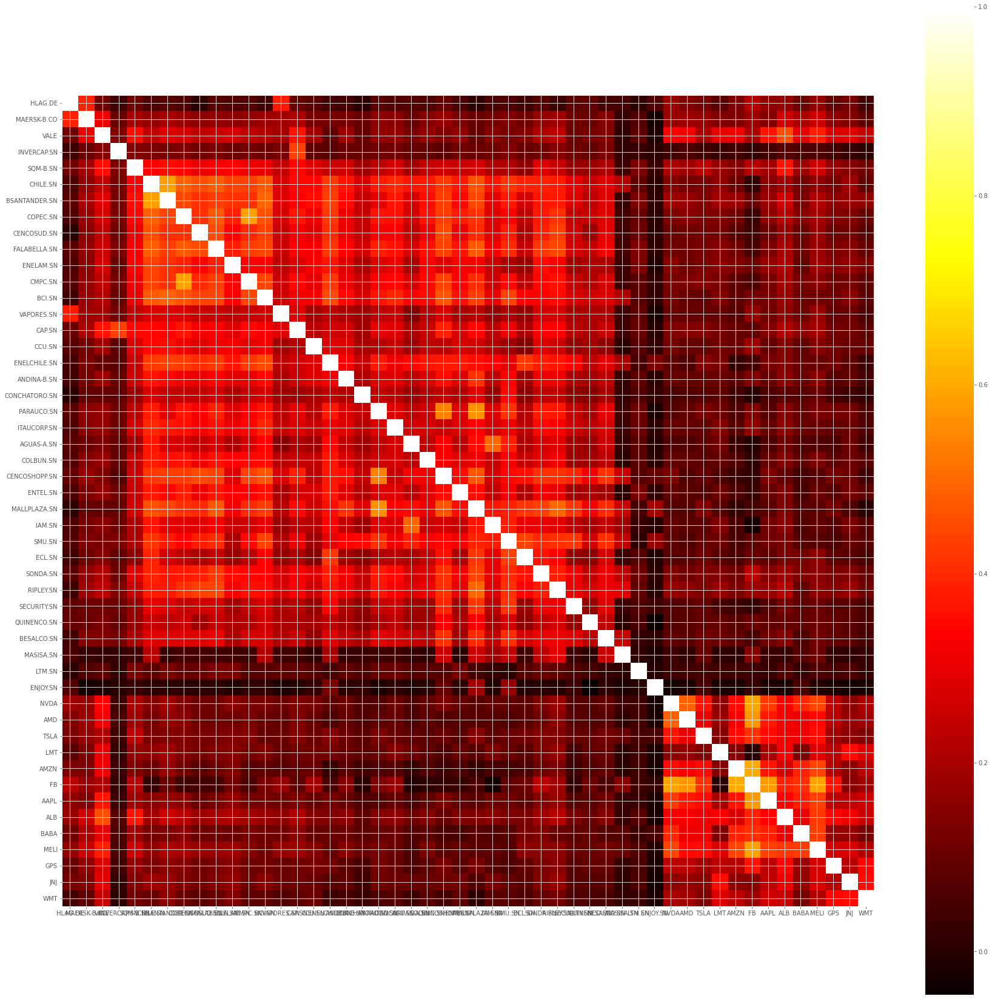

In [35]:
plt.imshow(corr, cmap='hot', interpolation='none')
plt.colorbar()
plt.xticks(range(len(corr)), corr.columns)
plt.yticks(range(len(corr)), corr.columns);

[texto del vínculo](https://)## Stocks mean and Risk calculation
Which stocks are risky and bearing returns

Kurtosis and skewness

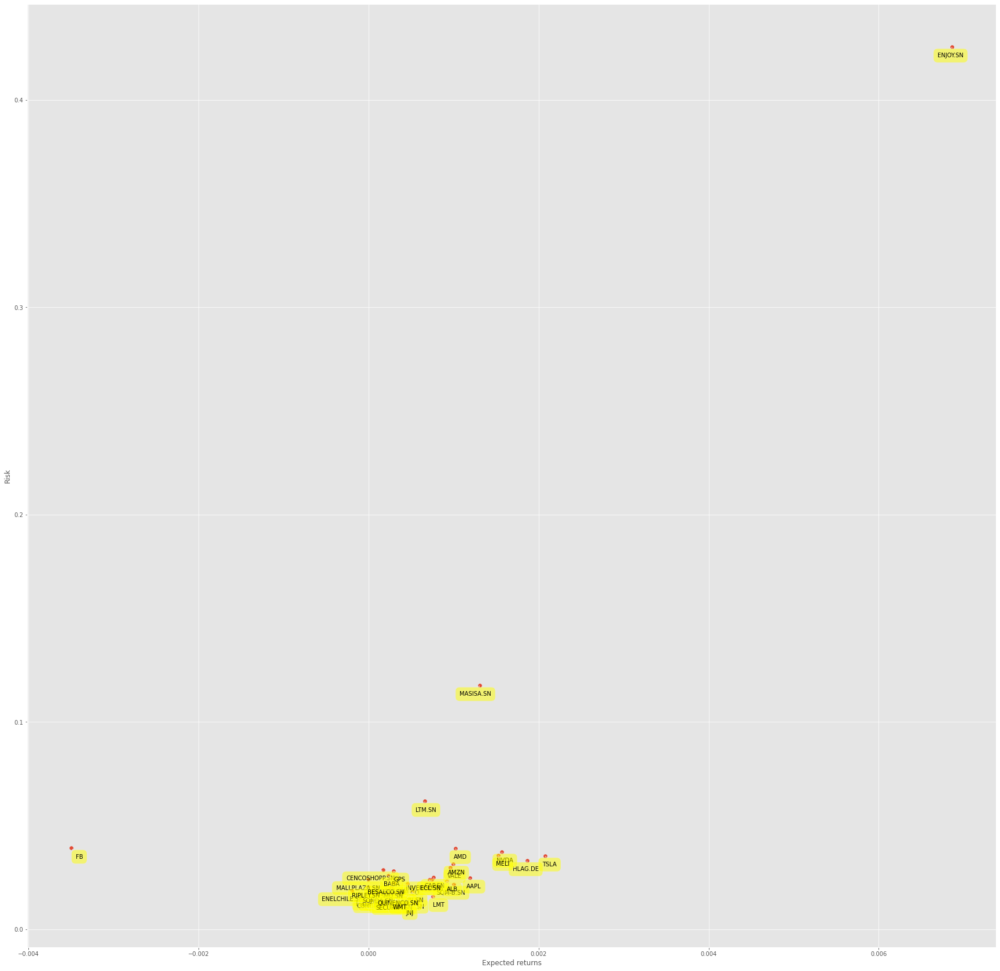

In [36]:
plt.scatter(retscomp.mean(), retscomp.std())
plt.xlabel('Expected returns')
plt.ylabel('Risk')
for label, x, y in zip(retscomp.columns, retscomp.mean(), retscomp.std()):
    plt.annotate(
        label, 
        xy = (x, y), xytext = (20, -20),
        textcoords = 'offset points', ha = 'right', va = 'bottom',
        bbox = dict(boxstyle = 'round,pad=0.7', fc = 'yellow', alpha = 0.5),
        arrowprops = dict(arrowstyle = '->', connectionstyle = 'arc3,rad=0'))

# Predicting the stocks price

To predict the return of the stocks in the next period - Prediction analysis
* Simple Linear Analysis
* Quadratic Linear Analysis (QDA)
* K Nearest Neighbor (KNN)

But first, let us extract the necessary columns first from df:
* Adj Close
* Adj Volume
* HL Percentage
* PCT Change

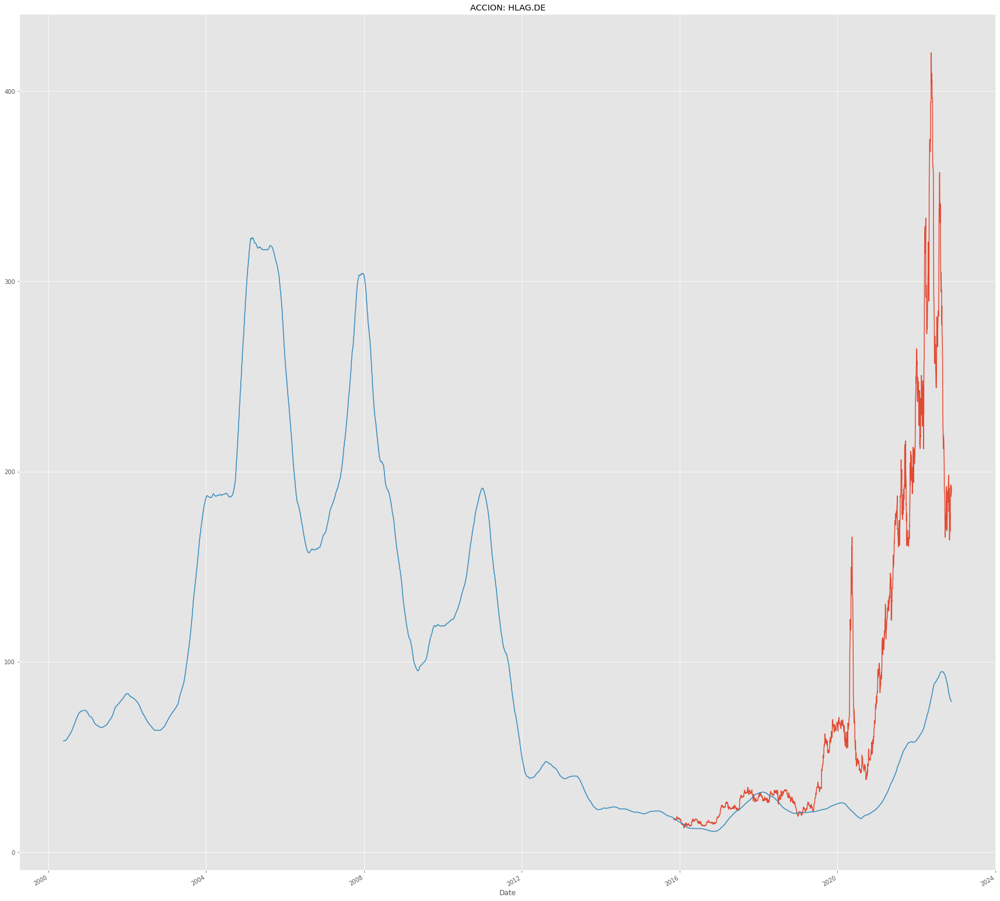

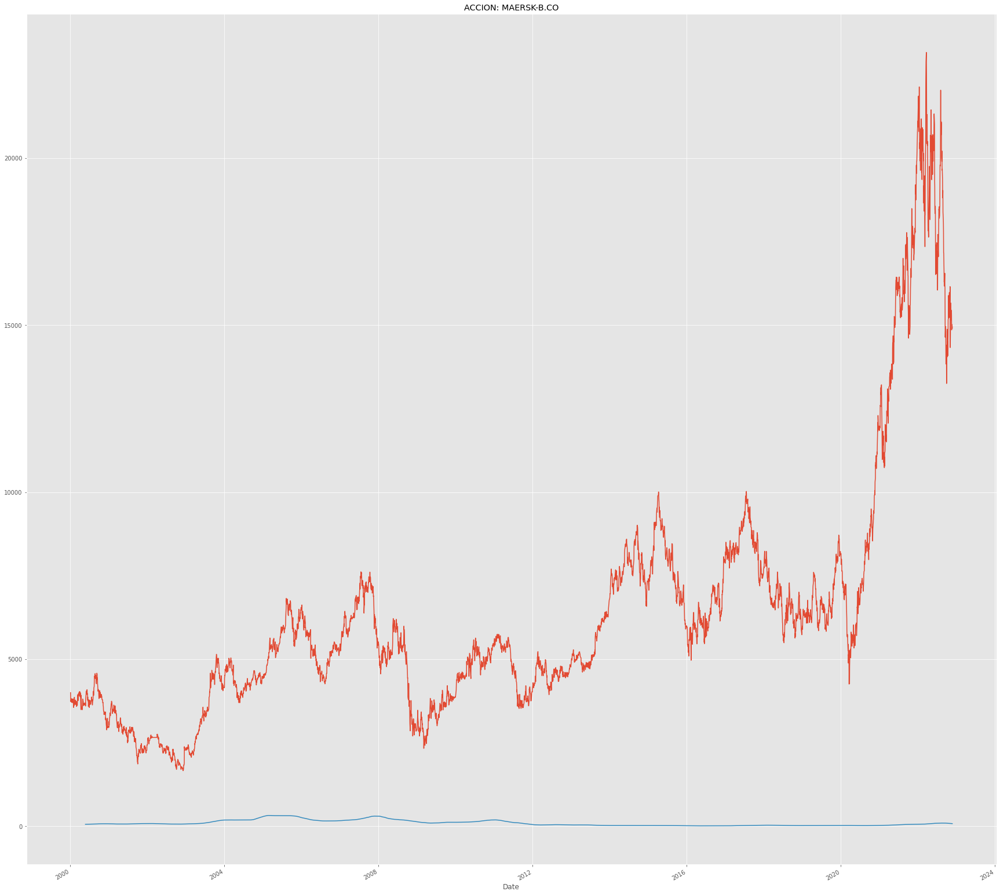

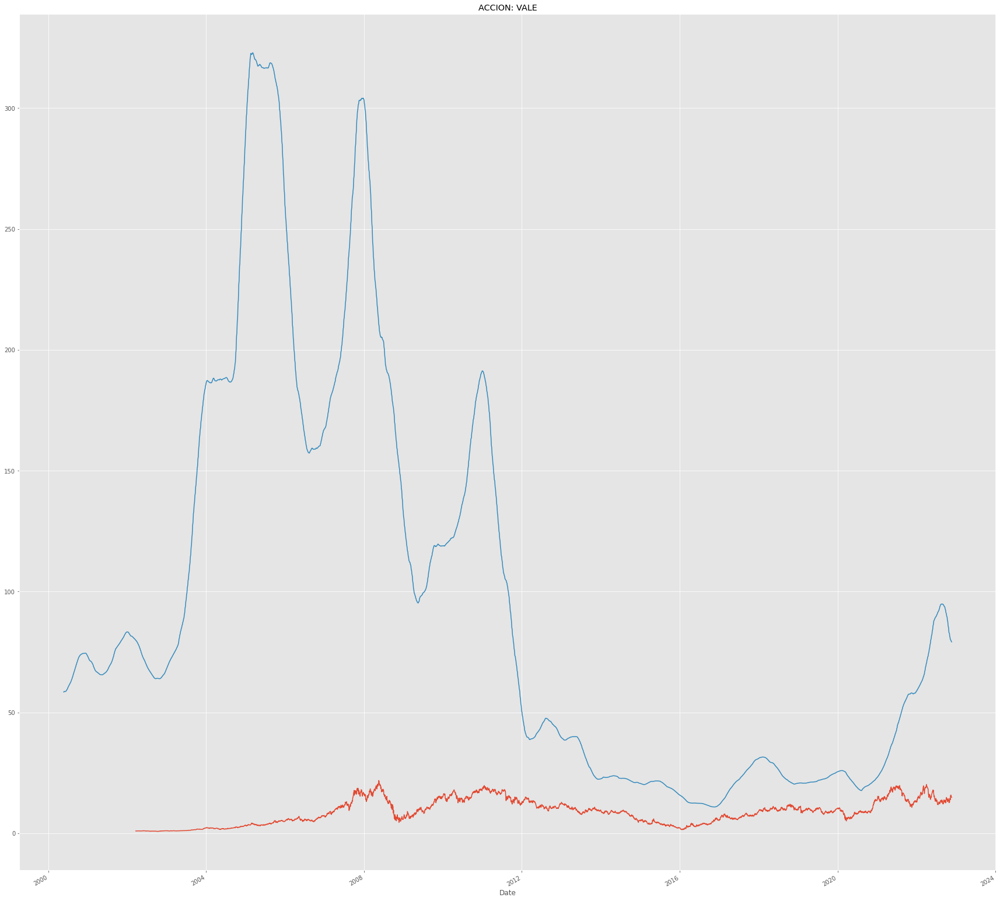

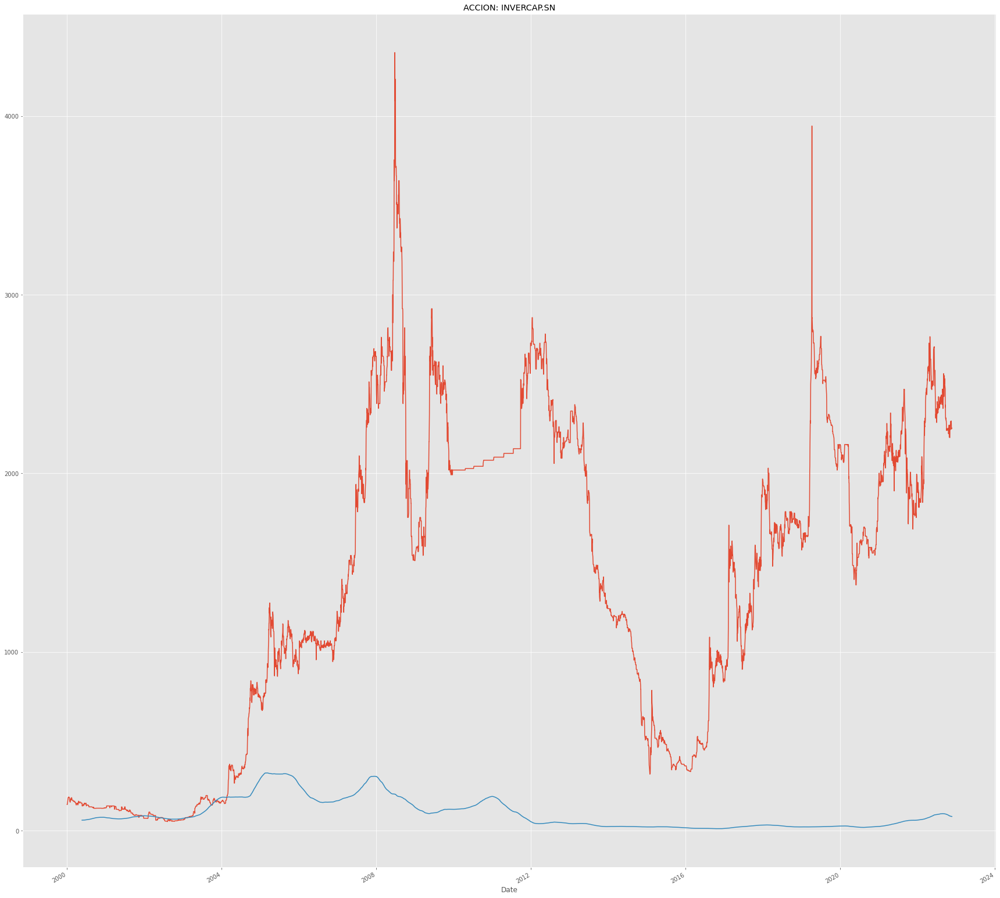

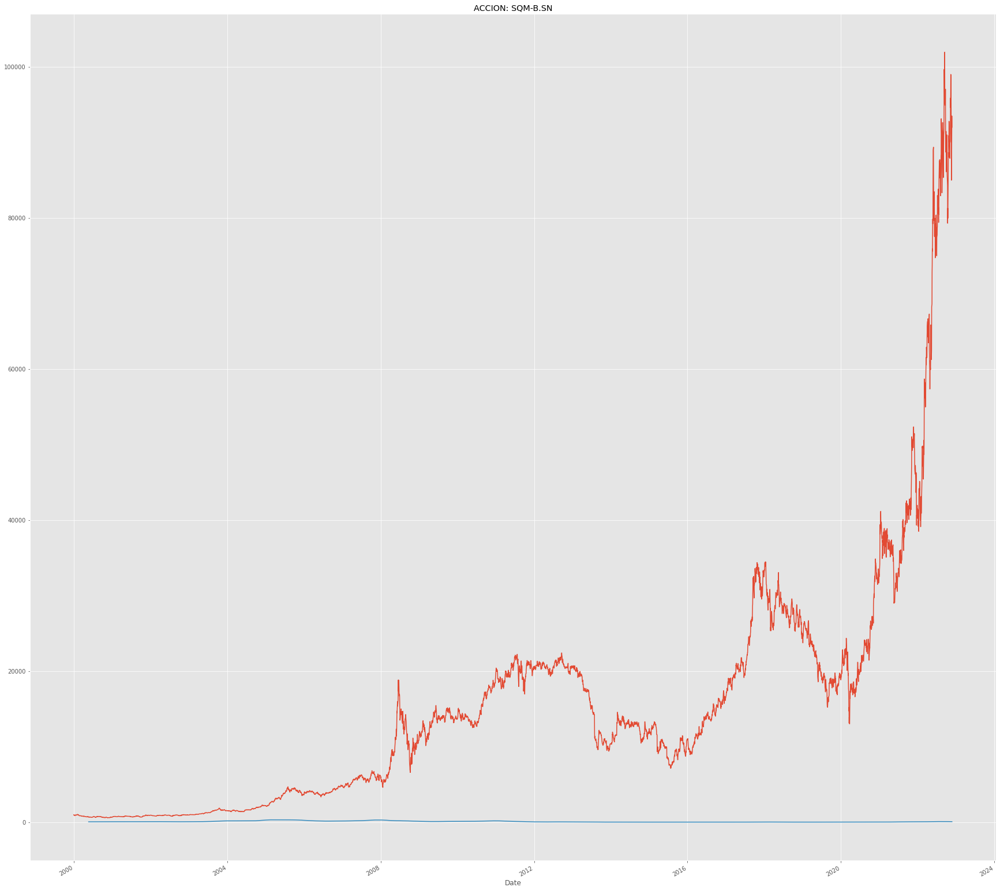

...

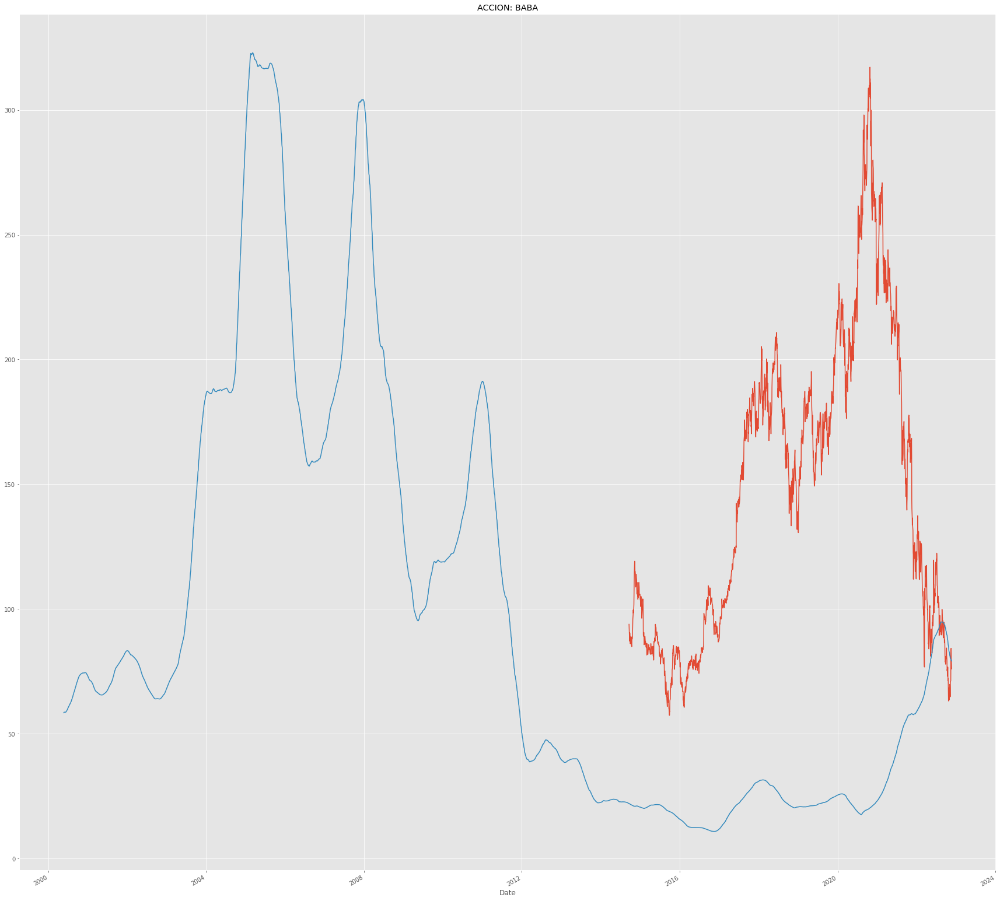

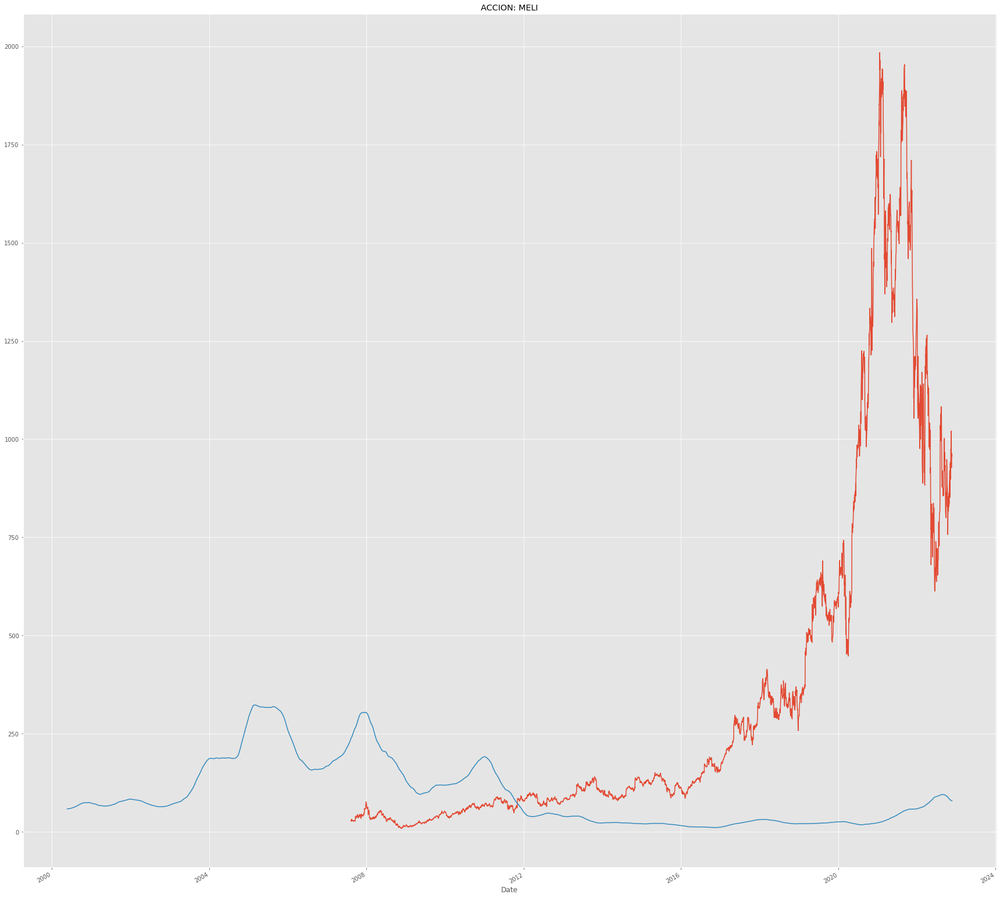

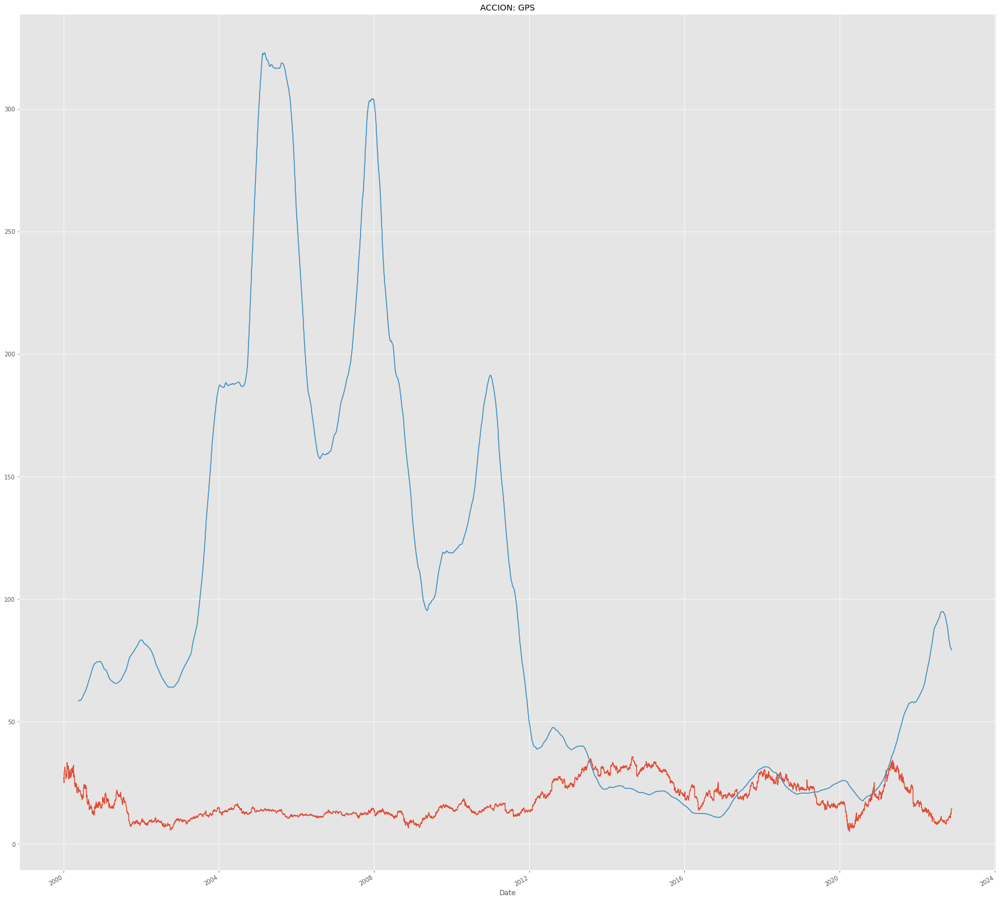

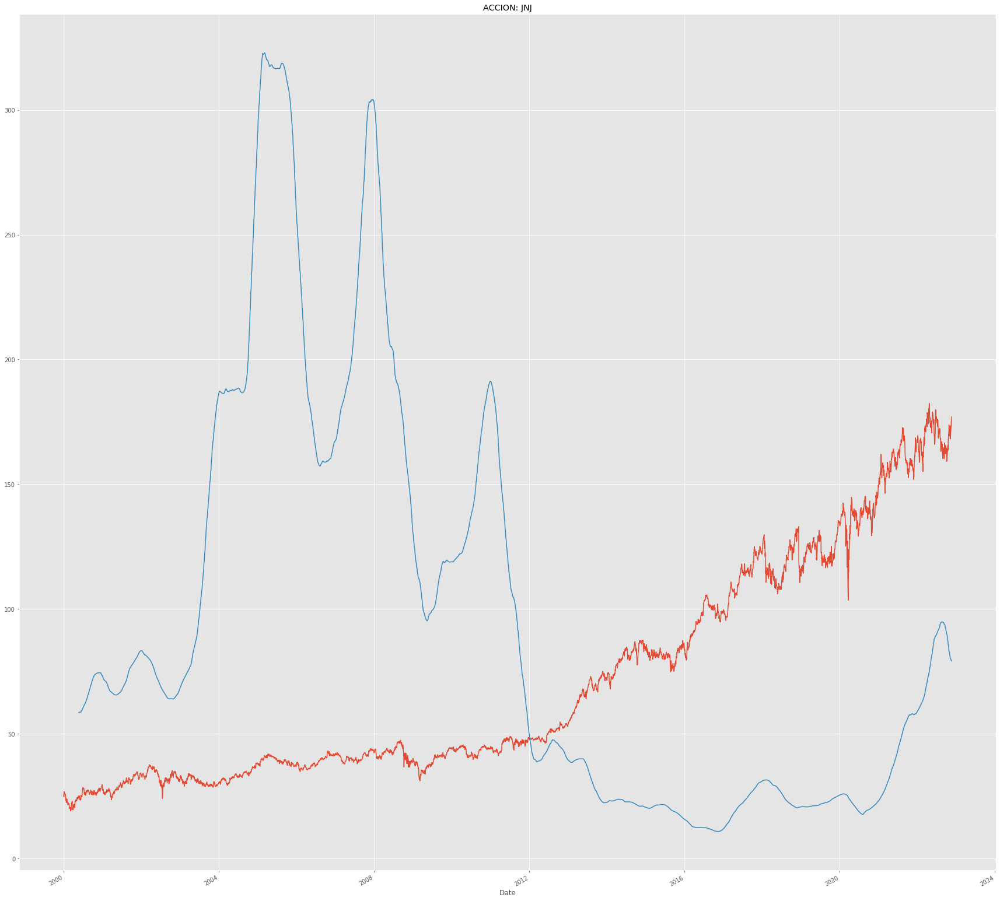

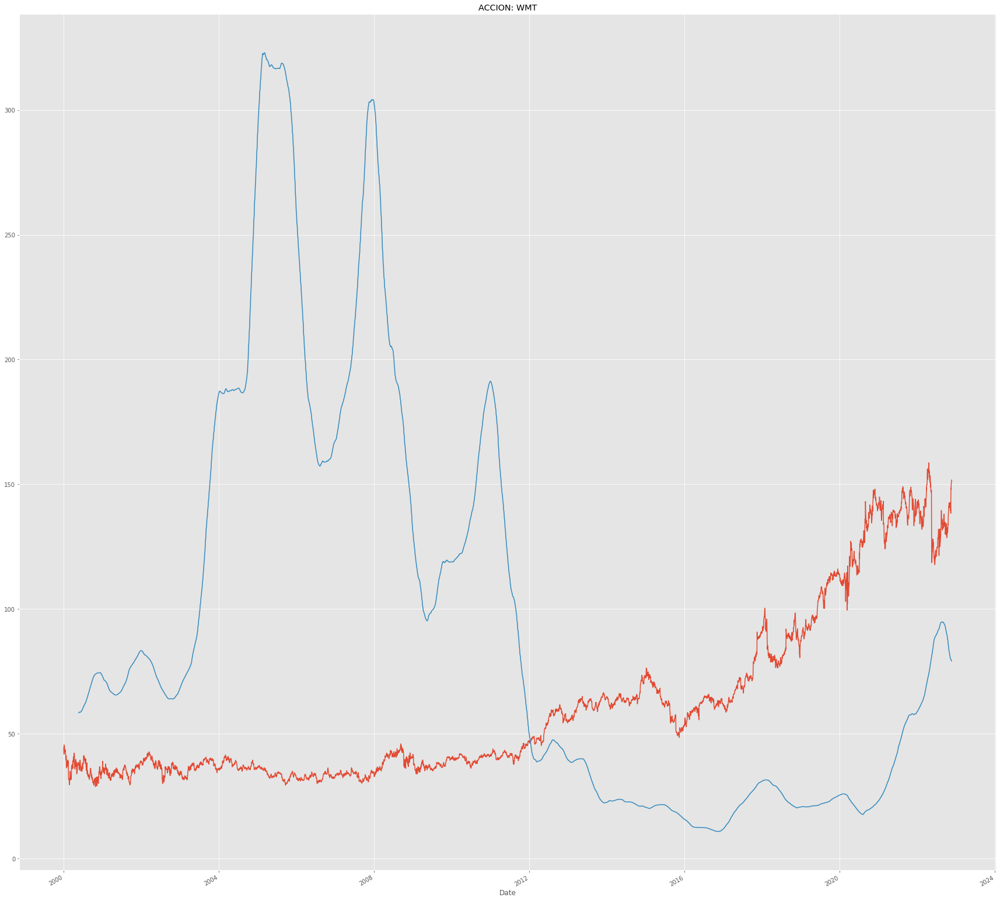

In [37]:
for i in ipsa:
  globals()["close_px_" + str(i).replace(".","")].plot(label=i)
  globals()["mavg" + str(i).replace(".","")].plot(label='mavg_'+i)

  globals()[str(i).replace(".","")].head()
  plt.title("ACCION: "+ str(i))
  plt.show()

In [38]:
for i in ipsa:
  globals()[str('dfreg')+str(i).replace(".","")] = globals()[str(i).replace(".","")].loc[:,['Adj Close','Volume']]
  globals()[str('dfreg')+str(i).replace(".","")]['HL_PCT'] = (df['High'] - df['Low']) / df['Close'] * 100.0
  globals()[str('dfreg')+str(i).replace(".","")]['PCT_change'] = (df['Close'] - df['Open']) / df['Open'] * 100.0
  globals()[str('dfreg')+str(i).replace(".","")].head()

In [39]:
import math
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import preprocessing

for i in ipsa:

  # Drop missing value
  globals()[str('dfreg')+str(i).replace(".","")].fillna(value=-99999, inplace=True)

  globals()[str('dfreg')+str(i).replace(".","")].shape
  # We want to separate 1 percent of the data to forecast
  globals()[str('forecast_out')+str(i).replace(".","")] = int(math.ceil(0.01 * len(globals()[str('dfreg')+str(i).replace(".","")])))

  # Separating the label here, we want to predict the AdjClose
  globals()[str('forecast_col')+str(i).replace(".","")] = 'Adj Close'
  globals()[str('dfreg')+str(i).replace(".","")]['label'] = globals()[str('dfreg')+str(i).replace(".","")][globals()[str('forecast_col')+str(i).replace(".","")]].shift(-globals()[str('forecast_out')+str(i).replace(".","")])
  
  globals()[str('X')+str(i).replace(".","")] = np.array(globals()[str('dfreg')+str(i).replace(".","")].drop(['label'], 1))
  

  # Scale the X so that everyone can have the same distribution for linear regression
  globals()[str('X')+str(i).replace(".","")] = preprocessing.scale(globals()[str('X')+str(i).replace(".","")])

  # Finally We want to find Data Series of late X and early X (train) for model generation and evaluation
  globals()[str('X_lately')+str(i).replace(".","")] =  globals()[str('X')+str(i).replace(".","")][-globals()[str('forecast_out')+str(i).replace(".","")]:]
  globals()[str('X')+str(i).replace(".","")] = globals()[str('X')+str(i).replace(".","")][:-globals()[str('forecast_out')+str(i).replace(".","")]]

  # Separate label and identify it as y
  # Separate label and identify it as y
  globals()[str('y')+str(i).replace(".","")] = np.array( globals()[str('dfreg')+str(i).replace(".","")]['label'])
  globals()[str('y')+str(i).replace(".","")] = globals()[str('y')+str(i).replace(".","")][:-int(globals()[str('forecast_out')+str(i).replace(".","")])]

  print('Dimension of X',globals()[str('X')+str(i).replace(".","")].shape)
  print('Dimension of y',globals()[str('y')+str(i).replace(".","")].shape)
  print("")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
/usr/local/lib/pytho

Dimension of X (1772, 4)
Dimension of y (1772,)

Dimension of X (5734, 4)
Dimension of y (5734,)

Dimension of X (5154, 4)
Dimension of y (5154,)

Dimension of X (5730, 4)
Dimension of y (5730,)

Dimension of X (5742, 4)
Dimension of y (5742,)

Dimension of X (3686, 4)
Dimension of y (3686,)

Dimension of X (5075, 4)
Dimension of y (5075,)

Dimension of X (5712, 4)
Dimension of y (5712,)

Dimension of X (5742, 4)
Dimension of y (5742,)

Dimension of X (5742, 4)
Dimension of y (5742,)

Dimension of X (5740, 4)
Dimension of y (5740,)

Dimension of X (5742, 4)
Dimension of y (5742,)

Dimension of X (3686, 4)
Dimension of y (3686,)

Dimension of X (5730, 4)
Dimension of y (5730,)

Dimension of X (5738, 4)
Dimension of y (5738,)

Dimension of X (5742, 4)
Dimension of y (5742,)

Dimension of X (1622, 4)
Dimension of y (1622,)

Dimension of X (5649, 4)
Dimension of y (5649,)

Dimension of X (5740, 4)
Dimension of y (5740,)

Dimension of X (5742, 4)
Dimension of y (5742,)

Dimension of X (4993

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only


In [40]:
# Separation of training and testing of model by cross validation train test split
for i in ipsa: 
  globals()[str('X_train')+str(i).replace(".","")], globals()[str('X_test')+str(i).replace(".","")], globals()[str('y_train')+str(i).replace(".","")], globals()[str('y_test')+str(i).replace(".","")] = train_test_split(globals()[str('X')+str(i).replace(".","")], globals()[str('y')+str(i).replace(".","")], test_size=0.2)

# Model Generation

* To predict the return of the stocks in the next period - Prediction analysis
    * Simple Linear Analysis
    * Quadratic Linear Analysis (QDA)
    * K Nearest Neighbor (KNN)

## Build the model

In [41]:
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
import datetime


from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

for i in ipsa:

  # Linear regression
  globals()[str('clfreg')+str(i).replace(".","")] = LinearRegression(n_jobs=-1)
  globals()[str('clfreg')+str(i).replace(".","")].fit(globals()[str('X_train')+str(i).replace(".","")], globals()[str('y_train')+str(i).replace(".","")])


  # Quadratic Regression 2
  globals()[str('clfpoly2')+str(i).replace(".","")] = make_pipeline(PolynomialFeatures(2), Ridge())
  globals()[str('clfpoly2')+str(i).replace(".","")].fit(globals()[str('X_train')+str(i).replace(".","")], globals()[str('y_train')+str(i).replace(".","")])

  # Quadratic Regression 3
  globals()[str('clfpoly3')+str(i).replace(".","")] = make_pipeline(PolynomialFeatures(3), Ridge())
  globals()[str('clfpoly3')+str(i).replace(".","")].fit(globals()[str('X_train')+str(i).replace(".","")], globals()[str('y_train')+str(i).replace(".","")])
      
  # KNN Regression
  globals()[str('clfknn')+str(i).replace(".","")] = KNeighborsRegressor(n_neighbors=2)
  globals()[str('clfknn')+str(i).replace(".","")].fit(globals()[str('X_train')+str(i).replace(".","")], globals()[str('y_train')+str(i).replace(".","")])

## Test the model

In [42]:
for i in ipsa:

  globals()[str('confidencereg')+str(i).replace(".","")] = globals()[str('clfreg')+str(i).replace(".","")].score(globals()[str('X_test')+str(i).replace(".","")], globals()[str('y_test')+str(i).replace(".","")])
  globals()[str('confidencepoly2')+str(i).replace(".","")] = globals()[str('clfpoly2')+str(i).replace(".","")].score(globals()[str('X_test')+str(i).replace(".","")], globals()[str('y_test')+str(i).replace(".","")])
  globals()[str('confidencepoly3')+str(i).replace(".","")] = globals()[str('clfpoly3')+str(i).replace(".","")].score(globals()[str('X_test')+str(i).replace(".","")], globals()[str('y_test')+str(i).replace(".","")])
  globals()[str('confidenceknn')+str(i).replace(".","")] = globals()[str('clfknn')+str(i).replace(".","")].score(globals()[str('X_test')+str(i).replace(".","")], globals()[str('y_test')+str(i).replace(".","")])

  print("The linear regression confidence is ",globals()[str('confidencereg')+str(i).replace(".","")])
  print("The quadratic regression 2 confidence is ",globals()[str('confidencepoly2')+str(i).replace(".","")])
  print("The quadratic regression 3 confidence is ",globals()[str('confidencepoly3')+str(i).replace(".","")])
  print("The knn regression confidence is ",globals()[str('confidenceknn')+str(i).replace(".","")])
  print("")

The linear regression confidence is  0.9005424345900787
The quadratic regression 2 confidence is  0.9201146674375619
The quadratic regression 3 confidence is  0.9259413511480442
The knn regression confidence is  0.9239639245816353

The linear regression confidence is  0.9030037944315746
The quadratic regression 2 confidence is  0.9048520536146146
The quadratic regression 3 confidence is  0.915711834132611
The knn regression confidence is  0.8930878982893251

The linear regression confidence is  0.8624084276662691
The quadratic regression 2 confidence is  0.8717164082015378
The quadratic regression 3 confidence is  0.8741611563389164
The knn regression confidence is  0.8308890038377674

The linear regression confidence is  0.8729569703058057
The quadratic regression 2 confidence is  0.8935269515732699
The quadratic regression 3 confidence is  0.8885790918910982
The knn regression confidence is  0.8661062393288719

The linear regression confidence is  0.9431171397334698
The quadratic reg

This means that the linear regression holds the most accuracy of it as being linear and justify the trend of stocks as being linear most of the times. 

However this does not mean we can just put stocks in it. There are still many issues to consider, especially with different companies that have different price trajectories over time. Google really is very linear: Up and to the right. Many companies aren't, so keep this in mind. 

We need to plot out the graph to make the most sense of it 

In [43]:
# Printing the forecast

for i in ipsa:
  globals()[str('forecast_set')+str(i).replace(".","")] = globals()[str('clfreg')+str(i).replace(".","")].predict(globals()[str('X_lately')+str(i).replace(".","")])
  globals()[str('dfreg')+str(i).replace(".","")]['Forecast'] = np.nan
  print(globals()[str('forecast_set')+str(i).replace(".","")], globals()[str('confidencereg')+str(i).replace(".","")], globals()[str('forecast_out')+str(i).replace(".","")])
  print("")

[178.95781763 178.07139144 186.04781804 168.74293909 166.27205253
 166.1619458  173.57706216 178.49351021 168.60009538 176.27293765
 185.32869365 192.60188172 189.99834981 186.50445538 188.09417597
 186.21467576 189.43781506 193.09706667] 0.9005424345900787 18

[17174.05244106 16599.79006669 16301.23918226 16404.51329165
 16131.69103521 16210.90181222 16485.85706701 16181.86768119
 16075.15334881 15517.07283526 14729.98753112 14930.23739712
 14789.03857785 14842.7534892  14363.358029   13941.22060489
 13977.28405616 14453.45360801 14059.30451293 13313.32395528
 13921.98114853 14291.43806733 14948.06702335 14351.1257403
 14393.05130229 14131.39948042 14493.96293736 14099.94036479
 14525.37596333 14732.688474   15238.61723727 15200.9280643
 15883.56826645 15171.20030295 15749.24013806 15752.72585081
 15833.75692802 15933.15119212 15903.10010437 15618.04837727
 15190.08539532 15721.27261085 16095.46628398 15228.04897799
 14380.03403419 14585.76510423 15305.16992033 15636.7562787
 15124.43

# Plotting the Prediction

In [44]:
for i in ipsa:
  globals()[str('last_date')+str(i).replace(".","")] = globals()[str('dfreg')+str(i).replace(".","")].iloc[-1].name
  globals()[str('last_unix')+str(i).replace(".","")] = globals()[str('last_date')+str(i).replace(".","")]
  globals()[str('next_unix')+str(i).replace(".","")] = globals()[str('last_unix')+str(i).replace(".","")] + datetime.timedelta(days=1)

  for x in globals()[str('forecast_set')+str(i).replace(".","")]:
      globals()[str('next_date')+str(i).replace(".","")] = globals()[str('next_unix')+str(i).replace(".","")]
      globals()[str('next_unix')+str(i).replace(".","")] += datetime.timedelta(days=1)
      globals()[str('dfreg')+str(i).replace(".","")].loc[globals()[str('next_date')+str(i).replace(".","")]] = [np.nan for _ in range(len(globals()[str('dfreg')+str(i).replace(".","")].columns)-1)]+[x]

HLAG.DE
Date
2022-11-07           NaN
2022-11-08           NaN
2022-11-09           NaN
2022-11-10           NaN
2022-11-11           NaN
2022-11-14           NaN
2022-11-15           NaN
2022-11-16           NaN
2022-11-17           NaN
2022-11-18           NaN
2022-11-21           NaN
2022-11-22           NaN
2022-11-23    178.957818
2022-11-24    178.071391
2022-11-25    186.047818
2022-11-26    168.742939
2022-11-27    166.272053
2022-11-28    166.161946
2022-11-29    173.577062
2022-11-30    178.493510
2022-12-01    168.600095
2022-12-02    176.272938
2022-12-03    185.328694
2022-12-04    192.601882
2022-12-05    189.998350
2022-12-06    186.504455
2022-12-07    188.094176
2022-12-08    186.214676
2022-12-09    189.437815
2022-12-10    193.097067
Name: Forecast, dtype: float64
----------------------


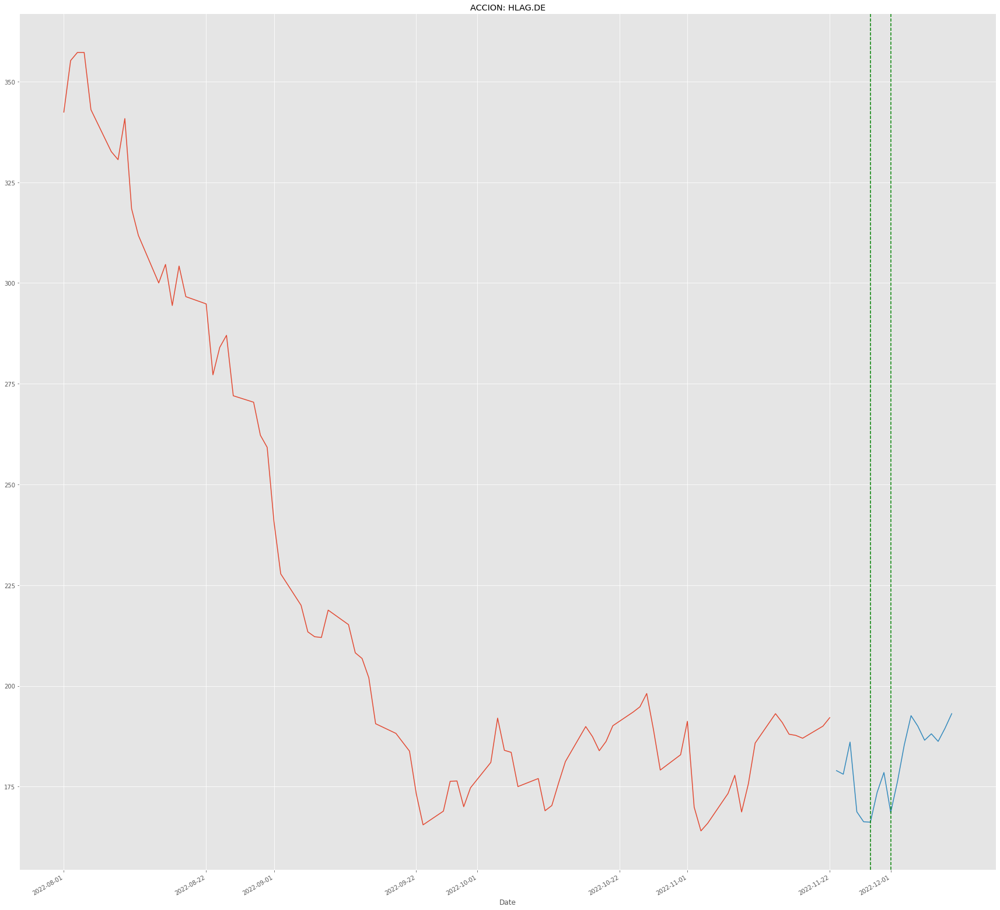


MAERSK-B.CO
Date
2022-12-21    14525.375963
2022-12-22    14732.688474
2022-12-23    15238.617237
2022-12-24    15200.928064
2022-12-25    15883.568266
2022-12-26    15171.200303
2022-12-27    15749.240138
2022-12-28    15752.725851
2022-12-29    15833.756928
2022-12-30    15933.151192
2022-12-31    15903.100104
2023-01-01    15618.048377
2023-01-02    15190.085395
2023-01-03    15721.272611
2023-01-04    16095.466284
2023-01-05    15228.048978
2023-01-06    14380.034034
2023-01-07    14585.765104
2023-01-08    15305.169920
2023-01-09    15636.756279
2023-01-10    15124.435793
2023-01-11    15413.727825
2023-01-12    15431.491169
2023-01-13    15386.516208
2023-01-14    15275.769458
2023-01-15    14802.094088
2023-01-16    14947.803112
2023-01-17    14982.637516
2023-01-18    14856.050622
2023-01-19    14936.102815
Name: Forecast, dtype: float64
----------------------


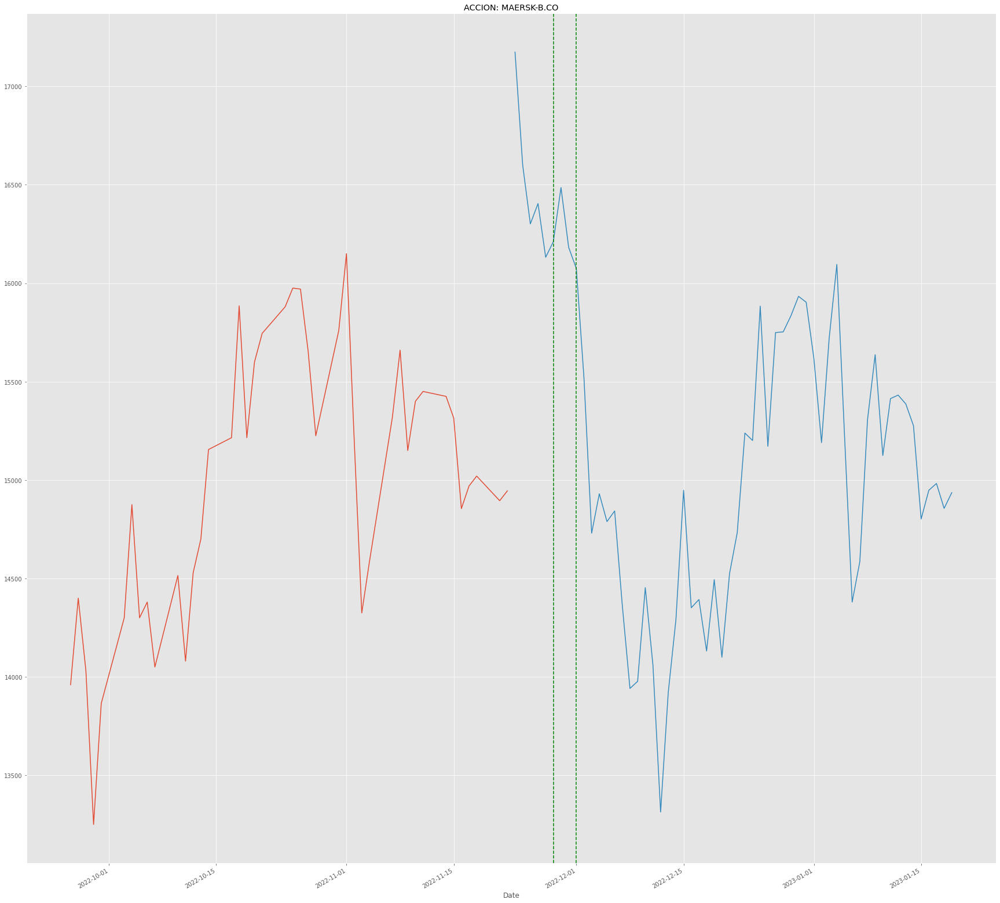


VALE
Date
2022-12-16    13.469949
2022-12-17    13.784333
2022-12-18    13.224570
2022-12-19    13.366774
2022-12-20    13.692886
2022-12-21    13.403805
2022-12-22    14.079178
2022-12-23    14.659655
2022-12-24    13.954709
2022-12-25    13.883328
2022-12-26    14.025963
2022-12-27    13.752728
2022-12-28    13.188246
2022-12-29    13.711835
2022-12-30    14.014545
2022-12-31    12.945558
2023-01-01    13.149122
2023-01-02    14.936266
2023-01-03    13.707760
2023-01-04    14.352134
2023-01-05    13.821329
2023-01-06    13.888138
2023-01-07    15.603812
2023-01-08    15.472908
2023-01-09    15.312797
2023-01-10    14.861581
2023-01-11    14.916356
2023-01-12    14.862217
2023-01-13    14.553633
2023-01-14    14.439361
Name: Forecast, dtype: float64
----------------------


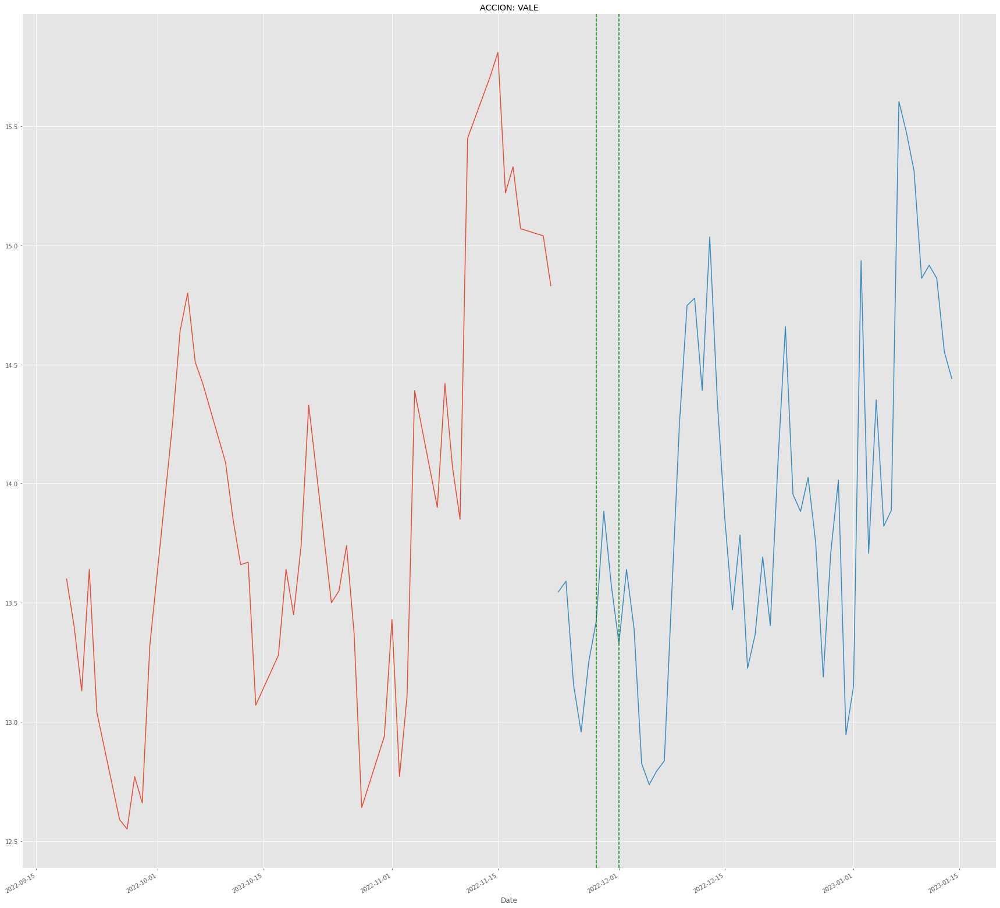


INVERCAP.SN
Date
2022-12-20    2209.253827
2022-12-21    2200.210008
2022-12-22    2207.461271
2022-12-23    2249.874008
2022-12-24    2201.932144
2022-12-25    2194.440447
2022-12-26    2211.672459
2022-12-27    2209.682653
2022-12-28    2213.112841
2022-12-29    2196.479556
2022-12-30    2186.539412
2022-12-31    2214.005794
2023-01-01    2212.371490
2023-01-02    2232.220215
2023-01-03    2199.929894
2023-01-04    2166.994605
2023-01-05    2165.282434
2023-01-06    2160.281668
2023-01-07    2231.407699
2023-01-08    2209.467337
2023-01-09    2206.694735
2023-01-10    2240.434702
2023-01-11    2248.300574
2023-01-12    2248.065174
2023-01-13    2251.902352
2023-01-14    2252.193060
2023-01-15    2256.324230
2023-01-16    2231.916597
2023-01-17    2210.906215
2023-01-18    2216.338044
Name: Forecast, dtype: float64
----------------------


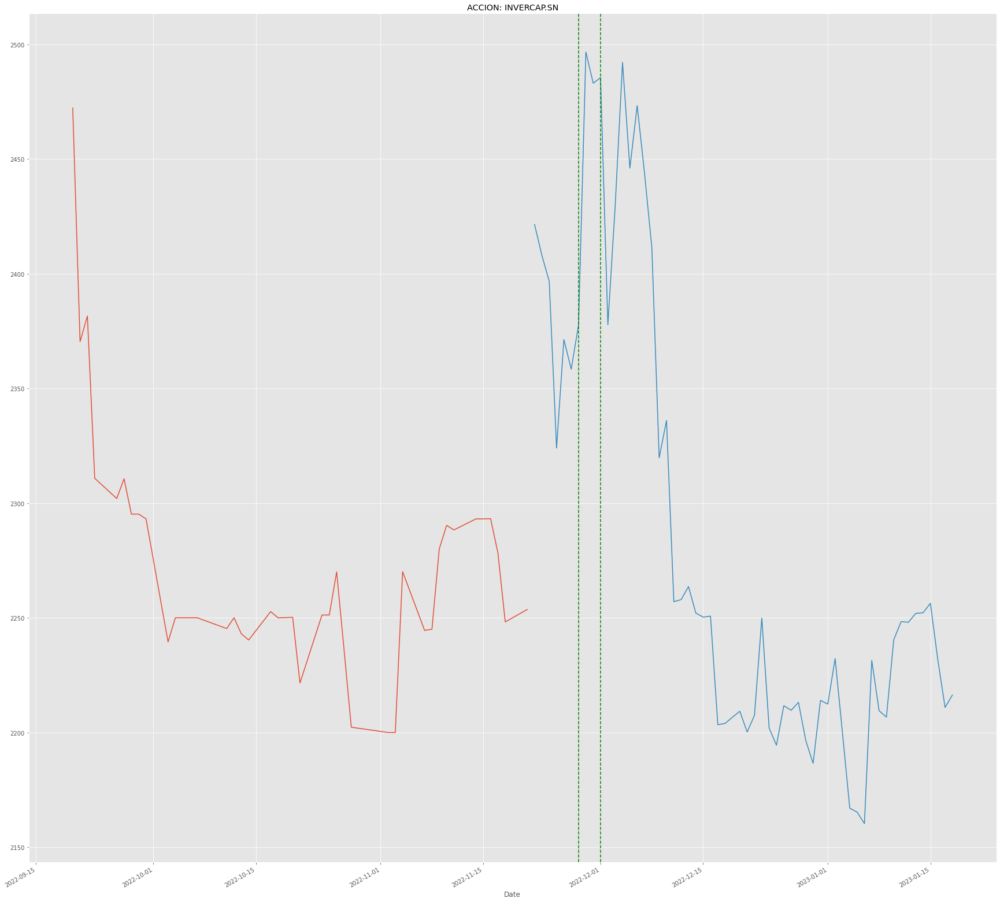


SQM-B.SN
Date
2022-12-21     94284.198279
2022-12-22     92654.052847
2022-12-23     86750.063508
2022-12-24     89610.259022
2022-12-25     88475.904941
2022-12-26     94078.706515
2022-12-27     95554.587389
2022-12-28     96751.387726
2022-12-29     99113.448164
2022-12-30    100124.792600
2022-12-31     98446.385012
2023-01-01    101517.179877
2023-01-02    100789.118450
2023-01-03     99893.151537
2023-01-04     98215.451212
2023-01-05     96085.962417
2023-01-06     99247.732321
2023-01-07     98429.177414
2023-01-08     99096.072757
2023-01-09    105066.925716
2023-01-10    103388.132778
2023-01-11    105556.842871
2023-01-12    108392.943002
2023-01-13    104229.399423
2023-01-14     99891.353198
2023-01-15     99109.070575
2023-01-16     92927.445632
2023-01-17     93255.041164
2023-01-18    102212.059328
2023-01-19    100802.017661
Name: Forecast, dtype: float64
----------------------


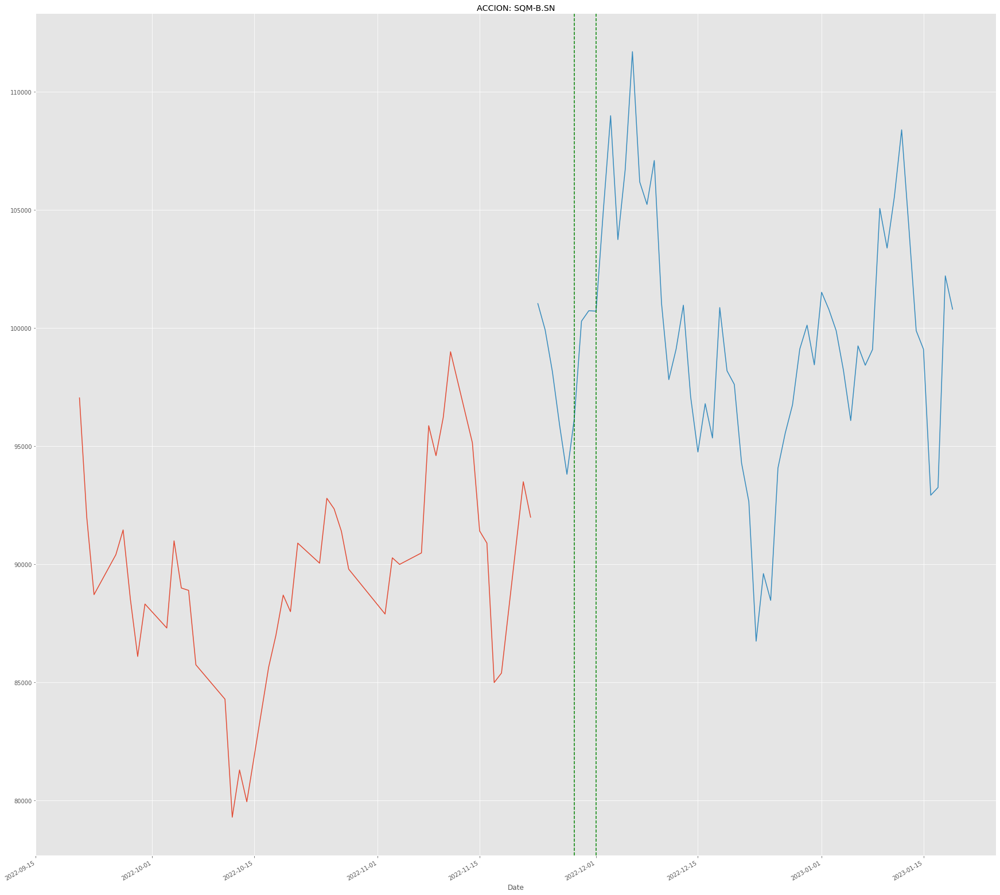


CHILE.SN
Date
2022-12-01    85.424693
2022-12-02    85.774303
2022-12-03    86.847865
2022-12-04    87.586903
2022-12-05    88.637562
2022-12-06    88.924452
2022-12-07    88.337920
2022-12-08    86.777785
2022-12-09    87.505738
2022-12-10    88.060923
2022-12-11    87.105904
2022-12-12    86.816134
2022-12-13    85.989648
2022-12-14    86.312735
2022-12-15    86.609727
2022-12-16    88.140603
2022-12-17    87.100807
2022-12-18    87.500659
2022-12-19    87.345081
2022-12-20    87.342834
2022-12-21    86.566608
2022-12-22    85.370179
2022-12-23    84.860401
2022-12-24    84.848442
2022-12-25    84.239640
2022-12-26    84.698836
2022-12-27    85.295340
2022-12-28    85.081594
2022-12-29    85.341587
2022-12-30    85.419679
Name: Forecast, dtype: float64
----------------------


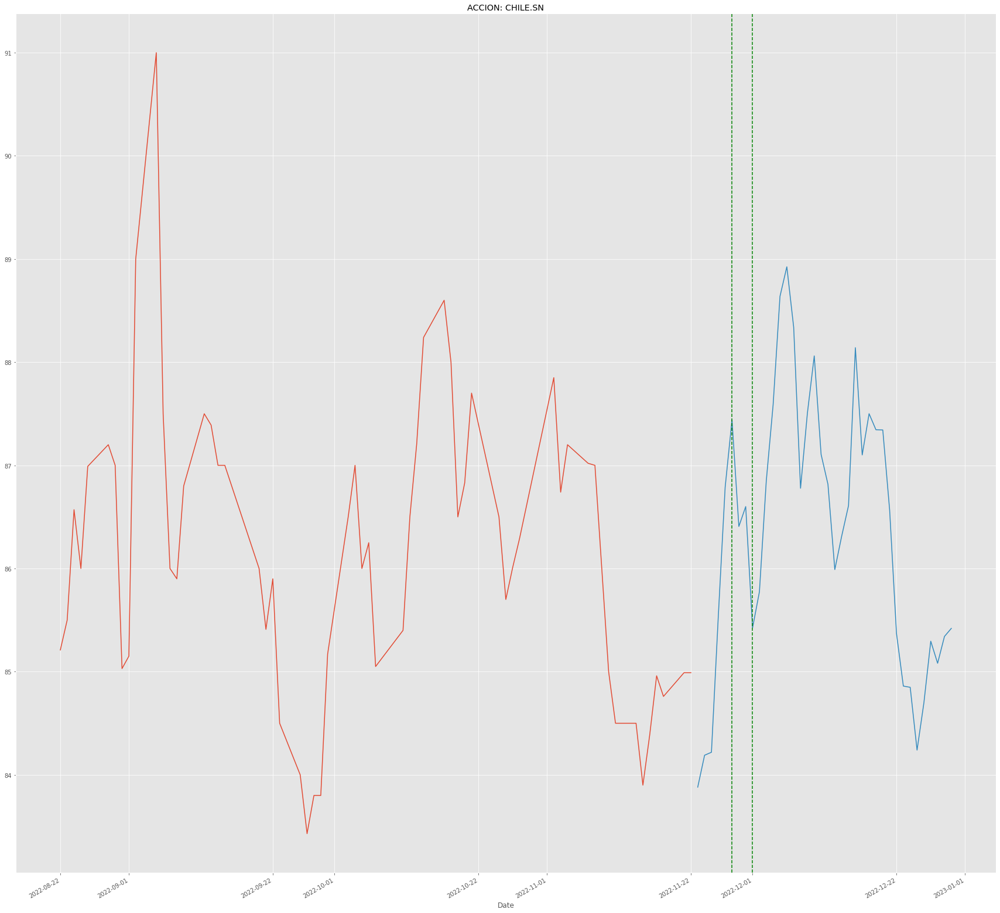


BSANTANDER.SN
Date
2022-12-15    33.297824
2022-12-16    33.054444
2022-12-17    33.462231
2022-12-18    33.516634
2022-12-19    33.112382
2022-12-20    34.539912
2022-12-21    34.596302
2022-12-22    33.526965
2022-12-23    33.345202
2022-12-24    33.740680
2022-12-25    33.622764
2022-12-26    34.073453
2022-12-27    33.892359
2022-12-28    34.226712
2022-12-29    33.695534
2022-12-30    33.591593
2022-12-31    33.203359
2023-01-01    33.221436
2023-01-02    33.603632
2023-01-03    34.642672
2023-01-04    33.799168
2023-01-05    33.810988
2023-01-06    33.839699
2023-01-07    33.718955
2023-01-08    33.279637
2023-01-09    32.967527
2023-01-10    32.967574
2023-01-11    33.612431
2023-01-12    33.925740
2023-01-13    34.226625
Name: Forecast, dtype: float64
----------------------


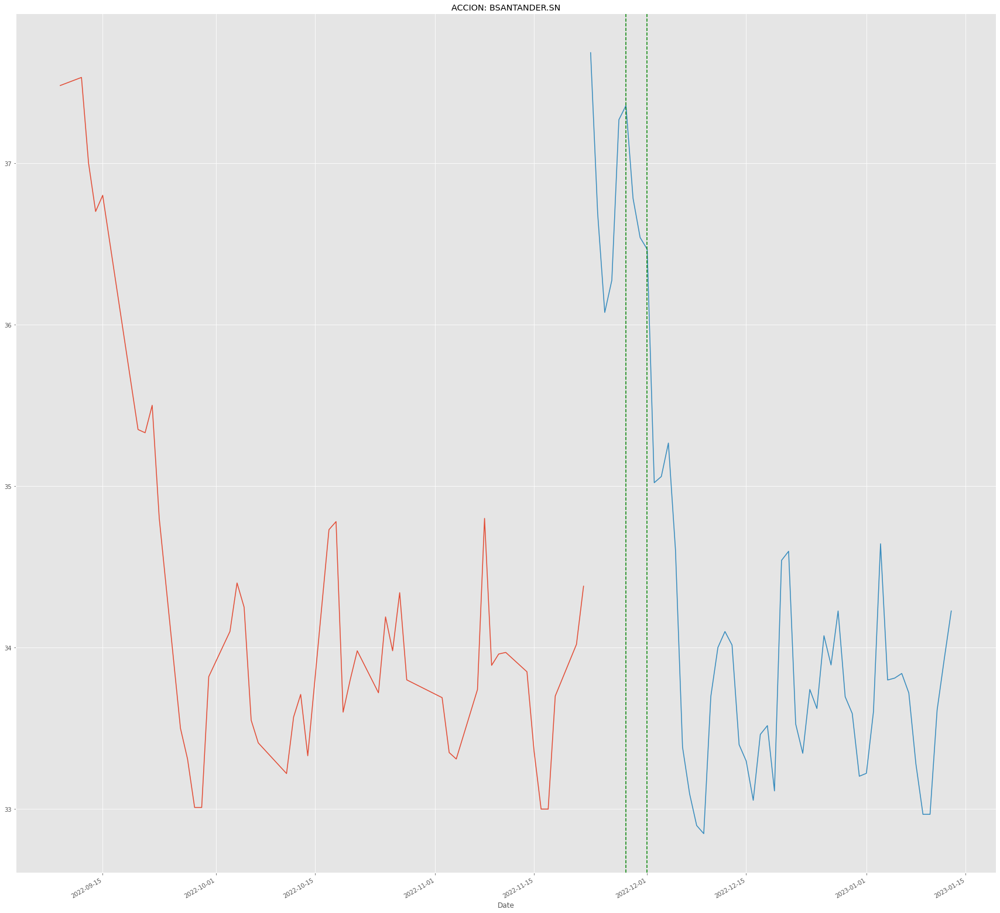


COPEC.SN
Date
2022-12-21    6232.415045
2022-12-22    6050.655886
2022-12-23    6082.996016
2022-12-24    6128.408791
2022-12-25    6094.790753
2022-12-26    6319.586739
2022-12-27    6189.505061
2022-12-28    6196.521772
2022-12-29    6434.392727
2022-12-30    6269.212291
2022-12-31    6183.880170
2023-01-01    6388.987219
2023-01-02    6385.162020
2023-01-03    6560.771421
2023-01-04    6486.726703
2023-01-05    6450.938913
2023-01-06    6339.072361
2023-01-07    6478.520867
2023-01-08    6627.279608
2023-01-09    6841.119024
2023-01-10    6814.537239
2023-01-11    6675.332789
2023-01-12    6555.285256
2023-01-13    6535.646332
2023-01-14    6380.831838
2023-01-15    6357.028781
2023-01-16    6385.676961
2023-01-17    6326.206633
2023-01-18    6341.002028
2023-01-19    6265.434764
Name: Forecast, dtype: float64
----------------------


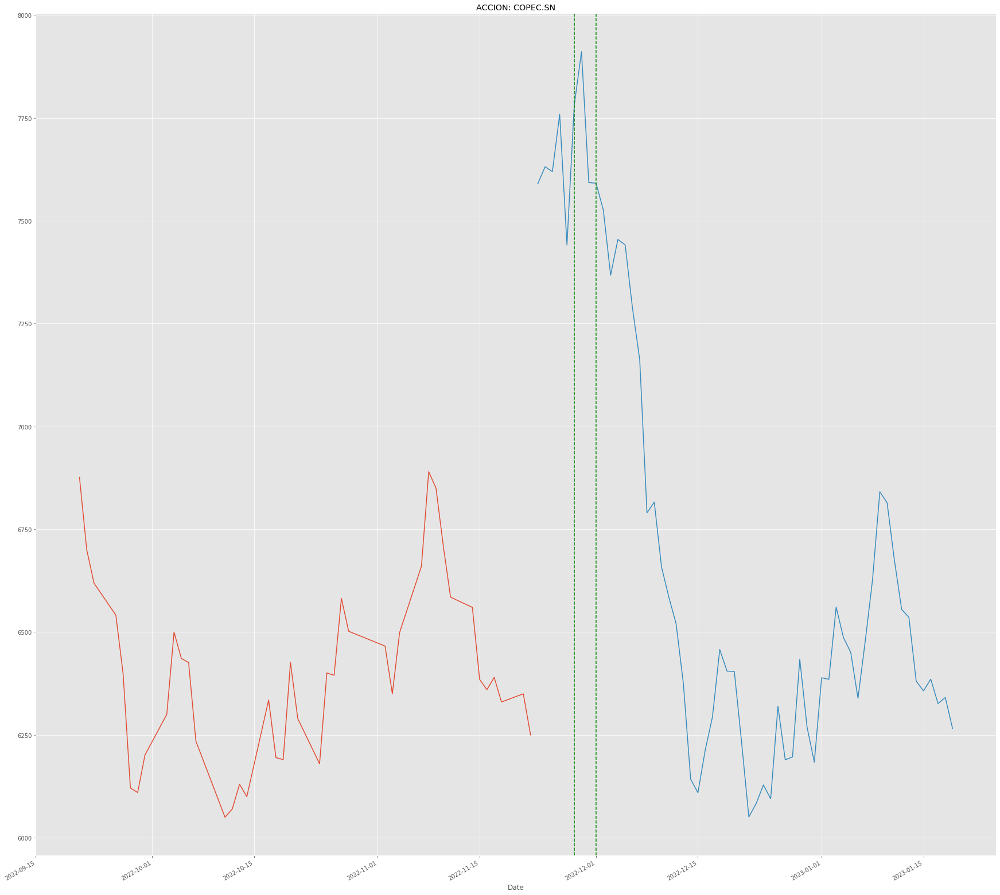


CENCOSUD.SN
Date
2022-12-21    1254.505396
2022-12-22    1202.034616
2022-12-23    1191.521823
2022-12-24    1204.930059
2022-12-25    1214.593075
2022-12-26    1209.825538
2022-12-27    1209.644249
2022-12-28    1190.001625
2022-12-29    1239.908938
2022-12-30    1211.462708
2022-12-31    1212.443928
2023-01-01    1237.286423
2023-01-02    1257.329798
2023-01-03    1259.706124
2023-01-04    1270.583423
2023-01-05    1298.221142
2023-01-06    1297.720748
2023-01-07    1327.555607
2023-01-08    1355.549919
2023-01-09    1364.651614
2023-01-10    1336.680699
2023-01-11    1314.746537
2023-01-12    1300.393894
2023-01-13    1286.846170
2023-01-14    1289.387204
2023-01-15    1294.956316
2023-01-16    1299.472975
2023-01-17    1282.659808
2023-01-18    1299.242491
2023-01-19    1315.388961
Name: Forecast, dtype: float64
----------------------


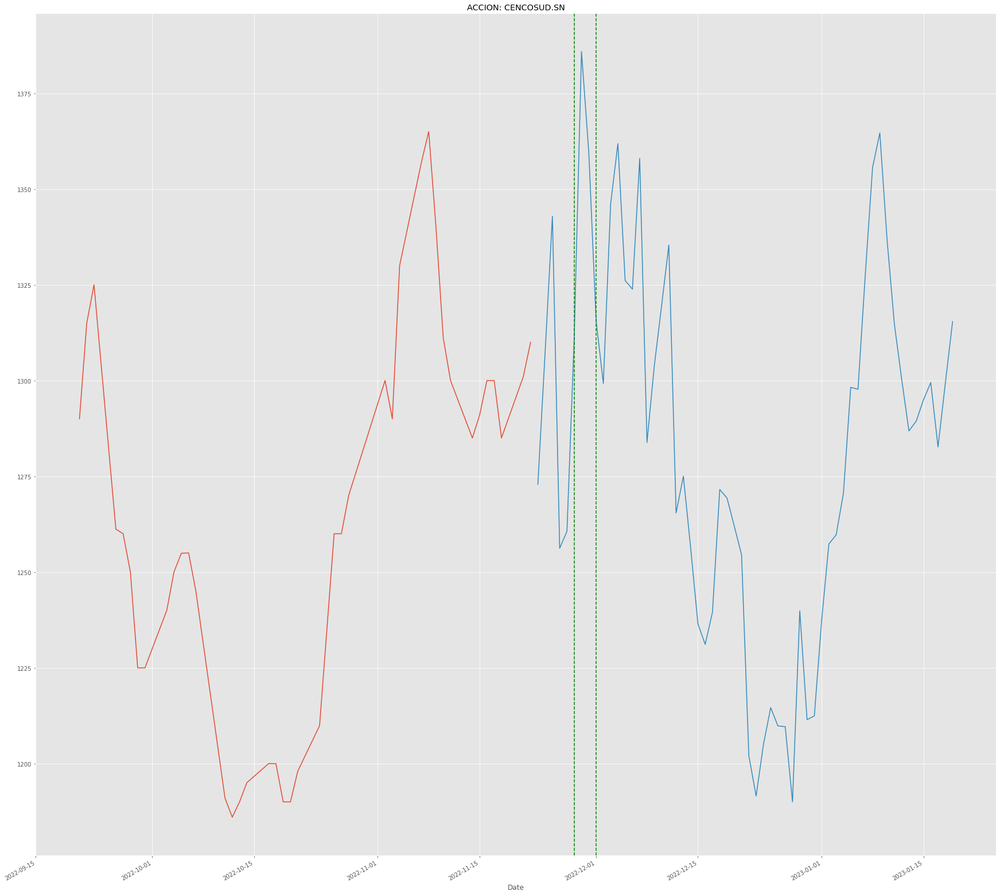


FALABELLA.SN
Date
2022-12-21    1787.756609
2022-12-22    1822.643349
2022-12-23    1815.495556
2022-12-24    1795.856312
2022-12-25    1844.006916
2022-12-26    1857.588584
2022-12-27    1858.469131
2022-12-28    1830.439504
2022-12-29    1780.977608
2022-12-30    1775.791016
2022-12-31    1785.273969
2023-01-01    1817.967344
2023-01-02    1839.426464
2023-01-03    1865.832178
2023-01-04    1881.112346
2023-01-05    1892.619108
2023-01-06    1881.165068
2023-01-07    1885.557644
2023-01-08    1888.185025
2023-01-09    1869.345475
2023-01-10    1829.665281
2023-01-11    1789.010330
2023-01-12    1776.486219
2023-01-13    1724.210427
2023-01-14    1712.319035
2023-01-15    1691.048497
2023-01-16    1651.717554
2023-01-17    1645.322273
2023-01-18    1638.719135
2023-01-19    1610.565979
Name: Forecast, dtype: float64
----------------------


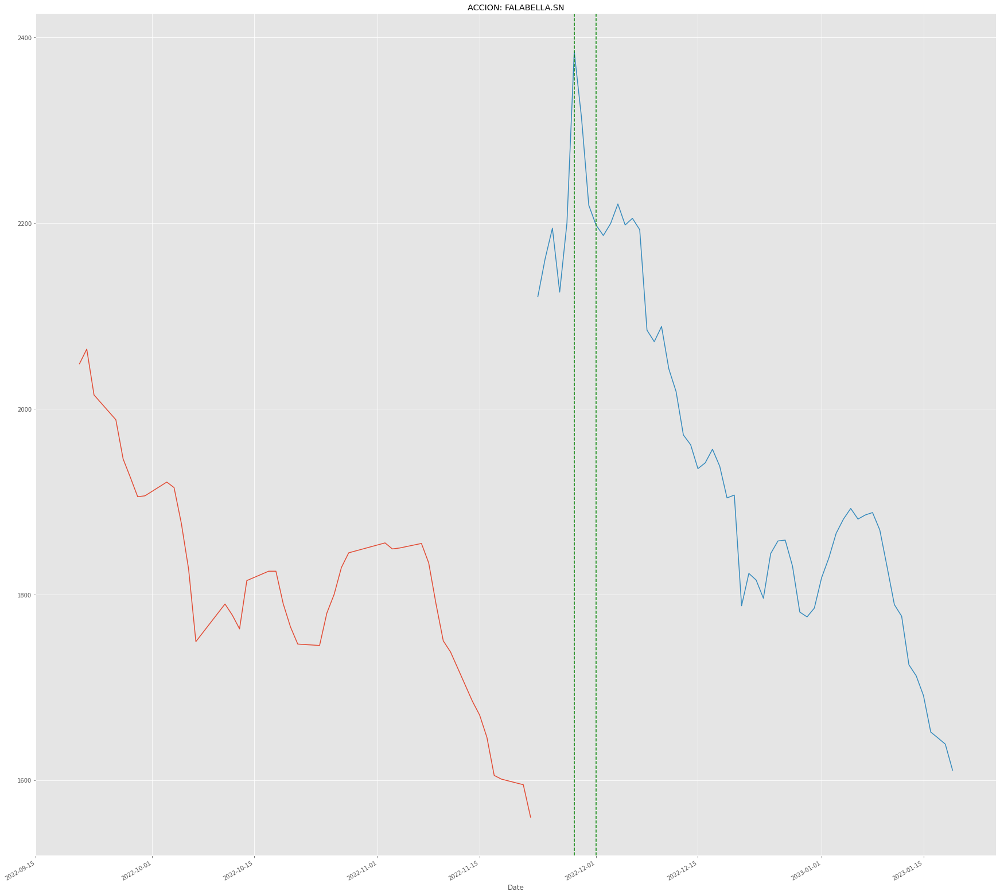


ENELAM.SN
Date
2022-12-21    102.484783
2022-12-22    103.924555
2022-12-23    104.130813
2022-12-24    103.731822
2022-12-25    103.425448
2022-12-26    103.910463
2022-12-27    103.532891
2022-12-28    103.115434
2022-12-29    101.499122
2022-12-30    105.172158
2022-12-31     97.899488
2023-01-01     98.032361
2023-01-02     94.114647
2023-01-03     92.297221
2023-01-04     92.691770
2023-01-05     95.045927
2023-01-06     93.356552
2023-01-07     93.730638
2023-01-08     94.011450
2023-01-09     95.192435
2023-01-10     95.150172
2023-01-11     94.105554
2023-01-12     94.003277
2023-01-13     93.351898
2023-01-14     94.082154
2023-01-15     91.744372
2023-01-16     89.933011
2023-01-17     93.288632
2023-01-18     99.716427
2023-01-19    105.035051
Name: Forecast, dtype: float64
----------------------


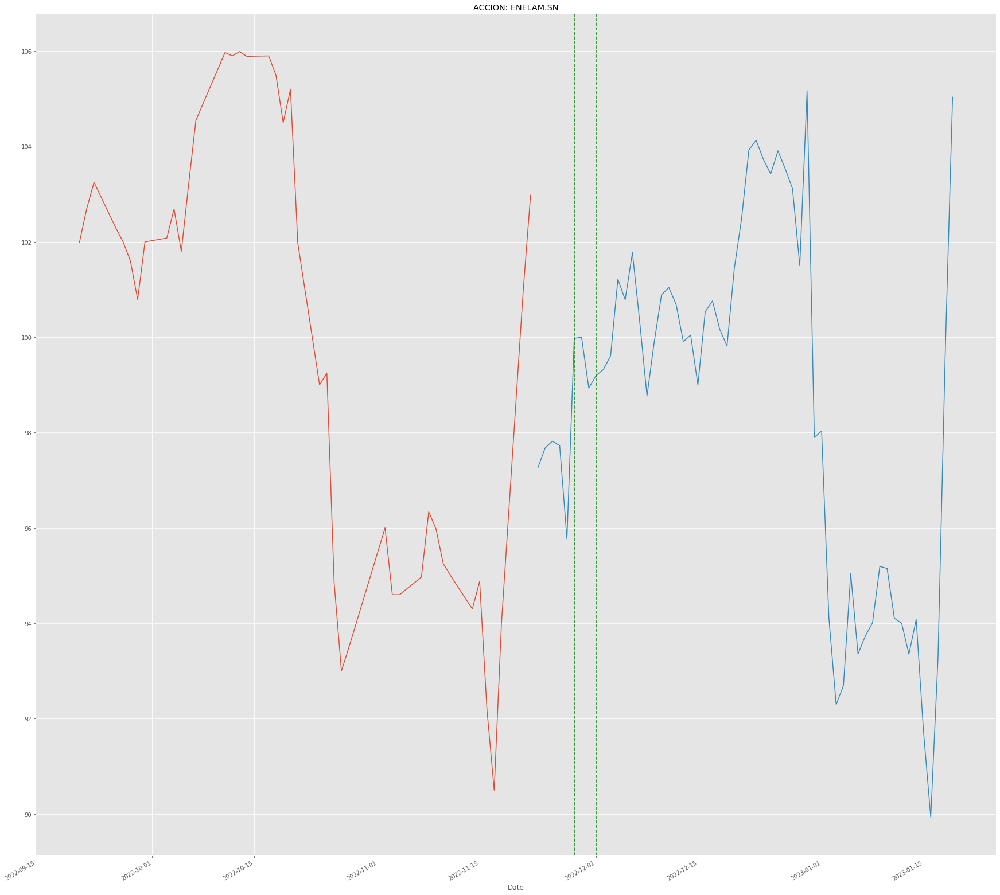


CMPC.SN
Date
2022-12-21    1468.730674
2022-12-22    1372.493007
2022-12-23    1406.101317
2022-12-24    1360.404614
2022-12-25    1333.399047
2022-12-26    1355.729362
2022-12-27    1365.075720
2022-12-28    1369.133414
2022-12-29    1331.177810
2022-12-30    1381.070852
2022-12-31    1443.990510
2023-01-01    1414.160528
2023-01-02    1442.636218
2023-01-03    1472.394678
2023-01-04    1478.781422
2023-01-05    1453.355358
2023-01-06    1463.460607
2023-01-07    1485.868866
2023-01-08    1543.222217
2023-01-09    1610.736356
2023-01-10    1587.813509
2023-01-11    1549.969209
2023-01-12    1522.921816
2023-01-13    1535.826063
2023-01-14    1507.196333
2023-01-15    1494.502812
2023-01-16    1507.727323
2023-01-17    1485.830182
2023-01-18    1488.354363
2023-01-19    1484.174720
Name: Forecast, dtype: float64
----------------------


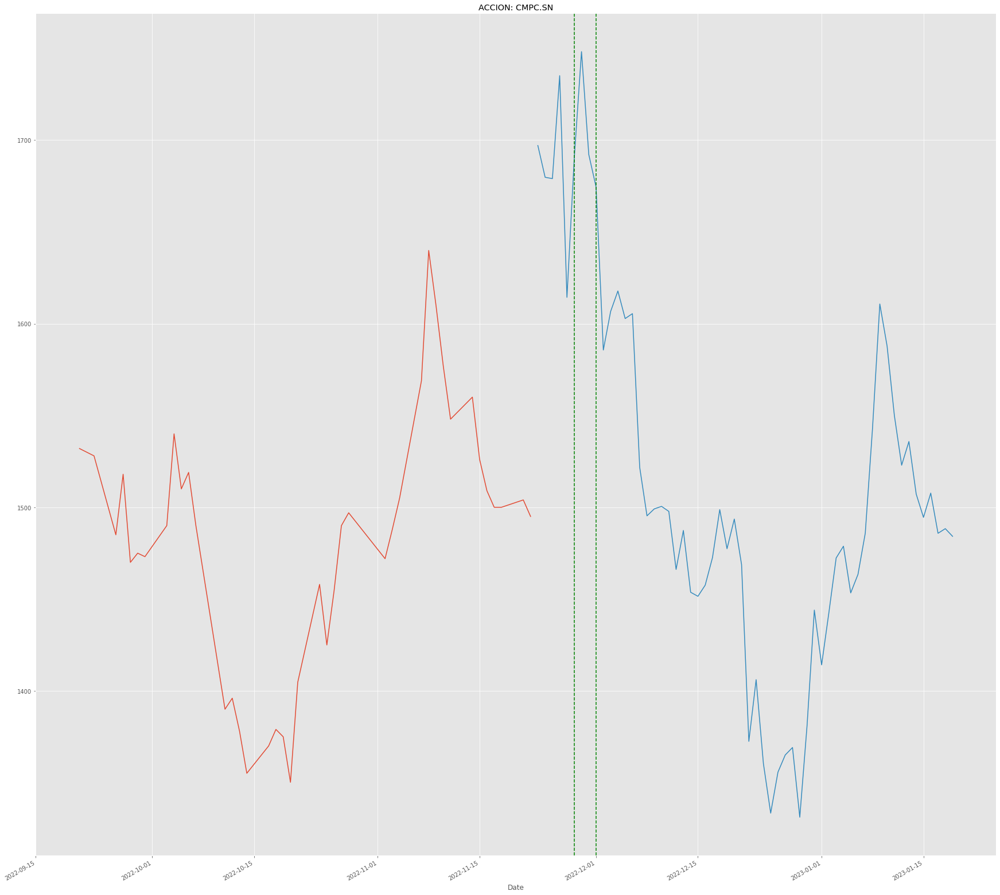


BCI.SN
Date
2022-12-01    24975.527212
2022-12-02    24090.222529
2022-12-03    23778.294138
2022-12-04    23779.475431
2022-12-05    24023.847152
2022-12-06    25372.797668
2022-12-07    26048.644028
2022-12-08    25561.913055
2022-12-09    25460.093049
2022-12-10    25956.085395
2022-12-11    25923.262295
2022-12-12    26298.612606
2022-12-13    26236.151491
2022-12-14    26144.144492
2022-12-15    26198.092556
2022-12-16    26062.960890
2022-12-17    25295.479616
2022-12-18    25650.597390
2022-12-19    26095.449304
2022-12-20    26183.839605
2022-12-21    26130.416014
2022-12-22    25929.216555
2022-12-23    25898.390157
2022-12-24    25654.591243
2022-12-25    25870.980672
2022-12-26    25962.341187
2022-12-27    26070.961433
2022-12-28    26032.168711
2022-12-29    25926.364886
2022-12-30    25784.210915
Name: Forecast, dtype: float64
----------------------


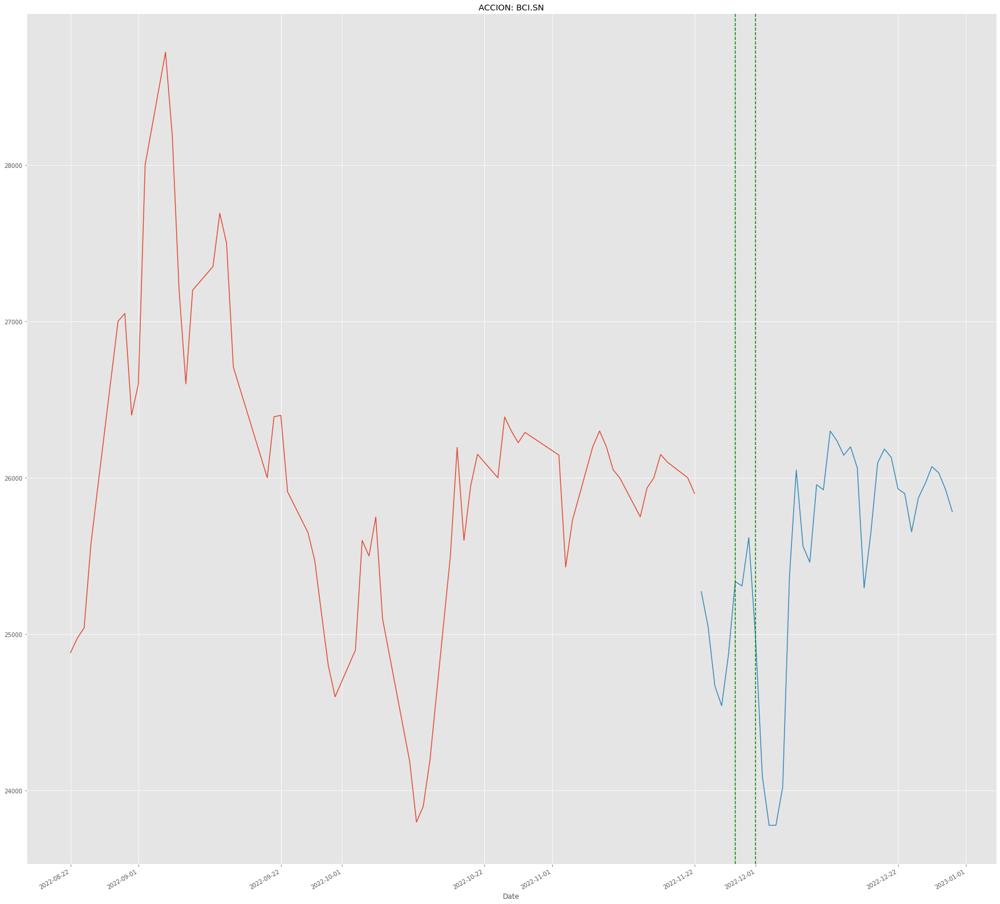


VAPORES.SN
Date
2022-12-21    68.302189
2022-12-22    66.404526
2022-12-23    63.090415
2022-12-24    62.301968
2022-12-25    63.301205
2022-12-26    65.692935
2022-12-27    64.468769
2022-12-28    64.280489
2022-12-29    73.410599
2022-12-30    69.634262
2022-12-31    65.999643
2023-01-01    65.995491
2023-01-02    65.756129
2023-01-03    67.772970
2023-01-04    67.306271
2023-01-05    65.911787
2023-01-06    64.335987
2023-01-07    66.439176
2023-01-08    71.118188
2023-01-09    74.229280
2023-01-10    72.000272
2023-01-11    72.750164
2023-01-12    73.957069
2023-01-13    75.239414
2023-01-14    73.433064
2023-01-15    73.711663
2023-01-16    73.853165
2023-01-17    74.347601
2023-01-18    75.397570
2023-01-19    73.602393
Name: Forecast, dtype: float64
----------------------


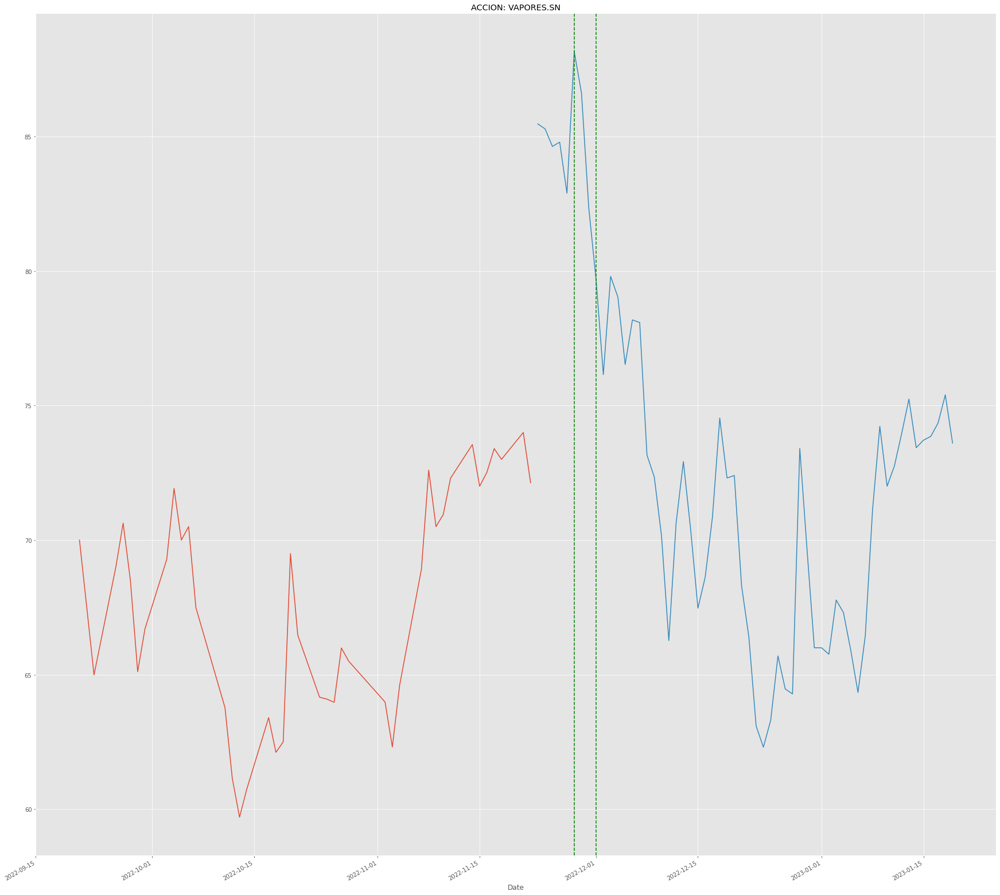


CAP.SN
Date
2022-12-21    6018.585998
2022-12-22    5760.674519
2022-12-23    5643.415684
2022-12-24    5476.000390
2022-12-25    5539.308965
2022-12-26    5566.967103
2022-12-27    5660.398844
2022-12-28    5653.179483
2022-12-29    5296.889403
2022-12-30    5425.232756
2022-12-31    5420.483662
2023-01-01    5333.567046
2023-01-02    5303.566156
2023-01-03    5193.751692
2023-01-04    5060.935496
2023-01-05    5174.777589
2023-01-06    5045.751820
2023-01-07    5481.900219
2023-01-08    5431.878160
2023-01-09    5571.704877
2023-01-10    5536.704601
2023-01-11    5742.520924
2023-01-12    5977.529084
2023-01-13    6007.577483
2023-01-14    6216.322885
2023-01-15    6599.341344
2023-01-16    6109.442702
2023-01-17    6242.440468
2023-01-18    6091.185005
2023-01-19    5977.543515
Name: Forecast, dtype: float64
----------------------


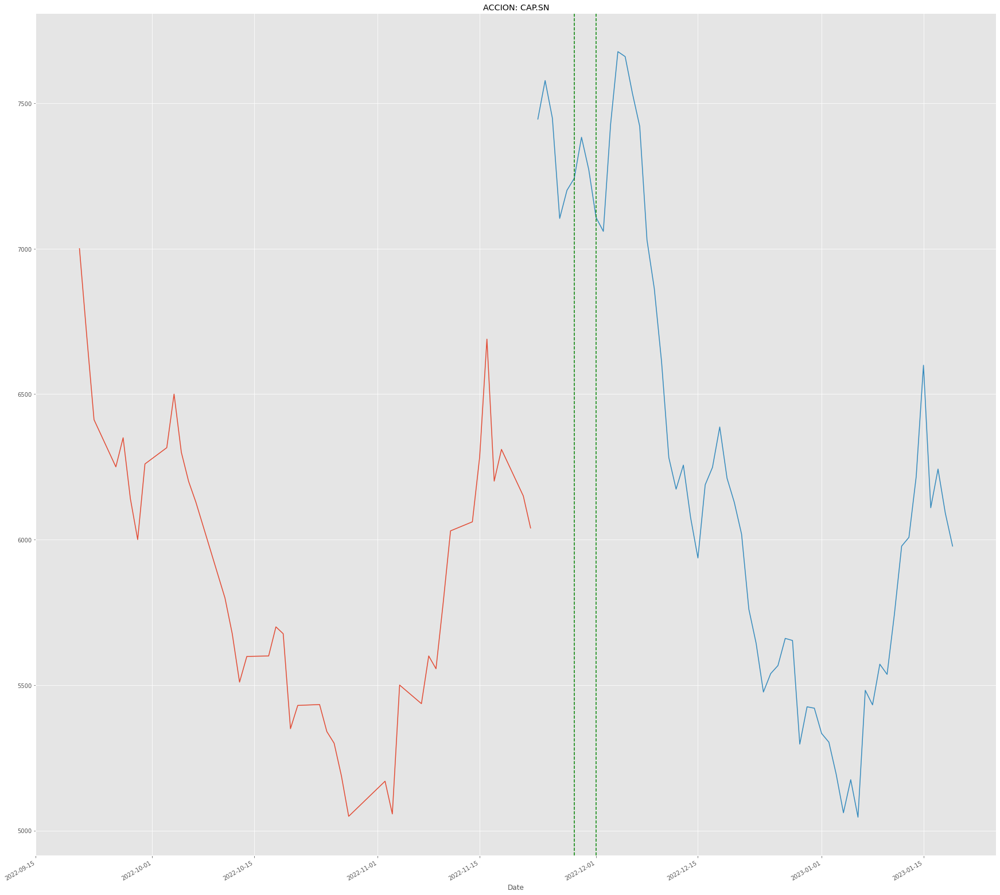


CCU.SN
Date
2022-12-21    5010.169961
2022-12-22    4870.317297
2022-12-23    4899.562268
2022-12-24    5003.299621
2022-12-25    5008.934570
2022-12-26    5192.942193
2022-12-27    5282.233269
2022-12-28    5202.026316
2022-12-29    5206.042173
2022-12-30    5136.553213
2022-12-31    5065.945309
2023-01-01    5062.119138
2023-01-02    5025.418860
2023-01-03    5055.049191
2023-01-04    5178.773223
2023-01-05    5232.631836
2023-01-06    5184.623003
2023-01-07    5202.215428
2023-01-08    5192.220687
2023-01-09    5228.099297
2023-01-10    5164.297675
2023-01-11    5059.741484
2023-01-12    5105.335755
2023-01-13    5107.269844
2023-01-14    5177.916192
2023-01-15    5212.864930
2023-01-16    5204.432208
2023-01-17    5309.589306
2023-01-18    5366.763940
2023-01-19    5425.155303
Name: Forecast, dtype: float64
----------------------


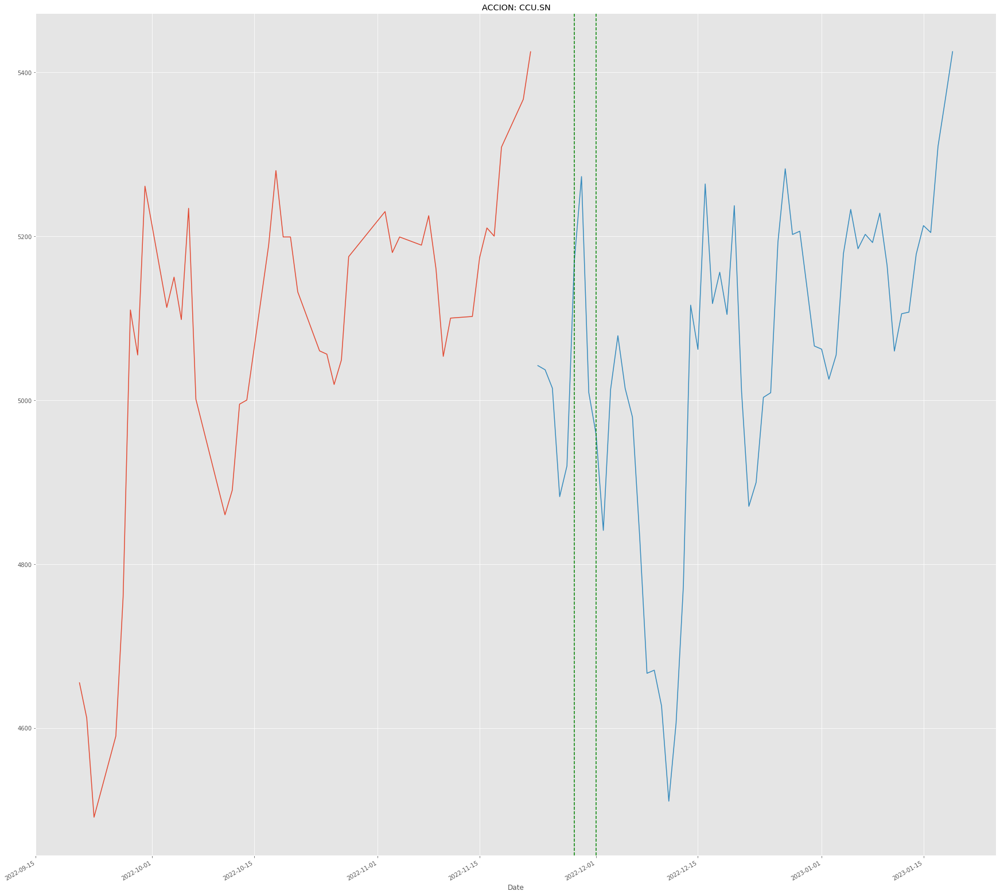


ENELCHILE.SN
Date
2022-11-04          NaN
2022-11-07          NaN
2022-11-08          NaN
2022-11-09          NaN
2022-11-10          NaN
2022-11-11          NaN
2022-11-14          NaN
2022-11-15          NaN
2022-11-16          NaN
2022-11-17          NaN
2022-11-18          NaN
2022-11-21          NaN
2022-11-22          NaN
2022-11-23    32.161034
2022-11-24    33.614875
2022-11-25    34.472777
2022-11-26    34.200969
2022-11-27    34.136434
2022-11-28    35.287695
2022-11-29    35.042346
2022-11-30    34.725671
2022-12-01    33.713712
2022-12-02    33.995786
2022-12-03    34.302800
2022-12-04    33.452256
2022-12-05    33.542985
2022-12-06    34.912418
2022-12-07    35.860370
2022-12-08    37.252201
2022-12-09    37.787518
Name: Forecast, dtype: float64
----------------------


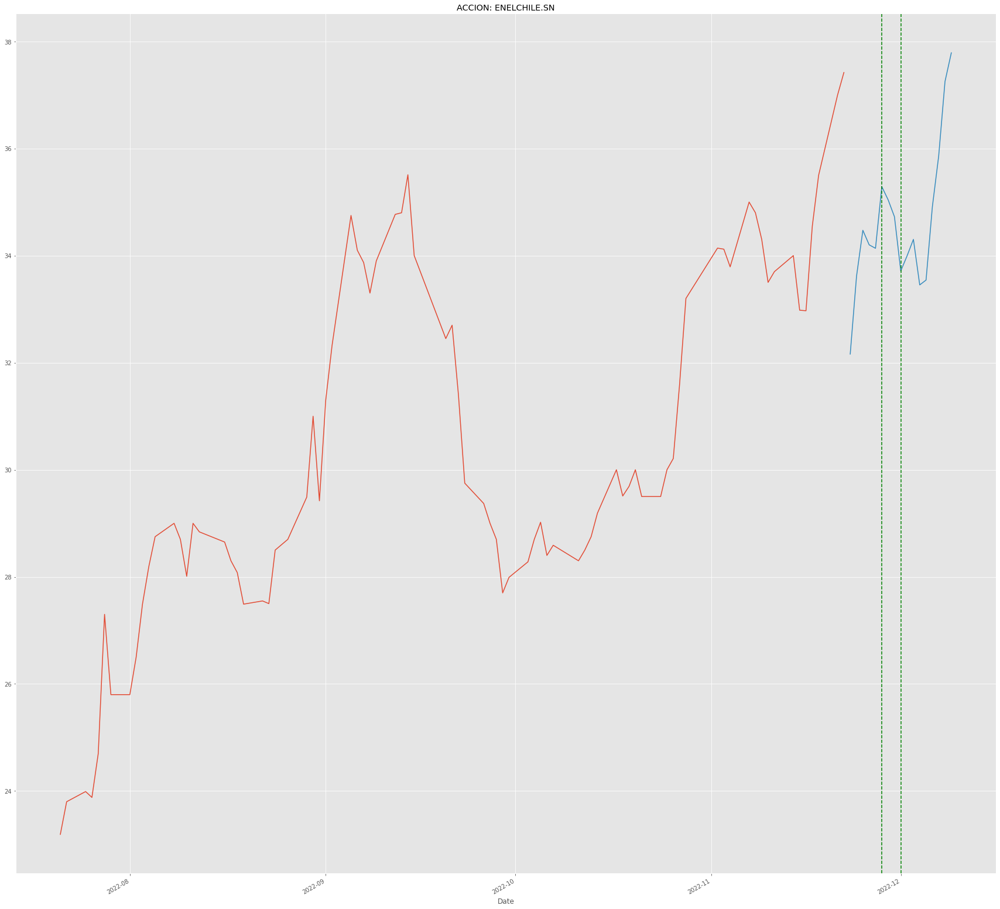


ANDINA-B.SN
Date
2022-12-21    1621.817768
2022-12-22    1620.319050
2022-12-23    1644.353562
2022-12-24    1653.377535
2022-12-25    1648.674657
2022-12-26    1629.750052
2022-12-27    1614.591145
2022-12-28    1608.566706
2022-12-29    1629.744876
2022-12-30    1622.404025
2022-12-31    1615.100373
2023-01-01    1651.401323
2023-01-02    1638.250228
2023-01-03    1667.603118
2023-01-04    1648.474598
2023-01-05    1660.890637
2023-01-06    1649.783673
2023-01-07    1648.316248
2023-01-08    1670.898054
2023-01-09    1686.126038
2023-01-10    1657.794708
2023-01-11    1683.524288
2023-01-12    1669.223824
2023-01-13    1671.595633
2023-01-14    1695.503466
2023-01-15    1695.432549
2023-01-16    1723.778341
2023-01-17    1735.045397
2023-01-18    1725.689566
2023-01-19    1728.188256
Name: Forecast, dtype: float64
----------------------


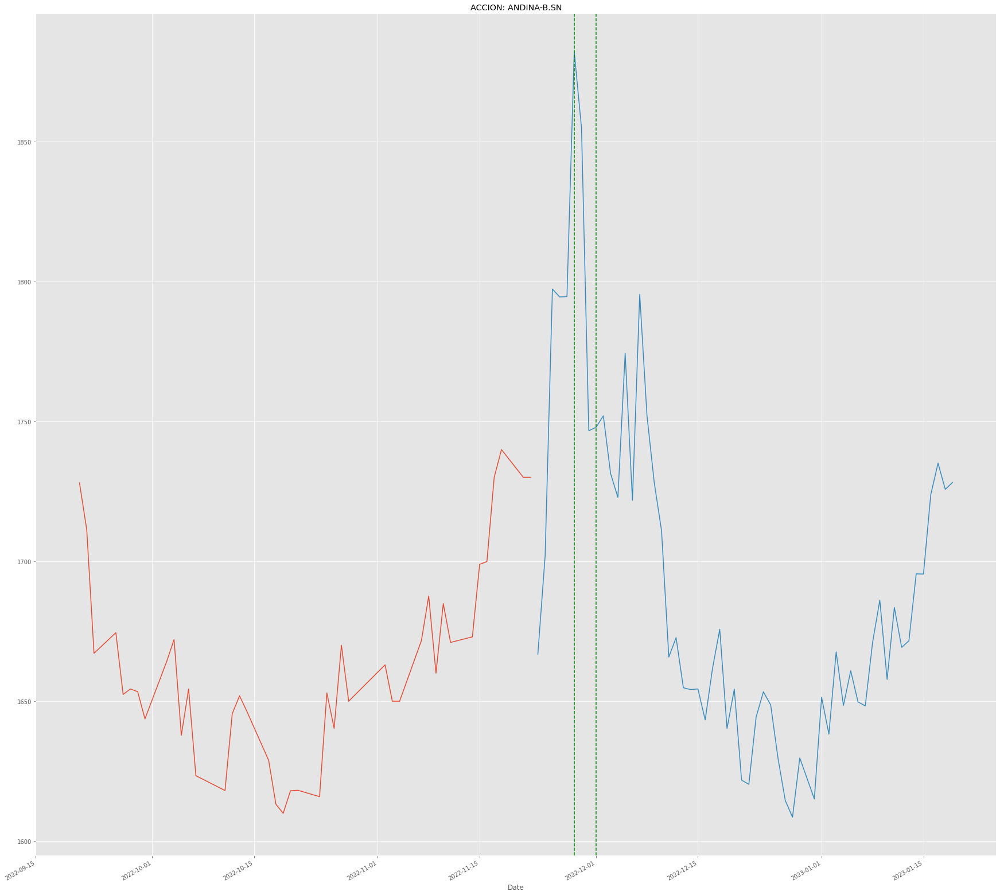


CONCHATORO.SN
Date
2022-12-21    1054.302019
2022-12-22    1034.640527
2022-12-23    1040.443944
2022-12-24    1034.460456
2022-12-25    1032.521642
2022-12-26    1041.726412
2022-12-27    1051.101133
2022-12-28    1045.308739
2022-12-29    1044.518676
2022-12-30    1042.965929
2022-12-31    1035.919456
2023-01-01    1044.076490
2023-01-02    1059.378748
2023-01-03    1072.952476
2023-01-04    1060.297607
2023-01-05    1047.630658
2023-01-06    1054.282678
2023-01-07    1044.961158
2023-01-08    1071.380633
2023-01-09    1073.446227
2023-01-10    1068.957508
2023-01-11    1046.295061
2023-01-12    1035.168800
2023-01-13    1048.718643
2023-01-14    1059.615480
2023-01-15    1065.685354
2023-01-16    1066.413511
2023-01-17    1064.469273
2023-01-18    1061.047947
2023-01-19    1062.592019
Name: Forecast, dtype: float64
----------------------


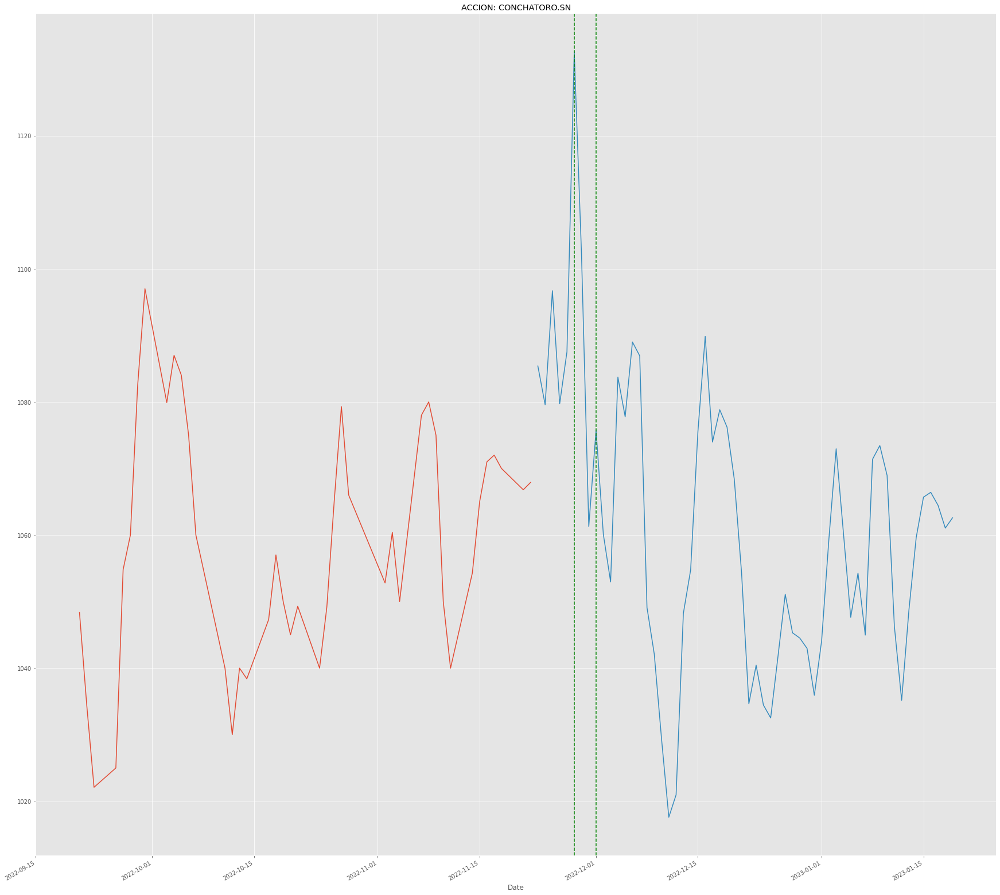


PARAUCO.SN
Date
2022-12-21    767.377217
2022-12-22    757.050868
2022-12-23    750.903090
2022-12-24    761.150891
2022-12-25    770.683798
2022-12-26    783.676577
2022-12-27    794.001746
2022-12-28    789.884270
2022-12-29    742.152282
2022-12-30    765.252692
2022-12-31    752.240053
2023-01-01    760.827702
2023-01-02    753.910764
2023-01-03    769.924951
2023-01-04    798.974446
2023-01-05    812.416979
2023-01-06    797.498378
2023-01-07    831.364666
2023-01-08    862.658012
2023-01-09    868.799843
2023-01-10    897.751961
2023-01-11    930.970901
2023-01-12    920.692762
2023-01-13    924.141823
2023-01-14    927.017729
2023-01-15    951.158156
2023-01-16    956.680056
2023-01-17    973.731085
2023-01-18    972.761138
2023-01-19    974.427797
Name: Forecast, dtype: float64
----------------------


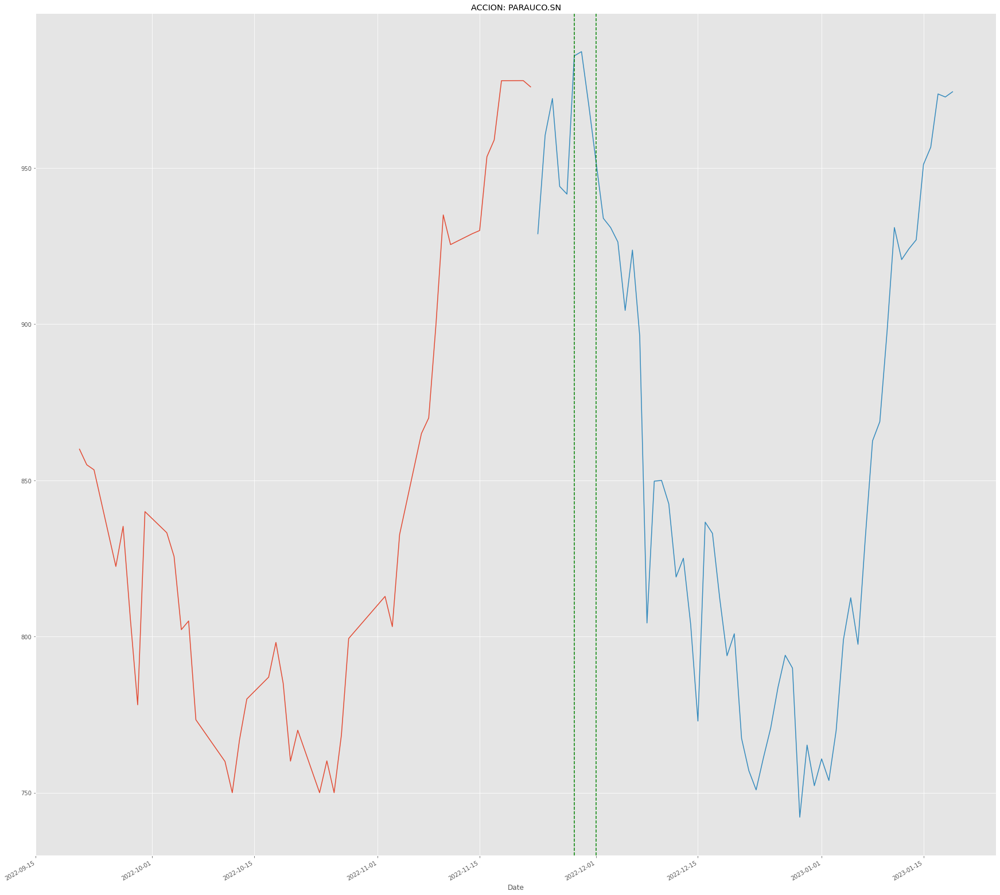


ITAUCORP.SN
Date
2022-12-14    1.872213
2022-12-15    1.838264
2022-12-16    1.833582
2022-12-17    1.904085
2022-12-18    1.895002
2022-12-19    1.896944
2022-12-20    1.899997
2022-12-21    1.868891
2022-12-22    1.937918
2022-12-23    1.917700
2022-12-24    1.876972
2022-12-25    1.858229
2022-12-26    1.914392
2022-12-27    1.885564
2022-12-28    1.896905
2022-12-29    1.877833
2022-12-30    1.882438
2022-12-31    1.905983
2023-01-01    1.934892
2023-01-02    1.978863
2023-01-03    1.965274
2023-01-04    1.982515
2023-01-05    1.994319
2023-01-06    1.995475
2023-01-07    1.974740
2023-01-08    1.979995
2023-01-09    1.942050
2023-01-10    1.931826
2023-01-11    1.930673
2023-01-12    1.930993
Name: Forecast, dtype: float64
----------------------


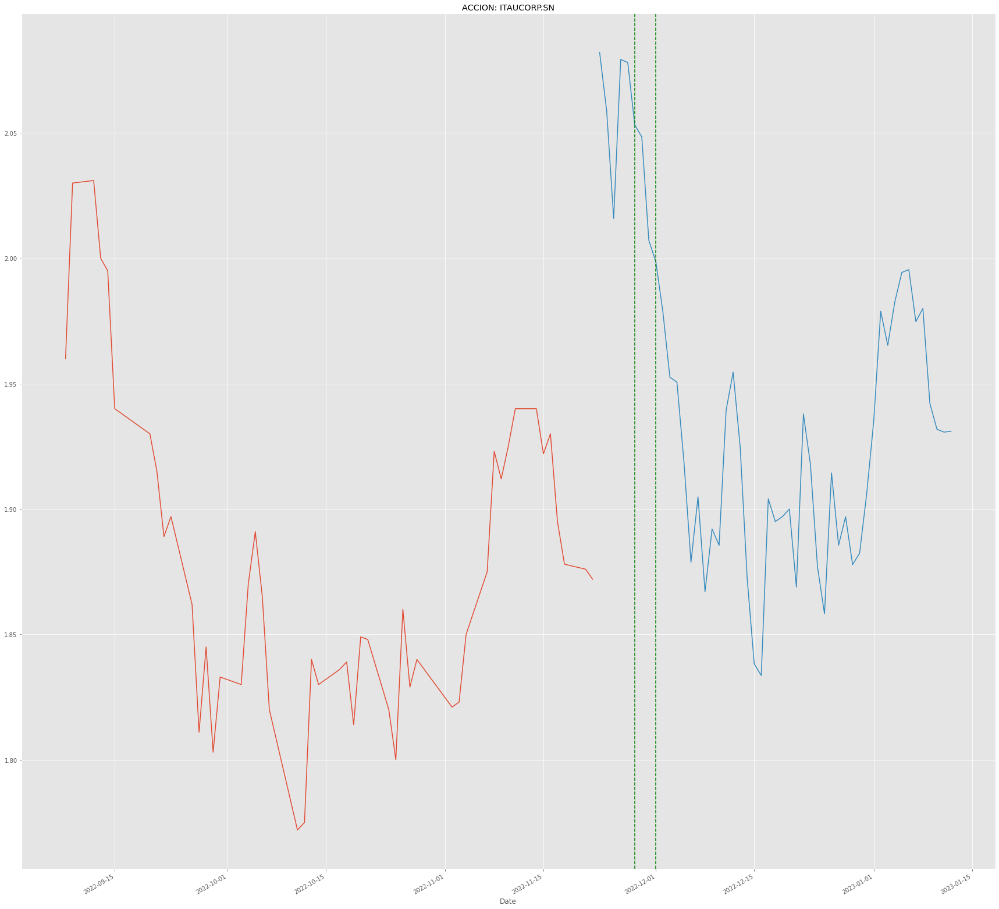


AGUAS-A.SN
Date
2022-12-21    193.677256
2022-12-22    190.443081
2022-12-23    188.583650
2022-12-24    188.457442
2022-12-25    190.747072
2022-12-26    193.469199
2022-12-27    193.475033
2022-12-28    191.864600
2022-12-29    193.442594
2022-12-30    193.043252
2022-12-31    192.579642
2023-01-01    192.971743
2023-01-02    194.261421
2023-01-03    198.350283
2023-01-04    199.292665
2023-01-05    199.305664
2023-01-06    198.471289
2023-01-07    196.834183
2023-01-08    198.311827
2023-01-09    199.280996
2023-01-10    198.343418
2023-01-11    198.502300
2023-01-12    198.295023
2023-01-13    197.336916
2023-01-14    198.345726
2023-01-15    198.149304
2023-01-16    197.429841
2023-01-17    200.225411
2023-01-18    200.052415
2023-01-19    202.639366
Name: Forecast, dtype: float64
----------------------


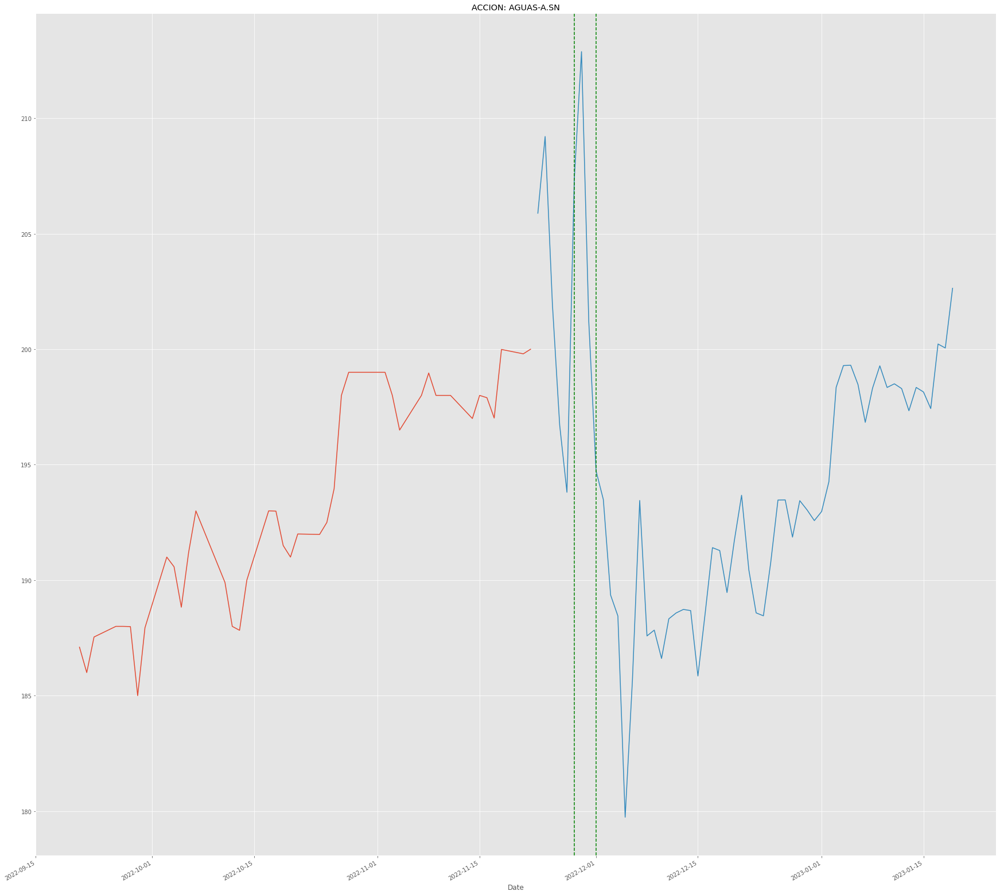


COLBUN.SN
Date
2022-12-21    82.146883
2022-12-22    80.588447
2022-12-23    80.526717
2022-12-24    80.152849
2022-12-25    81.374204
2022-12-26    83.393095
2022-12-27    84.675308
2022-12-28    86.281868
2022-12-29    88.582361
2022-12-30    88.289301
2022-12-31    86.518296
2023-01-01    87.266092
2023-01-02    87.460126
2023-01-03    90.280146
2023-01-04    93.769353
2023-01-05    94.504907
2023-01-06    94.386088
2023-01-07    93.663906
2023-01-08    94.570516
2023-01-09    92.921368
2023-01-10    92.622462
2023-01-11    92.175864
2023-01-12    90.957365
2023-01-13    90.305773
2023-01-14    88.874072
2023-01-15    88.095677
2023-01-16    87.321049
2023-01-17    87.528515
2023-01-18    86.990218
2023-01-19    86.553981
Name: Forecast, dtype: float64
----------------------


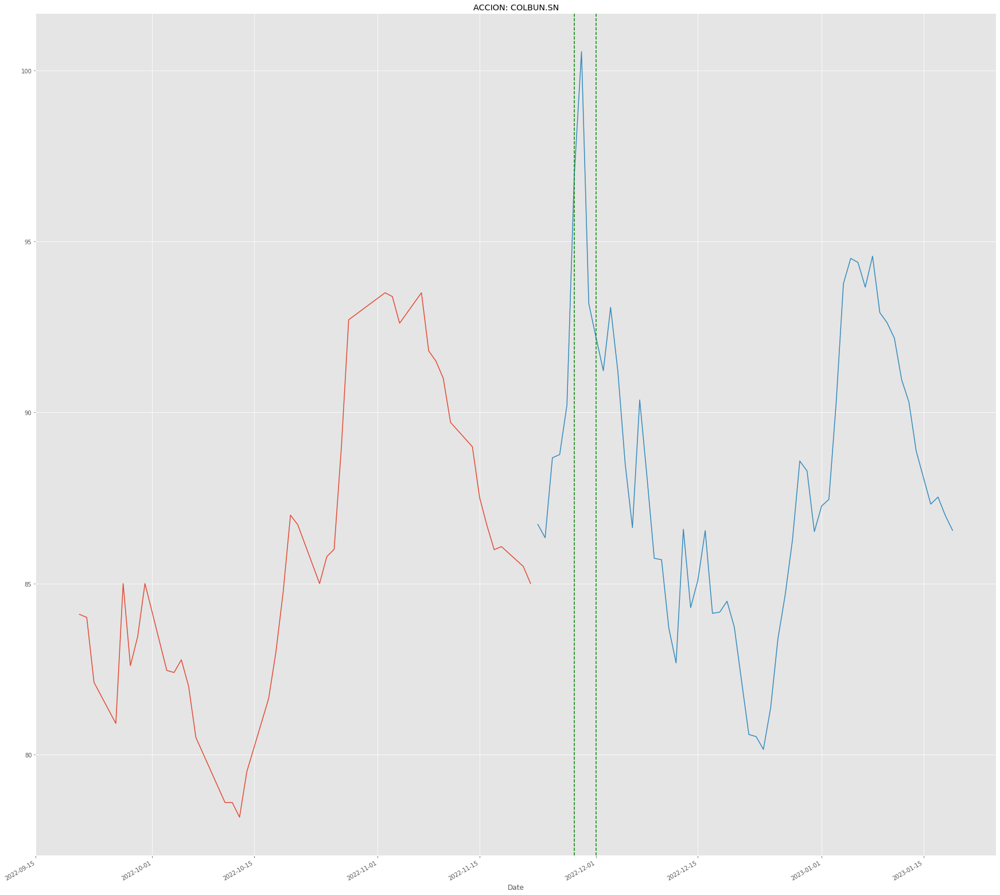


CENCOSHOPP.SN
Date
2022-10-21            NaN
2022-10-24            NaN
2022-10-25            NaN
2022-10-26            NaN
2022-10-27            NaN
2022-10-28            NaN
2022-11-02            NaN
2022-11-03            NaN
2022-11-04            NaN
2022-11-07            NaN
2022-11-08            NaN
2022-11-09            NaN
2022-11-10            NaN
2022-11-11            NaN
2022-11-14            NaN
2022-11-15            NaN
2022-11-16            NaN
2022-11-17            NaN
2022-11-18            NaN
2022-11-21            NaN
2022-11-22            NaN
2022-11-23    1119.944687
2022-11-24    1129.511438
2022-11-25    1142.941286
2022-11-26    1168.144105
2022-11-27    1179.172058
2022-11-28    1166.014543
2022-11-29    1155.381045
2022-11-30    1152.265548
2022-12-01    1164.298120
Name: Forecast, dtype: float64
----------------------


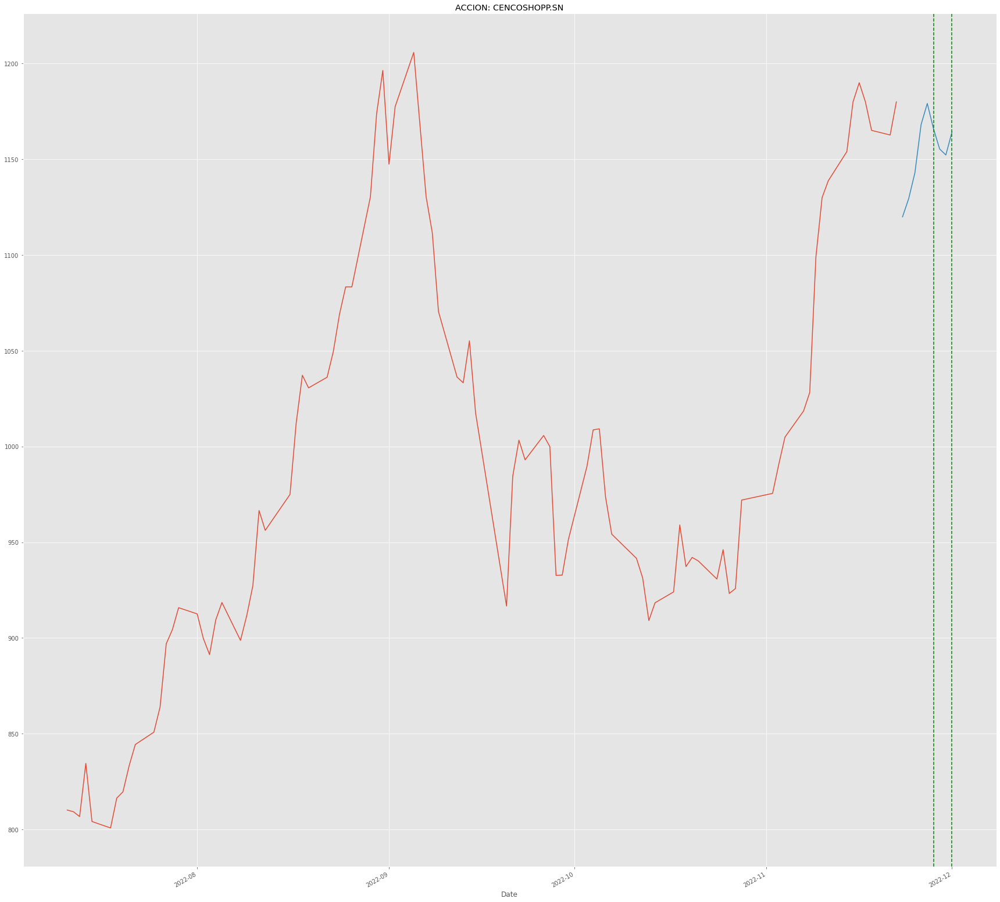


ENTEL.SN
Date
2022-12-21    2786.664503
2022-12-22    2693.319483
2022-12-23    2671.501575
2022-12-24    2734.832405
2022-12-25    2800.309799
2022-12-26    2755.719358
2022-12-27    2810.957760
2022-12-28    2762.003810
2022-12-29    3291.081473
2022-12-30    3017.607079
2022-12-31    2952.541253
2023-01-01    2922.644888
2023-01-02    2912.219309
2023-01-03    2987.865228
2023-01-04    2988.113206
2023-01-05    2992.877707
2023-01-06    3030.412672
2023-01-07    3010.392841
2023-01-08    3023.945391
2023-01-09    3057.313509
2023-01-10    2978.646322
2023-01-11    2995.700083
2023-01-12    2974.000000
2023-01-13    2953.986698
2023-01-14    2885.016431
2023-01-15    2864.929308
2023-01-16    2871.490657
2023-01-17    2864.104894
2023-01-18    2936.525519
2023-01-19    2951.572515
Name: Forecast, dtype: float64
----------------------


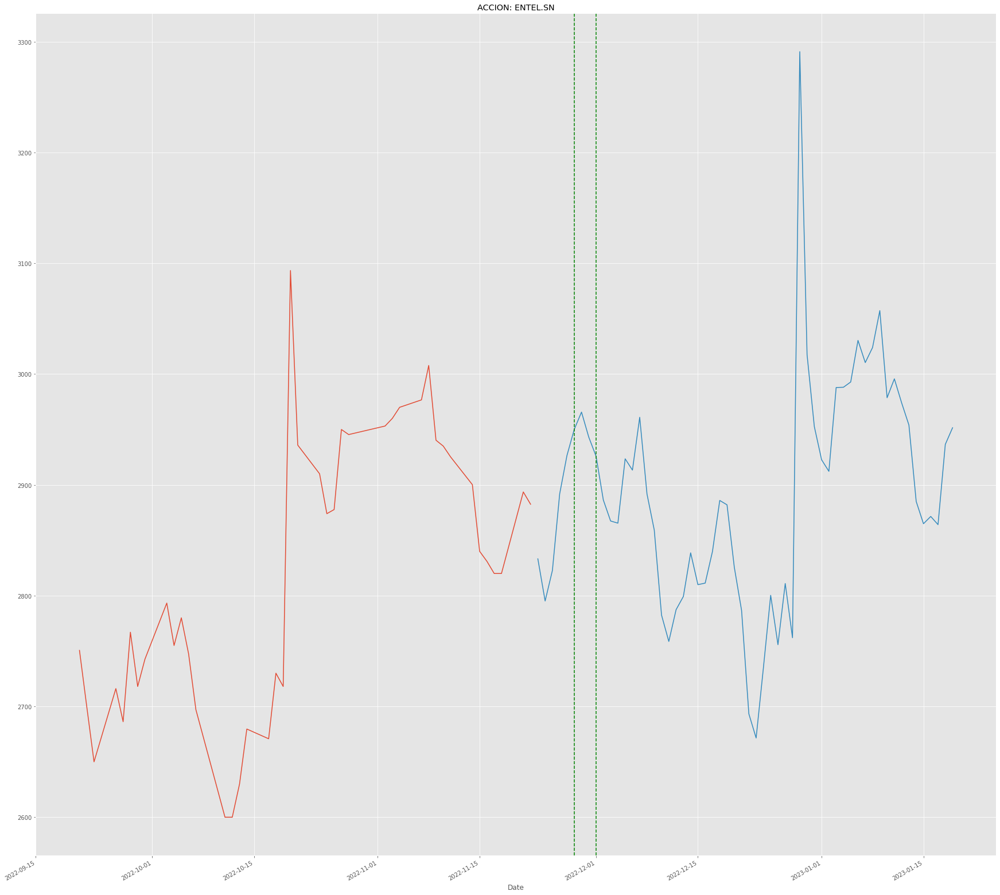


MALLPLAZA.SN
Date
2022-10-25           NaN
2022-10-26           NaN
2022-10-27           NaN
2022-10-28           NaN
2022-11-02           NaN
2022-11-03           NaN
2022-11-04           NaN
2022-11-07           NaN
2022-11-08           NaN
2022-11-09           NaN
2022-11-10           NaN
2022-11-11           NaN
2022-11-14           NaN
2022-11-15           NaN
2022-11-16           NaN
2022-11-17           NaN
2022-11-18           NaN
2022-11-21           NaN
2022-11-22           NaN
2022-11-23    858.323457
2022-11-24    884.245736
2022-11-25    885.106383
2022-11-26    907.331282
2022-11-27    908.573820
2022-11-28    923.437346
2022-11-29    935.634369
2022-11-30    950.187050
2022-12-01    984.470594
2022-12-02    962.757663
2022-12-03    975.046799
Name: Forecast, dtype: float64
----------------------


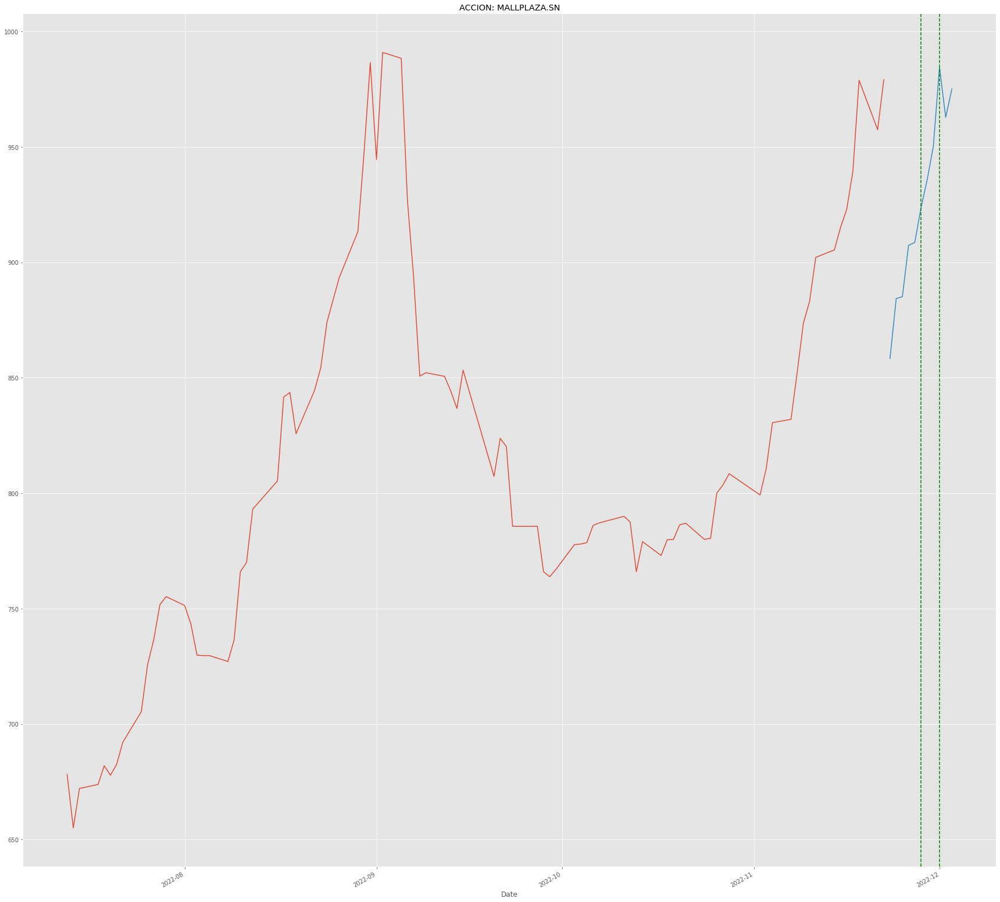


IAM.SN
Date
2022-12-06    390.310172
2022-12-07    385.123212
2022-12-08    390.976650
2022-12-09    395.345437
2022-12-10    396.234779
2022-12-11    413.162440
2022-12-12    415.386939
2022-12-13    405.360637
2022-12-14    397.461765
2022-12-15    396.615116
2022-12-16    410.754433
2022-12-17    418.770878
2022-12-18    431.495946
2022-12-19    443.988140
2022-12-20    453.717027
2022-12-21    445.939308
2022-12-22    446.335434
2022-12-23    446.018980
2022-12-24    453.934329
2022-12-25    453.821175
2022-12-26    459.439101
2022-12-27    464.473642
2022-12-28    463.994497
2022-12-29    466.417912
2022-12-30    461.219662
2022-12-31    460.151118
2023-01-01    460.024449
2023-01-02    462.495465
2023-01-03    465.805147
2023-01-04    455.675784
Name: Forecast, dtype: float64
----------------------


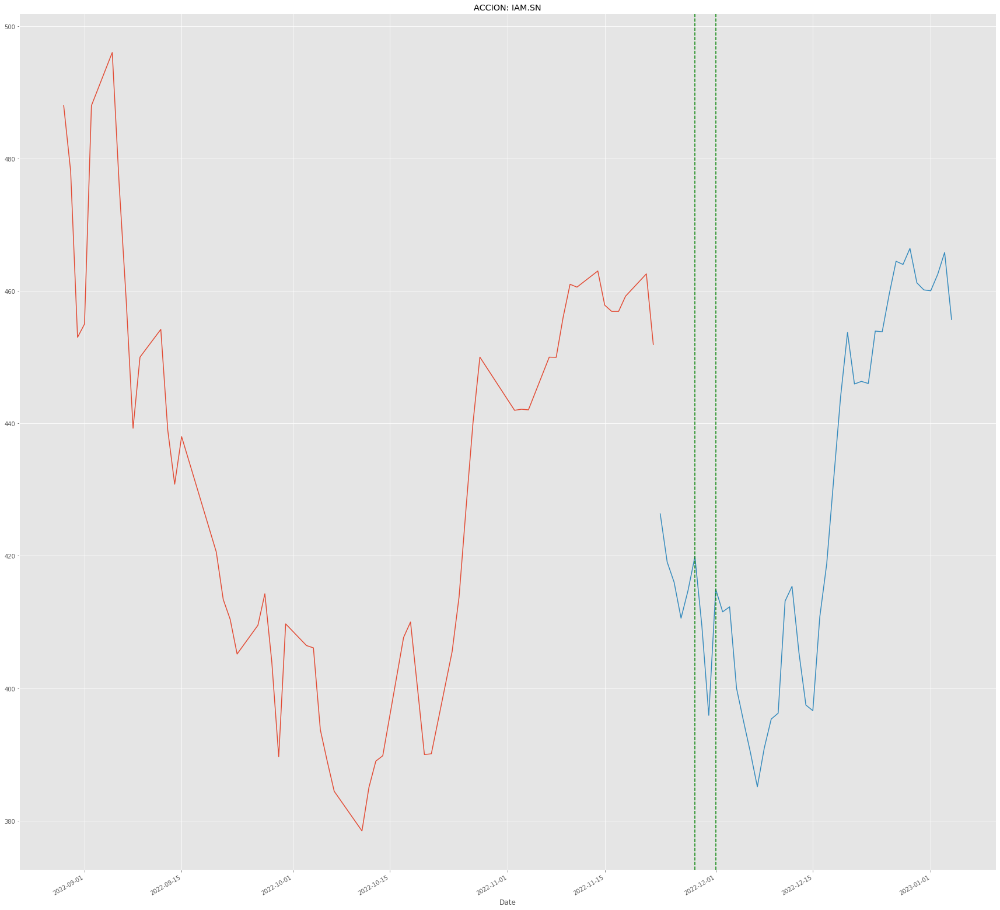


SMU.SN
Date
2022-11-02           NaN
2022-11-03           NaN
2022-11-04           NaN
2022-11-07           NaN
2022-11-08           NaN
2022-11-09           NaN
2022-11-10           NaN
2022-11-11           NaN
2022-11-14           NaN
2022-11-15           NaN
2022-11-16           NaN
2022-11-17           NaN
2022-11-18           NaN
2022-11-21           NaN
2022-11-22           NaN
2022-11-23     95.839084
2022-11-24     95.354366
2022-11-25     96.802056
2022-11-26     96.982712
2022-11-27     97.468434
2022-11-28     98.538246
2022-11-29     99.817960
2022-11-30    101.231488
2022-12-01    100.895117
2022-12-02    103.955785
2022-12-03    106.813965
2022-12-04    108.509321
2022-12-05    110.592562
2022-12-06    106.247792
2022-12-07    108.991097
Name: Forecast, dtype: float64
----------------------


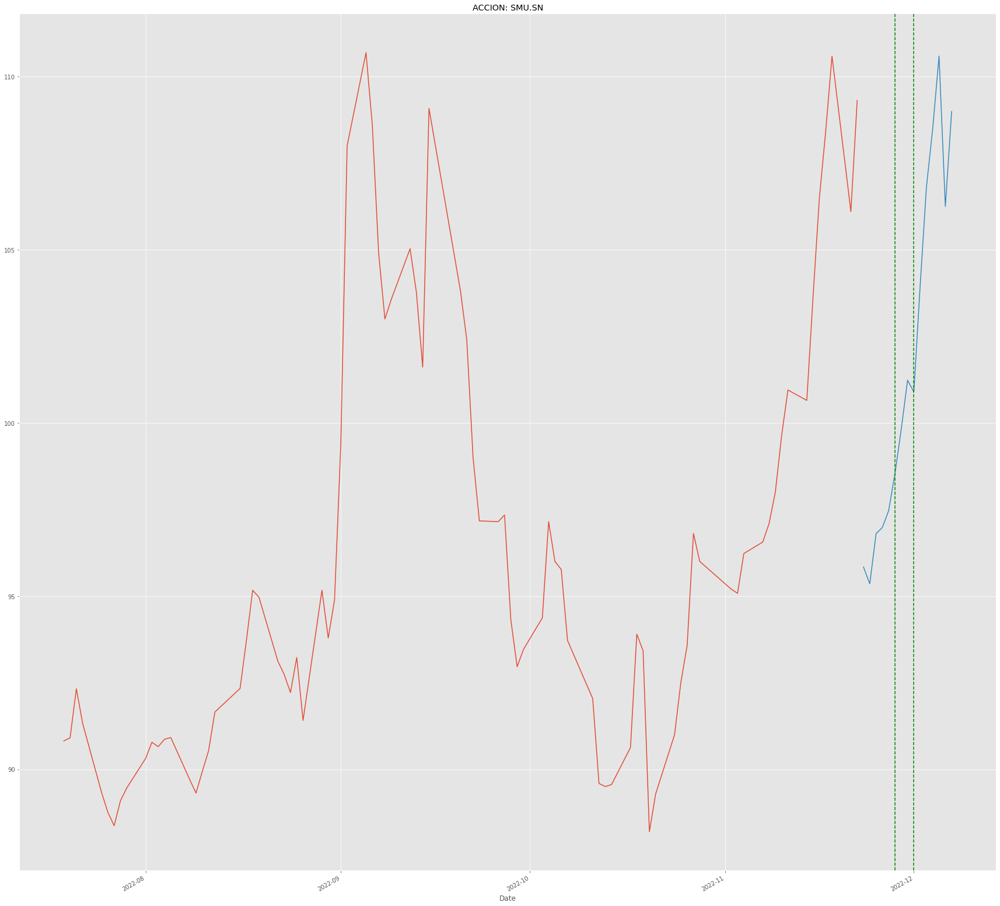


ECL.SN
Date
2022-12-21    477.872741
2022-12-22    463.605814
2022-12-23    467.299322
2022-12-24    481.069512
2022-12-25    495.223707
2022-12-26    508.711261
2022-12-27    516.314781
2022-12-28    500.571154
2022-12-29    500.679955
2022-12-30    514.455056
2022-12-31    504.925259
2023-01-01    527.114979
2023-01-02    534.533860
2023-01-03    549.844752
2023-01-04    562.288266
2023-01-05    558.196958
2023-01-06    551.640869
2023-01-07    542.415028
2023-01-08    535.814331
2023-01-09    536.766832
2023-01-10    526.246245
2023-01-11    525.805587
2023-01-12    509.571302
2023-01-13    521.964555
2023-01-14    509.971746
2023-01-15    513.591955
2023-01-16    512.445902
2023-01-17    514.560906
2023-01-18    518.527435
2023-01-19    518.904148
Name: Forecast, dtype: float64
----------------------


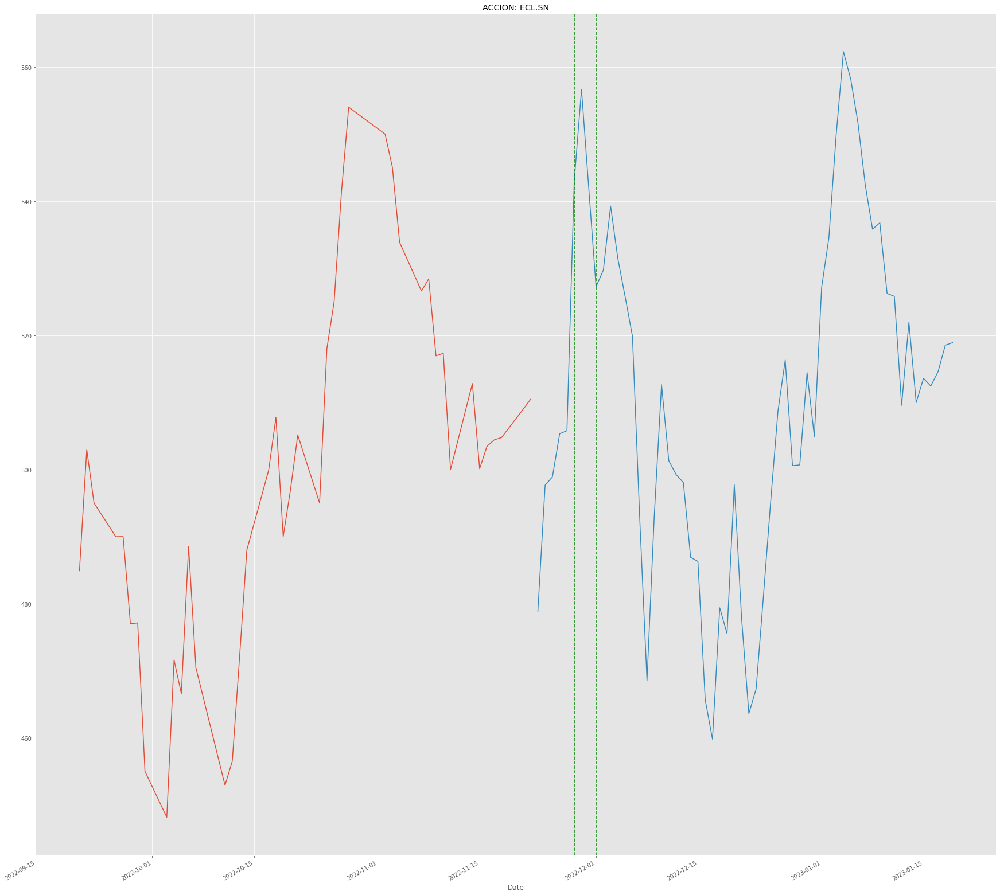


SONDA.SN
Date
2022-12-04    356.323489
2022-12-05    349.254848
2022-12-06    336.561027
2022-12-07    343.976230
2022-12-08    344.629867
2022-12-09    344.679226
2022-12-10    345.881844
2022-12-11    339.740337
2022-12-12    349.012591
2022-12-13    343.856849
2022-12-14    336.642166
2022-12-15    339.141874
2022-12-16    340.249893
2022-12-17    336.611162
2022-12-18    344.956177
2022-12-19    350.293437
2022-12-20    343.947282
2022-12-21    340.837477
2022-12-22    348.358702
2022-12-23    348.544052
2022-12-24    343.384884
2022-12-25    350.738152
2022-12-26    341.603440
2022-12-27    337.814895
2022-12-28    338.812696
2022-12-29    334.436290
2022-12-30    335.602133
2022-12-31    334.946337
2023-01-01    338.668866
2023-01-02    341.647057
Name: Forecast, dtype: float64
----------------------


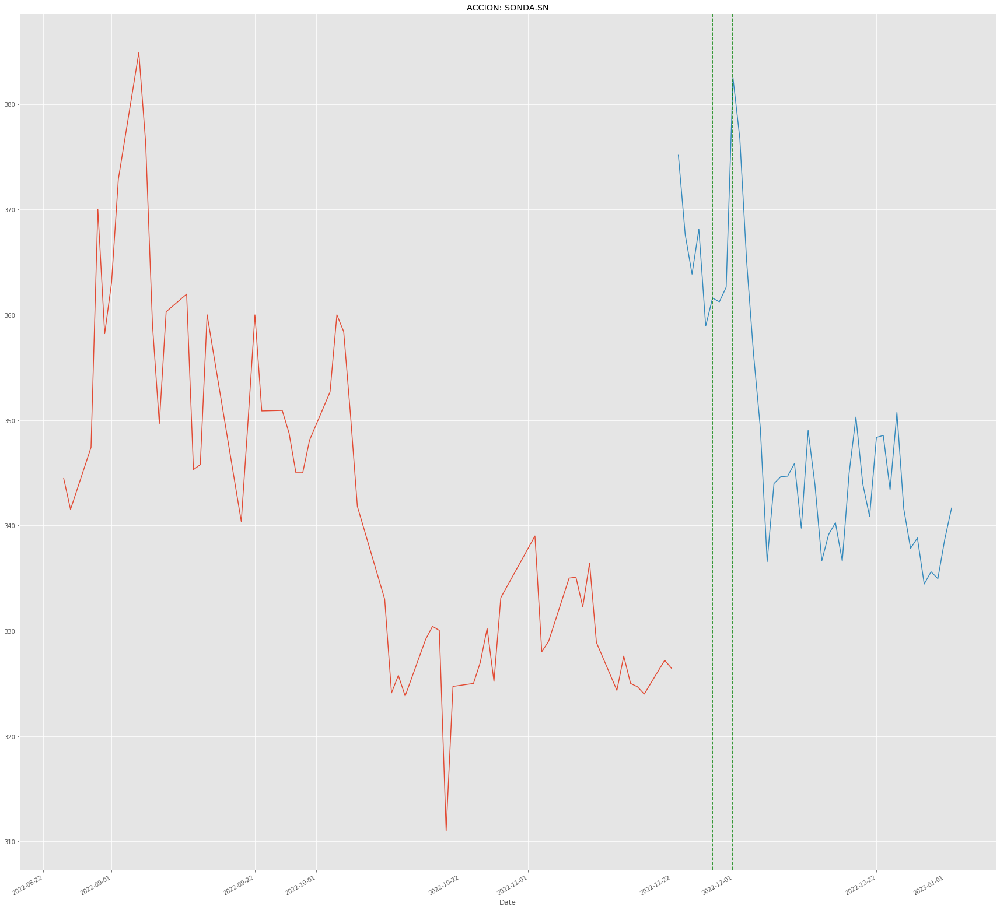


RIPLEY.SN
Date
2022-12-07    161.261076
2022-12-08    162.894070
2022-12-09    162.398478
2022-12-10    159.503699
2022-12-11    161.494949
2022-12-12    166.475236
2022-12-13    168.364582
2022-12-14    171.970761
2022-12-15    157.223142
2022-12-16    165.823636
2022-12-17    164.236121
2022-12-18    165.054662
2022-12-19    163.460770
2022-12-20    162.771365
2022-12-21    162.112693
2022-12-22    160.458186
2022-12-23    155.979997
2022-12-24    160.476907
2022-12-25    162.051008
2022-12-26    160.439172
2022-12-27    156.464949
2022-12-28    152.824177
2022-12-29    154.660357
2022-12-30    151.921607
2022-12-31    150.220480
2023-01-01    152.680772
2023-01-02    152.291639
2023-01-03    155.138297
2023-01-04    152.441801
2023-01-05    151.913177
Name: Forecast, dtype: float64
----------------------


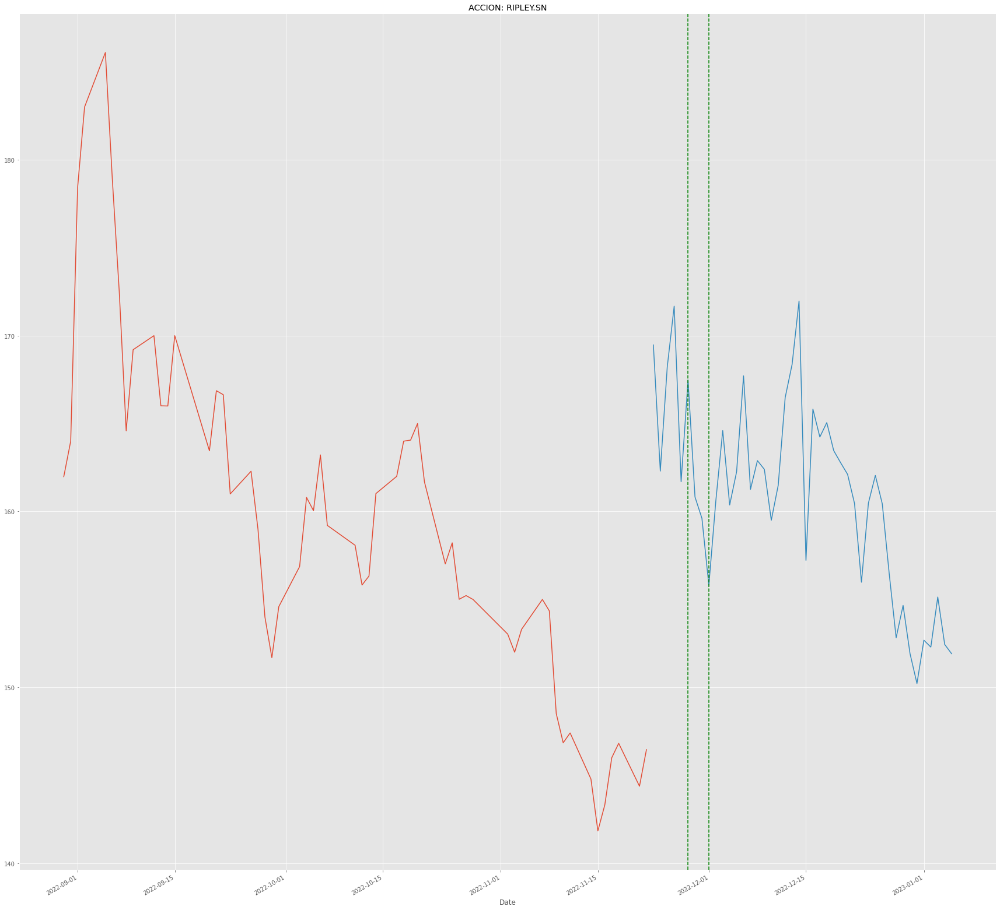


SECURITY.SN
Date
2022-12-21    146.233478
2022-12-22    143.754490
2022-12-23    143.086476
2022-12-24    147.202615
2022-12-25    147.842636
2022-12-26    148.251337
2022-12-27    146.325900
2022-12-28    146.845959
2022-12-29    151.128616
2022-12-30    149.046915
2022-12-31    150.342776
2023-01-01    149.937334
2023-01-02    149.530790
2023-01-03    158.542245
2023-01-04    157.691562
2023-01-05    152.812427
2023-01-06    153.368056
2023-01-07    155.342146
2023-01-08    155.098068
2023-01-09    153.170206
2023-01-10    150.470763
2023-01-11    150.817522
2023-01-12    154.958853
2023-01-13    156.216505
2023-01-14    153.793002
2023-01-15    154.123812
2023-01-16    155.309908
2023-01-17    154.921723
2023-01-18    158.237755
2023-01-19    163.654979
Name: Forecast, dtype: float64
----------------------


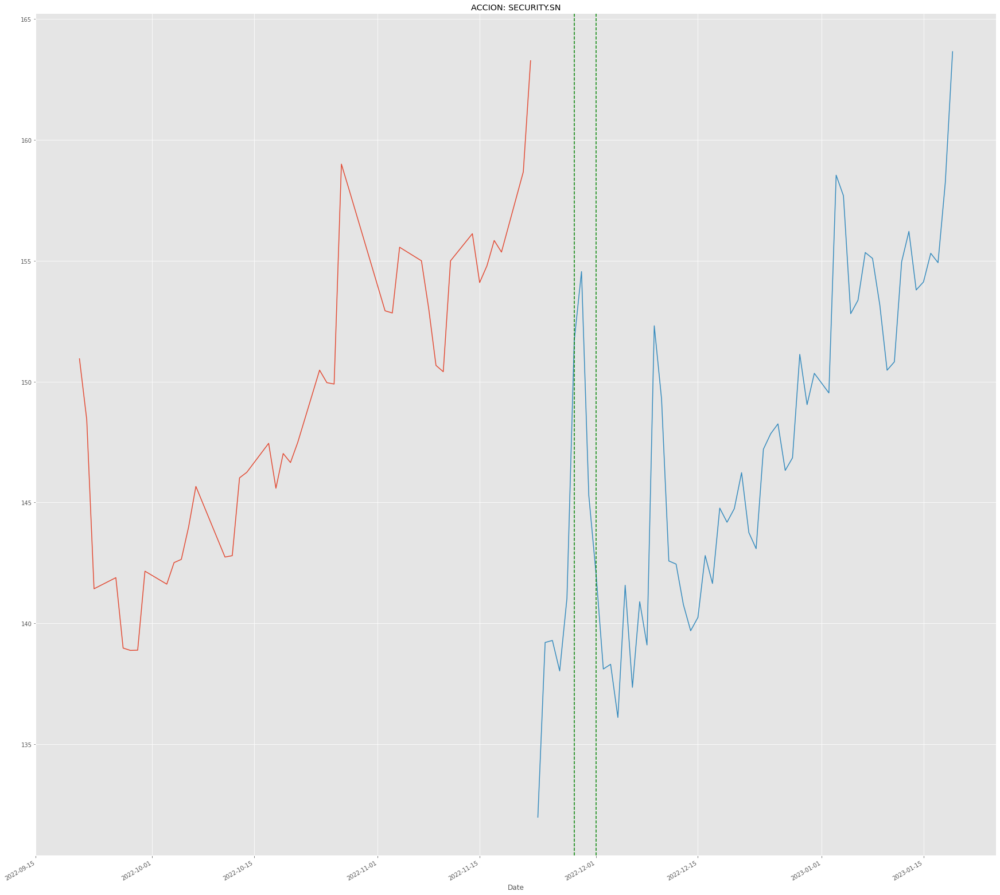


QUINENCO.SN
Date
2022-12-21    2445.243863
2022-12-22    2370.476356
2022-12-23    2346.820153
2022-12-24    2336.920180
2022-12-25    2405.682450
2022-12-26    2469.550417
2022-12-27    2573.020640
2022-12-28    2484.248745
2022-12-29    2960.542721
2022-12-30    2702.522426
2022-12-31    2667.234051
2023-01-01    2595.018963
2023-01-02    2555.843093
2023-01-03    2560.935150
2023-01-04    2593.654480
2023-01-05    2573.223231
2023-01-06    2636.086851
2023-01-07    2619.291193
2023-01-08    2605.225249
2023-01-09    2692.271145
2023-01-10    2683.788977
2023-01-11    2756.662393
2023-01-12    2794.485493
2023-01-13    2762.074802
2023-01-14    2768.443978
2023-01-15    2757.092471
2023-01-16    2760.941618
2023-01-17    2778.776306
2023-01-18    2789.802362
2023-01-19    2796.619413
Name: Forecast, dtype: float64
----------------------


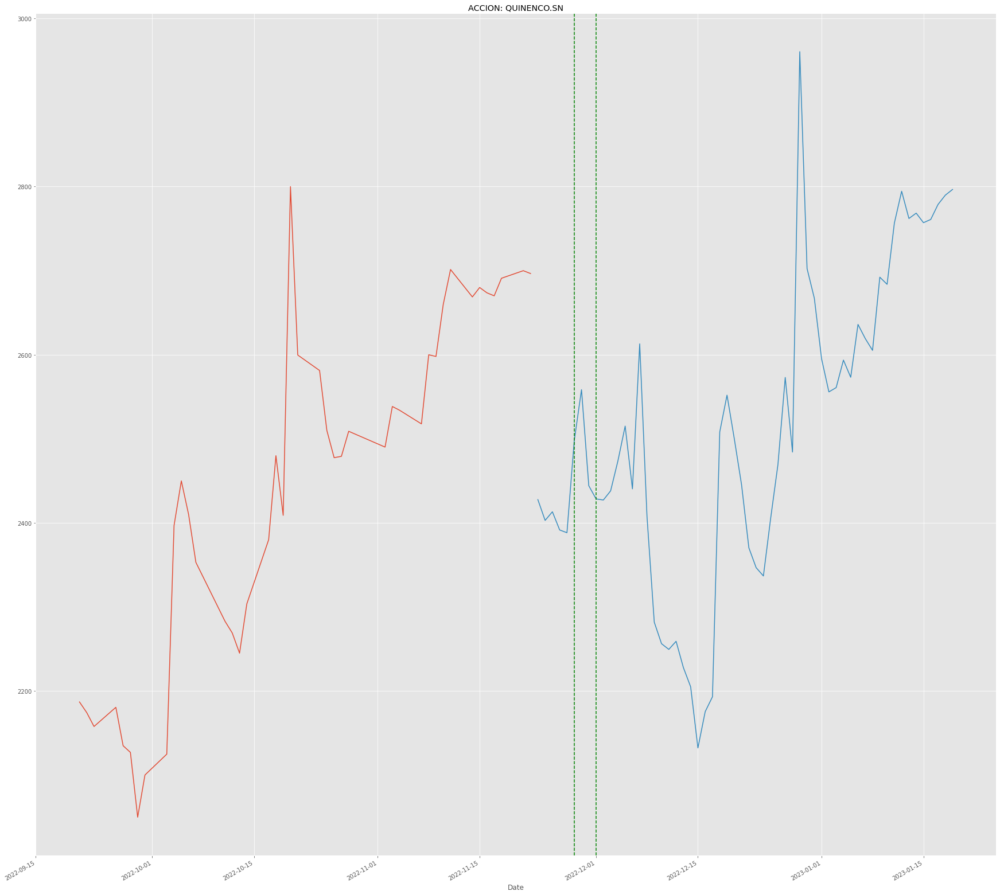


BESALCO.SN
Date
2022-12-01    313.844143
2022-12-02    309.333195
2022-12-03    299.832106
2022-12-04    297.615528
2022-12-05    297.680598
2022-12-06    302.289689
2022-12-07    307.001583
2022-12-08    316.380013
2022-12-09    328.537869
2022-12-10    339.477115
2022-12-11    347.667117
2022-12-12    344.272345
2022-12-13    340.563445
2022-12-14    341.449563
2022-12-15    340.304621
2022-12-16    340.285279
2022-12-17    335.725673
2022-12-18    337.739370
2022-12-19    334.303192
2022-12-20    336.253563
2022-12-21    335.794542
2022-12-22    333.774911
2022-12-23    324.463766
2022-12-24    318.716708
2022-12-25    314.235698
2022-12-26    320.626452
2022-12-27    323.035762
2022-12-28    323.235065
2022-12-29    323.278715
2022-12-30    319.062862
Name: Forecast, dtype: float64
----------------------


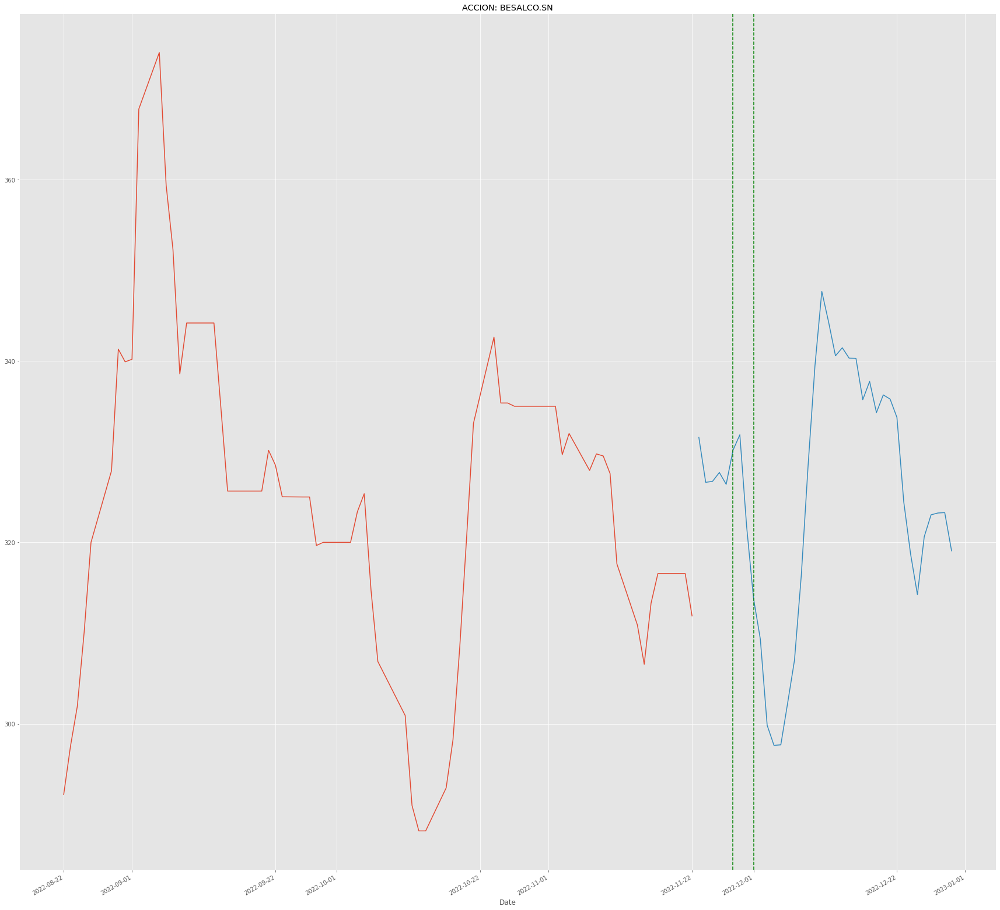


MASISA.SN
Date
2022-12-21    26.296014
2022-12-22    27.545679
2022-12-23    27.177433
2022-12-24    26.733990
2022-12-25    26.084118
2022-12-26    27.862306
2022-12-27    28.513461
2022-12-28    29.235990
2022-12-29    26.020043
2022-12-30    29.304160
2022-12-31    28.704789
2023-01-01    28.768250
2023-01-02    30.036318
2023-01-03    30.606021
2023-01-04    31.065221
2023-01-05    30.641016
2023-01-06    29.900395
2023-01-07    30.591130
2023-01-08    30.964317
2023-01-09    30.866336
2023-01-10    31.446050
2023-01-11    31.749633
2023-01-12    33.137076
2023-01-13    33.149973
2023-01-14    33.240629
2023-01-15    32.342802
2023-01-16    31.342869
2023-01-17    32.999220
2023-01-18    32.846954
2023-01-19    32.339267
Name: Forecast, dtype: float64
----------------------


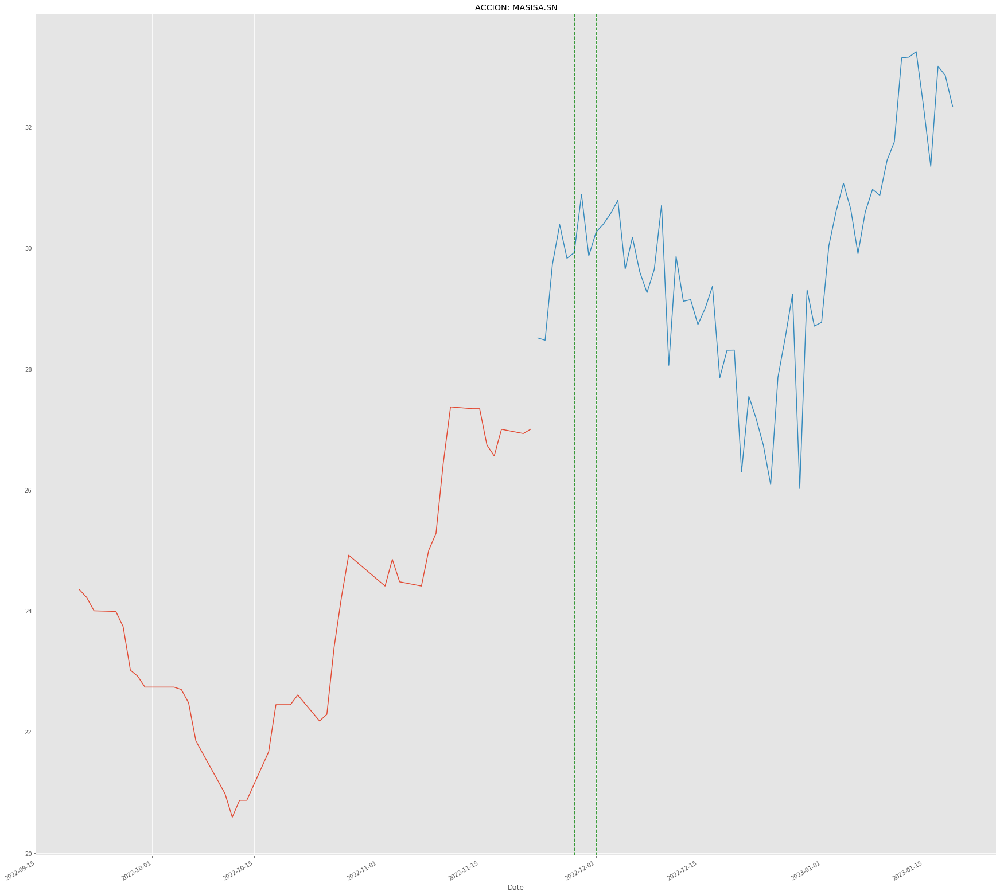


LTM.SN
Date
2022-12-21     234.698424
2022-12-22     271.356283
2022-12-23     257.643306
2022-12-24     297.505993
2022-12-25     295.316794
2022-12-26     281.588580
2022-12-27     285.284602
2022-12-28     260.923427
2022-12-29     376.030172
2022-12-30     314.090339
2022-12-31     257.093208
2023-01-01     301.894783
2023-01-02     258.769175
2023-01-03     304.028172
2023-01-04     334.023801
2023-01-05     286.011550
2023-01-06     450.906456
2023-01-07     320.832095
2023-01-08     328.451310
2023-01-09     450.584382
2023-01-10     342.656333
2023-01-11     328.091458
2023-01-12     308.416729
2023-01-13     582.354831
2023-01-14     220.360604
2023-01-15     233.928433
2023-01-16     341.379656
2023-01-17     241.372097
2023-01-18     244.396275
2023-01-19    8972.120620
Name: Forecast, dtype: float64
----------------------


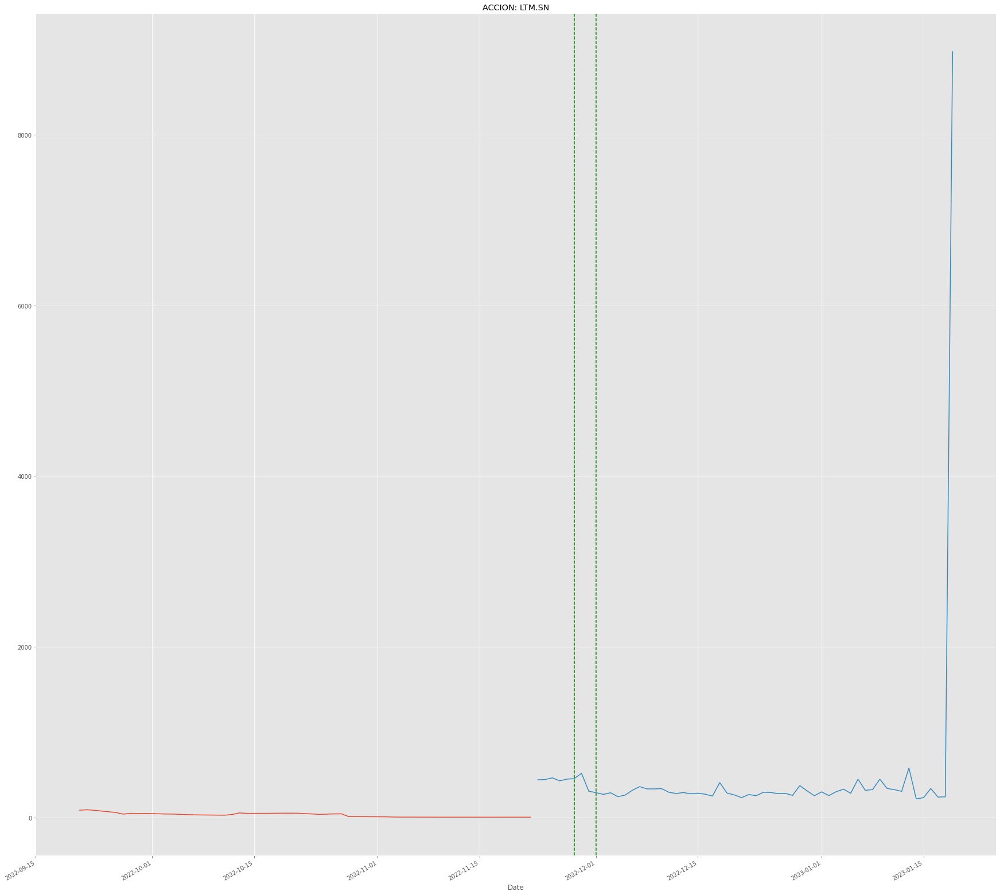


ENJOY.SN
Date
2022-11-27    2.088359
2022-11-28    2.600893
2022-11-29    2.316906
2022-11-30    2.243044
2022-12-01    1.927411
2022-12-02    2.370641
2022-12-03    3.833242
2022-12-04    5.676368
2022-12-05    1.548554
2022-12-06    2.476714
2022-12-07    2.428885
2022-12-08    2.648025
2022-12-09    2.580087
2022-12-10    2.576267
2022-12-11    2.244573
2022-12-12    2.135947
2022-12-13    1.912851
2022-12-14    2.157546
2022-12-15    2.154293
2022-12-16    2.302659
2022-12-17    2.448763
2022-12-18    2.058855
2022-12-19    2.398580
2022-12-20    2.564545
2022-12-21    2.358172
2022-12-22    3.514881
2022-12-23    2.478616
2022-12-24    2.700786
2022-12-25    2.519006
2022-12-26    2.437096
Name: Forecast, dtype: float64
----------------------


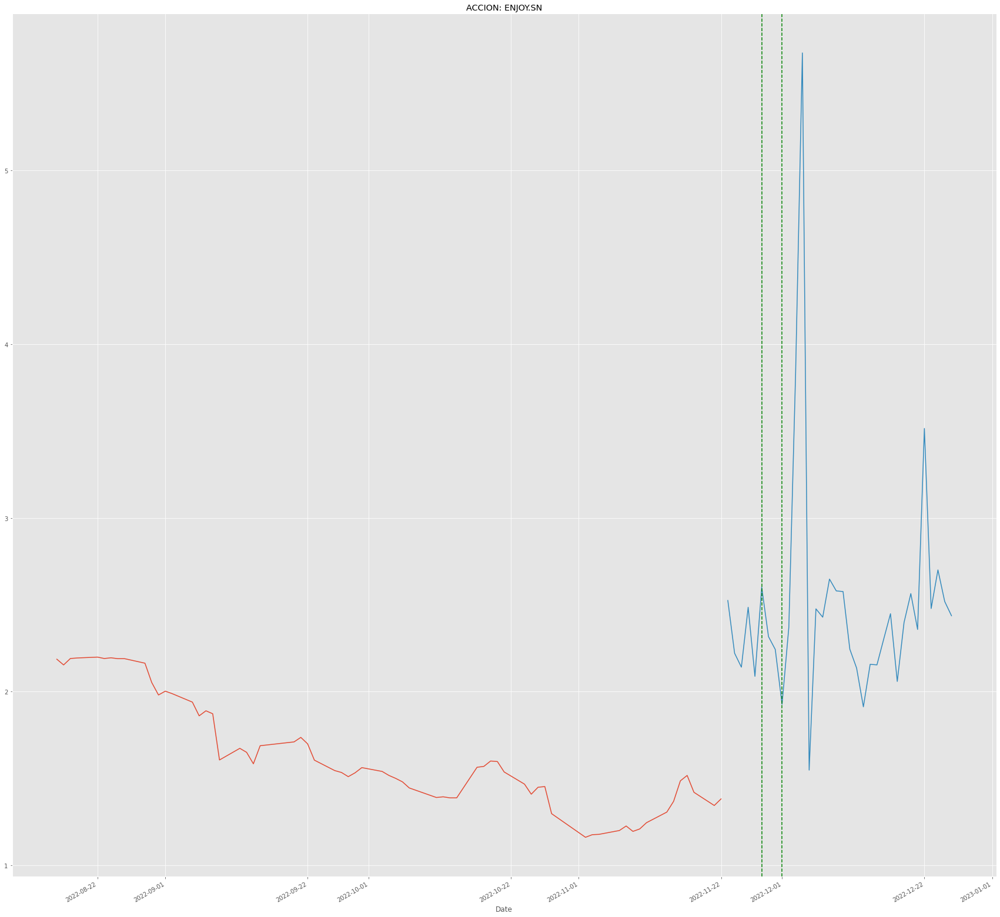


NVDA
Date
2022-12-21    114.434213
2022-12-22    118.008156
2022-12-23    111.421456
2022-12-24    118.039286
2022-12-25    118.568326
2022-12-26    119.599866
2022-12-27    121.537101
2022-12-28    123.609693
2022-12-29    125.011390
2022-12-30    131.506161
2022-12-31    127.793379
2023-01-01    130.411409
2023-01-02    137.027985
2023-01-03    134.818364
2023-01-04    135.429161
2023-01-05    130.569968
2023-01-06    133.250510
2023-01-07    139.881230
2023-01-08    141.921685
2023-01-09    144.330702
2023-01-10    136.641874
2023-01-11    155.205801
2023-01-12    160.890406
2023-01-13    160.980588
2023-01-14    164.471574
2023-01-15    156.740501
2023-01-16    154.430742
2023-01-17    152.396650
2023-01-18    151.789463
2023-01-19    158.467820
Name: Forecast, dtype: float64
----------------------


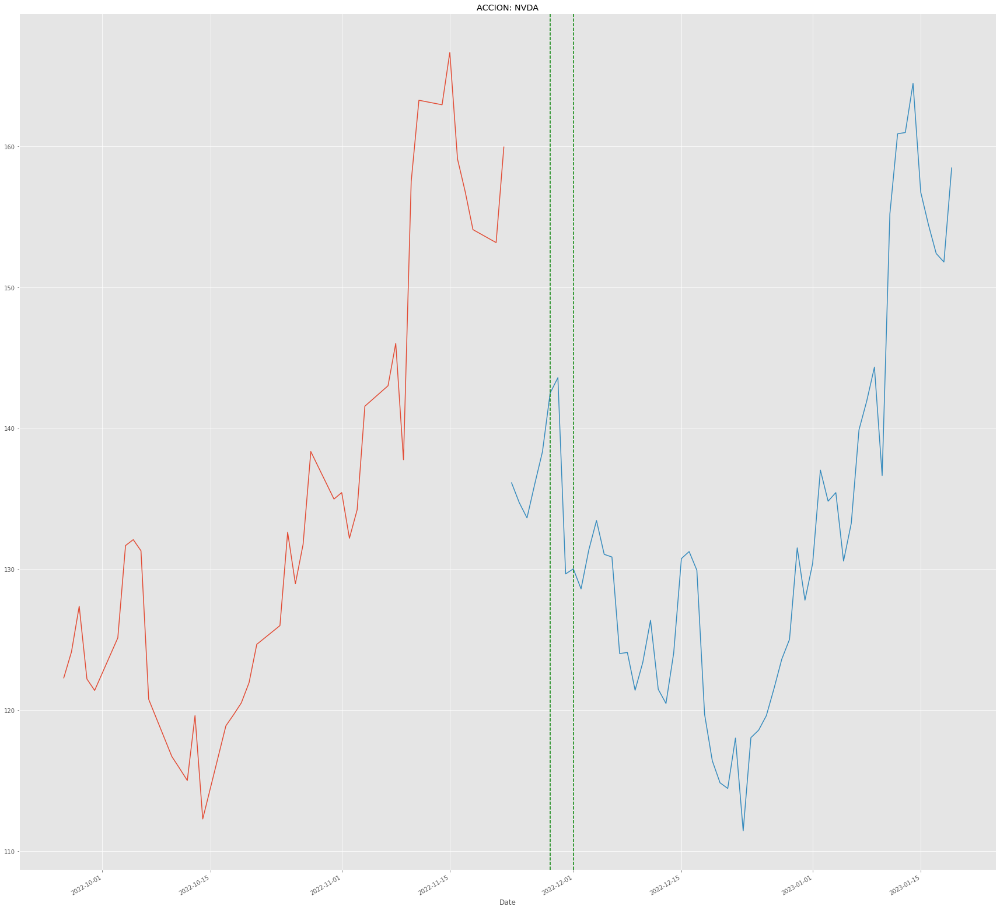


AMD
Date
2022-12-21    57.431032
2022-12-22    59.395325
2022-12-23    56.916159
2022-12-24    57.906956
2022-12-25    57.954743
2022-12-26    56.378376
2022-12-27    60.762146
2022-12-28    58.940053
2022-12-29    58.055025
2022-12-30    60.825870
2022-12-31    58.812388
2023-01-01    57.933700
2023-01-02    61.303879
2023-01-03    61.132853
2023-01-04    60.782265
2023-01-05    58.208010
2023-01-06    60.251744
2023-01-07    61.493679
2023-01-08    62.333702
2023-01-09    63.307268
2023-01-10    59.141142
2023-01-11    67.978591
2023-01-12    71.463793
2023-01-13    72.624768
2023-01-14    75.099053
2023-01-15    71.226360
2023-01-16    72.977084
2023-01-17    72.235983
2023-01-18    71.190048
2023-01-19    74.297448
Name: Forecast, dtype: float64
----------------------


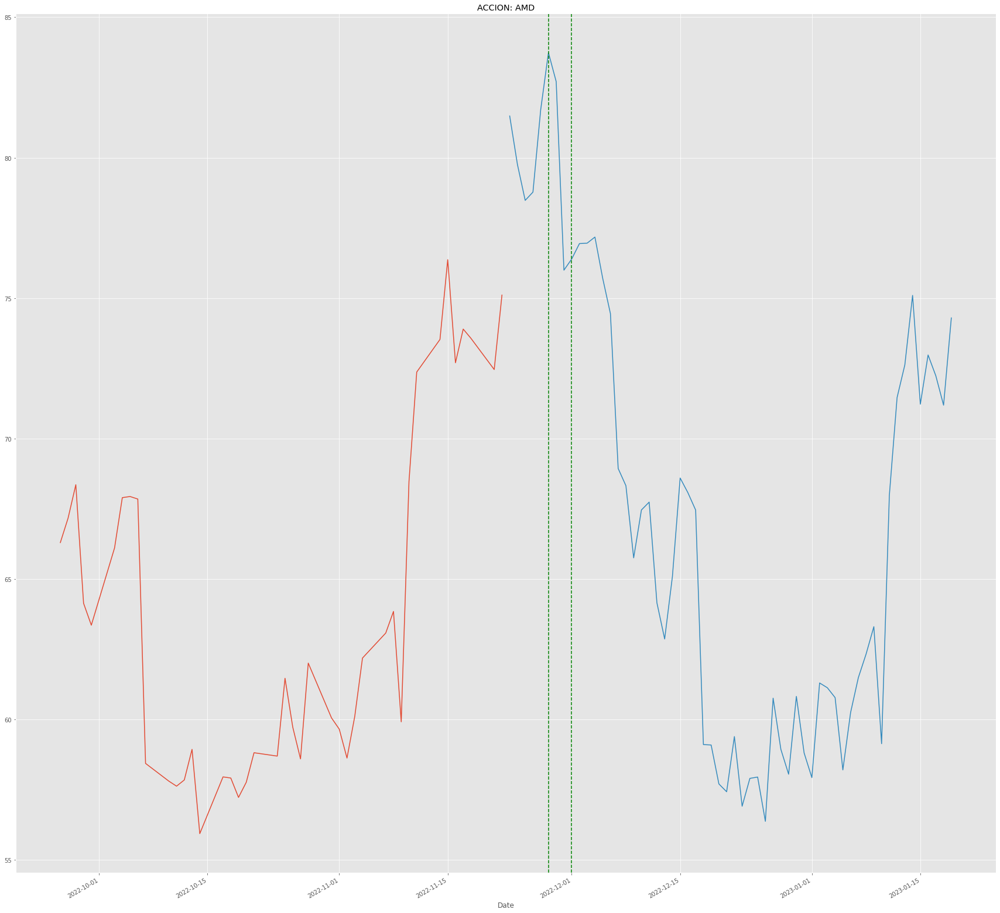


TSLA
Date
2022-11-25    214.233046
2022-11-26    220.323525
2022-11-27    204.818439
2022-11-28    217.184951
2022-11-29    217.897942
2022-11-30    218.354690
2022-12-01    210.509310
2022-12-02    212.494411
2022-12-03    209.219525
2022-12-04    220.051116
2022-12-05    221.450540
2022-12-06    221.442847
2022-12-07    225.138892
2022-12-08    222.798441
2022-12-09    223.104181
2022-12-10    211.737076
2022-12-11    212.860712
2022-12-12    205.559893
2022-12-13    195.404758
2022-12-14    191.074589
2022-12-15    177.262082
2022-12-16    190.788199
2022-12-17    194.980374
2022-12-18    189.519735
2022-12-19    192.531013
2022-12-20    184.188561
2022-12-21    181.239292
2022-12-22    178.181066
2022-12-23    166.838330
2022-12-24    168.586470
Name: Forecast, dtype: float64
----------------------


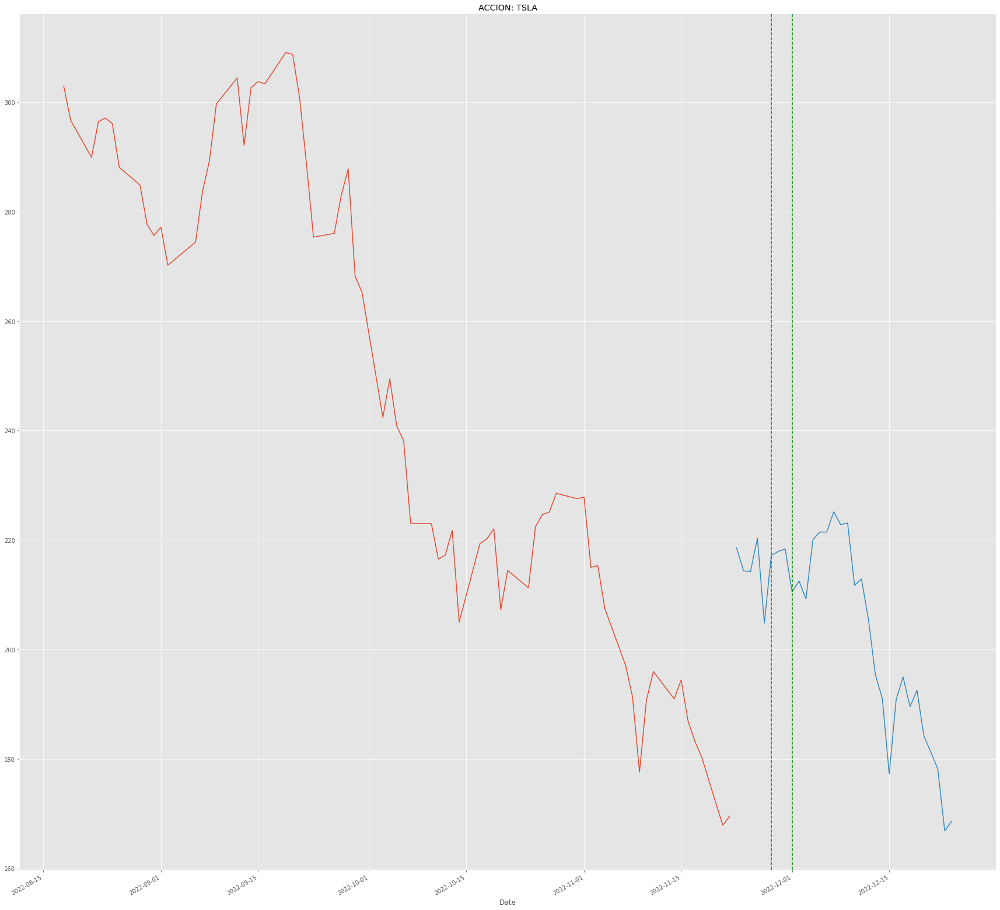


LMT
Date
2022-12-21    406.638477
2022-12-22    415.951233
2022-12-23    399.441903
2022-12-24    406.592401
2022-12-25    440.425242
2022-12-26    448.776158
2022-12-27    456.917674
2022-12-28    464.914282
2022-12-29    467.030635
2022-12-30    470.028472
2022-12-31    472.189782
2023-01-01    481.892235
2023-01-02    494.907784
2023-01-03    497.057333
2023-01-04    496.015316
2023-01-05    492.321070
2023-01-06    495.795833
2023-01-07    491.889073
2023-01-08    499.229552
2023-01-09    504.855370
2023-01-10    495.408830
2023-01-11    501.402830
2023-01-12    473.229856
2023-01-13    471.744591
2023-01-14    476.402014
2023-01-15    476.097668
2023-01-16    483.082732
2023-01-17    486.537912
2023-01-18    490.980938
2023-01-19    491.395450
Name: Forecast, dtype: float64
----------------------


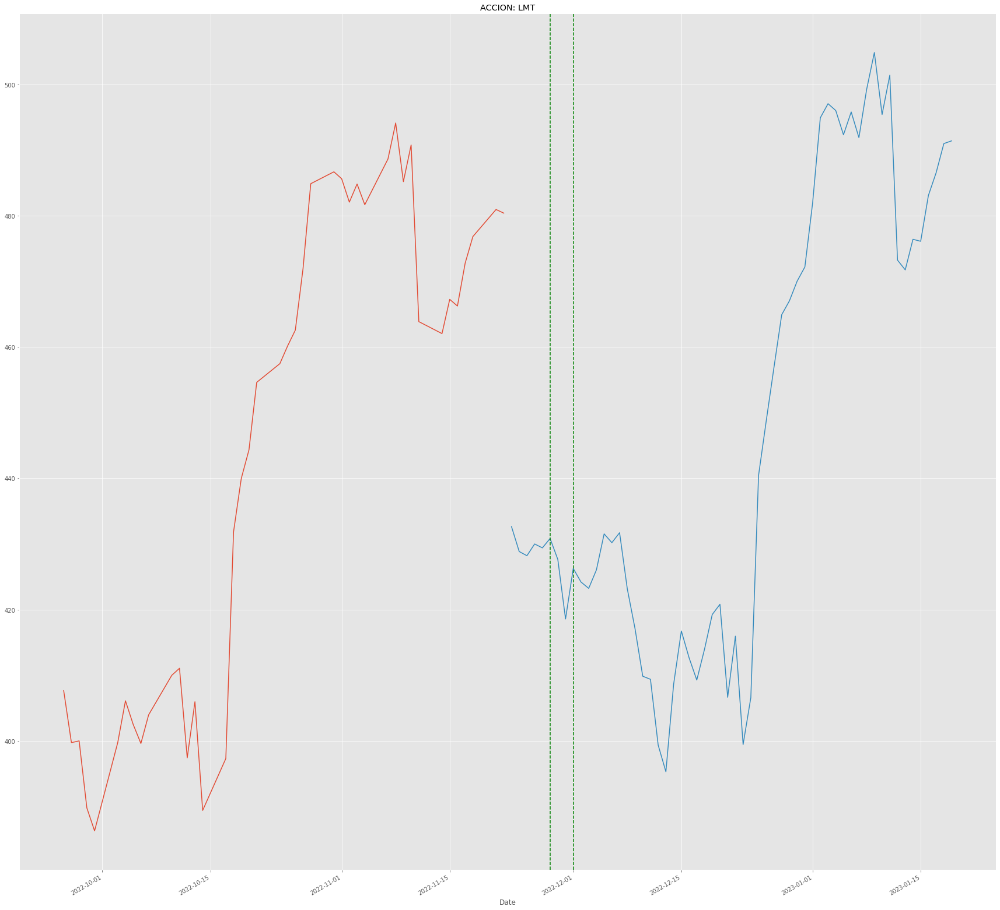


AMZN
Date
2022-12-21    113.779414
2022-12-22    112.981004
2022-12-23    107.191008
2022-12-24    114.450859
2022-12-25    117.004601
2022-12-26    116.116583
2022-12-27    114.628957
2022-12-28    119.914026
2022-12-29    120.731786
2022-12-30    121.472474
2022-12-31    116.648604
2023-01-01    111.744222
2023-01-02    103.963096
2023-01-03    103.447984
2023-01-04     97.696087
2023-01-05     92.933145
2023-01-06     89.786906
2023-01-07     91.791003
2023-01-08     91.434649
2023-01-09     90.779166
2023-01-10     87.096923
2023-01-11     97.160970
2023-01-12    101.565368
2023-01-13     99.276932
2023-01-14     99.809731
2023-01-15     98.156640
2023-01-16     95.652304
2023-01-17     95.138198
2023-01-18     93.397592
2023-01-19     93.705805
Name: Forecast, dtype: float64
----------------------


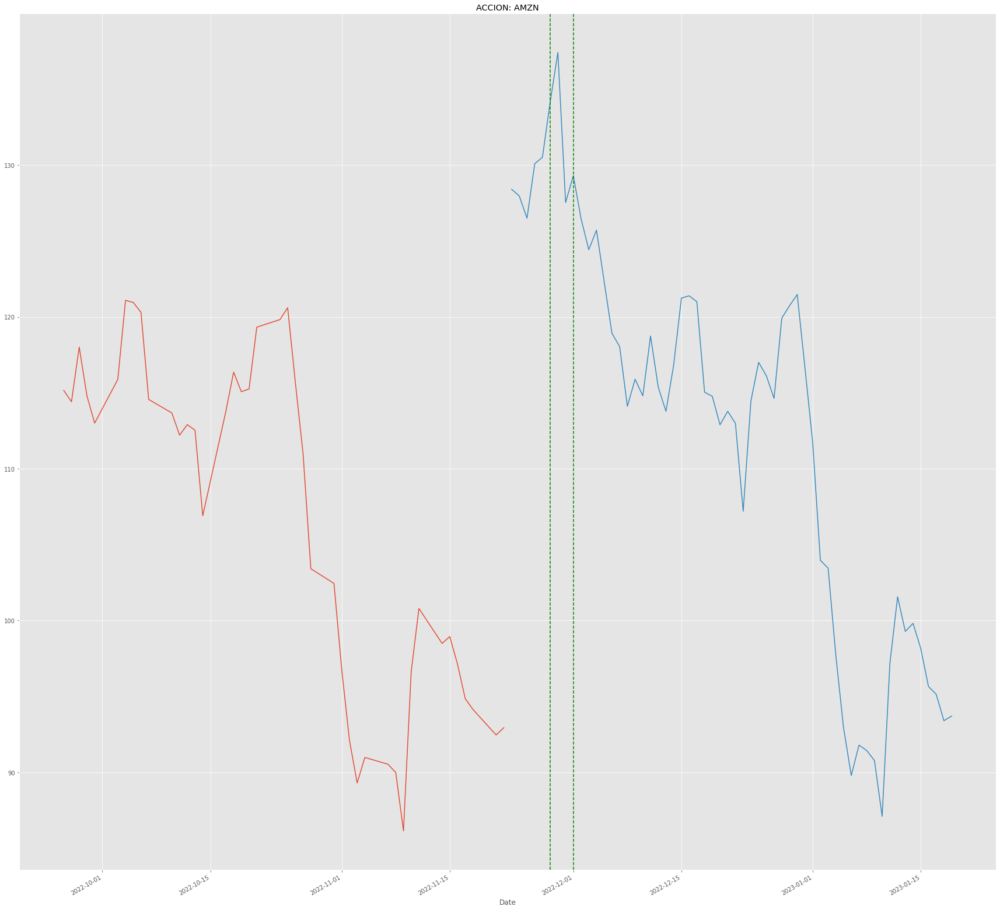


FB
Date
2022-10-17           NaN
2022-10-18           NaN
2022-10-19           NaN
2022-10-20           NaN
2022-10-21           NaN
2022-10-24           NaN
2022-10-25           NaN
2022-10-26           NaN
2022-10-27           NaN
2022-10-28           NaN
2022-10-31           NaN
2022-11-01           NaN
2022-11-02           NaN
2022-11-03           NaN
2022-11-04           NaN
2022-11-07           NaN
2022-11-08           NaN
2022-11-09           NaN
2022-11-10           NaN
2022-11-11           NaN
2022-11-14           NaN
2022-11-15           NaN
2022-11-16           NaN
2022-11-17           NaN
2022-11-18           NaN
2022-11-21           NaN
2022-11-22           NaN
2022-11-23    112.996919
2022-11-24    110.864659
2022-11-25    112.087587
Name: Forecast, dtype: float64
----------------------


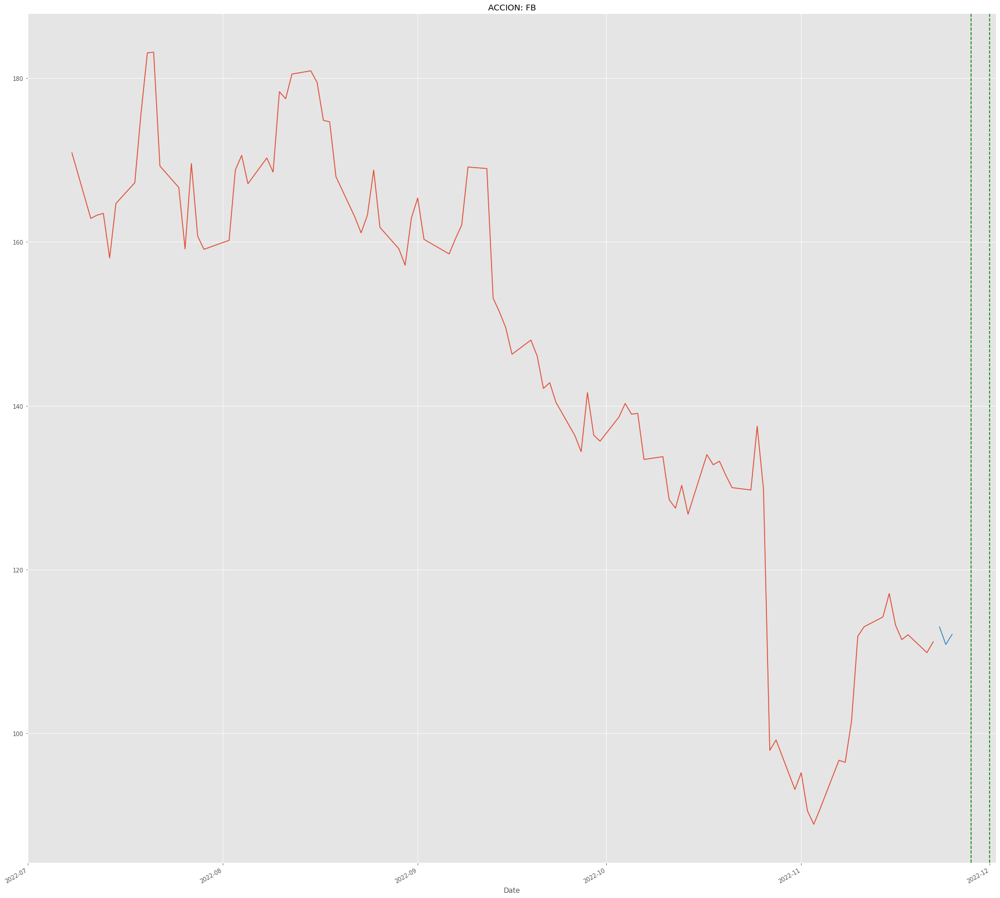


AAPL
Date
2022-12-21    142.139335
2022-12-22    146.931437
2022-12-23    142.377356
2022-12-24    146.322158
2022-12-25    147.661671
2022-12-26    147.689239
2022-12-27    147.879666
2022-12-28    151.283192
2022-12-29    153.391256
2022-12-30    156.342859
2022-12-31    153.227527
2023-01-01    148.605412
2023-01-02    159.650248
2023-01-03    157.377266
2023-01-04    154.672403
2023-01-05    148.873592
2023-01-06    142.753672
2023-01-07    142.284151
2023-01-08    142.934915
2023-01-09    143.547935
2023-01-10    138.800028
2023-01-11    151.023472
2023-01-12    153.894878
2023-01-13    152.492110
2023-01-14    154.211952
2023-01-15    152.937286
2023-01-16    154.978334
2023-01-17    155.498507
2023-01-18    152.202304
2023-01-19    154.427351
Name: Forecast, dtype: float64
----------------------


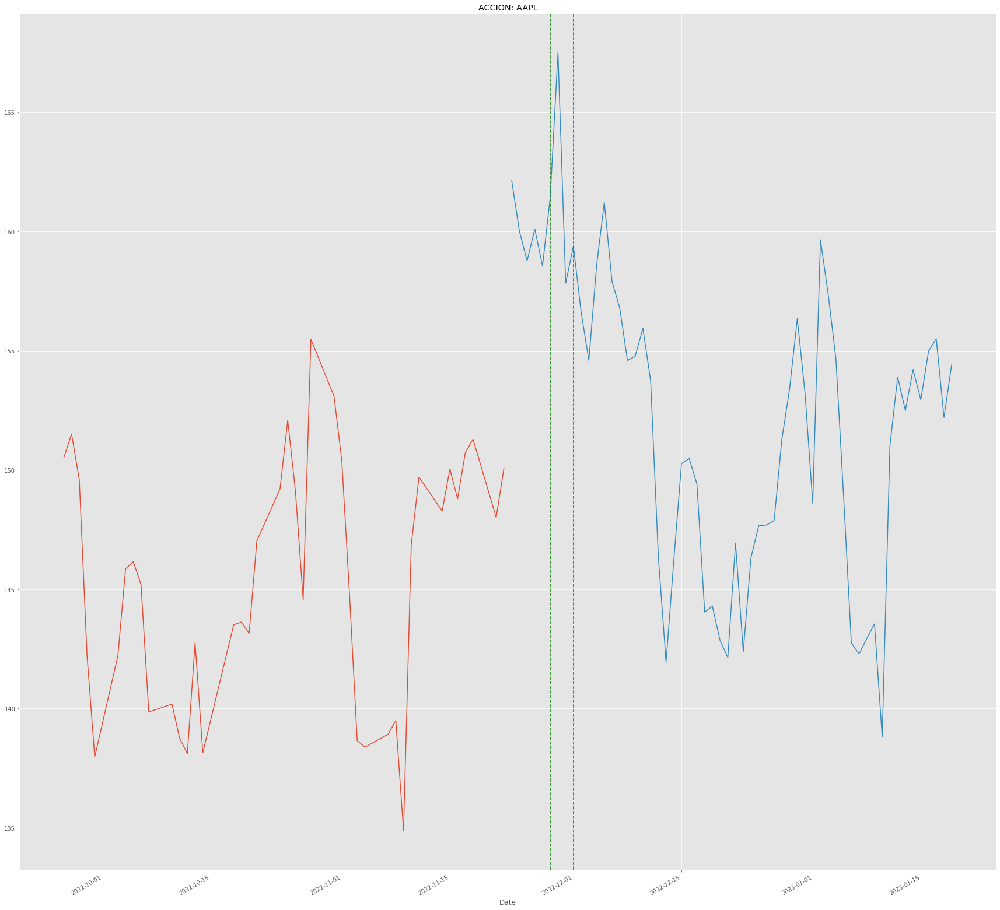


ALB
Date
2022-12-21    263.168954
2022-12-22    270.117576
2022-12-23    252.260656
2022-12-24    261.032329
2022-12-25    264.888864
2022-12-26    267.731048
2022-12-27    276.761443
2022-12-28    284.351334
2022-12-29    283.113543
2022-12-30    294.630147
2022-12-31    294.538780
2023-01-01    295.082289
2023-01-02    293.283607
2023-01-03    289.883154
2023-01-04    289.132873
2023-01-05    278.810729
2023-01-06    289.145134
2023-01-07    298.227543
2023-01-08    300.032398
2023-01-09    320.722527
2023-01-10    313.768013
2023-01-11    336.534777
2023-01-12    340.619409
2023-01-13    331.311151
2023-01-14    309.020810
2023-01-15    299.134814
2023-01-16    290.939620
2023-01-17    289.471065
2023-01-18    295.853173
2023-01-19    297.086297
Name: Forecast, dtype: float64
----------------------


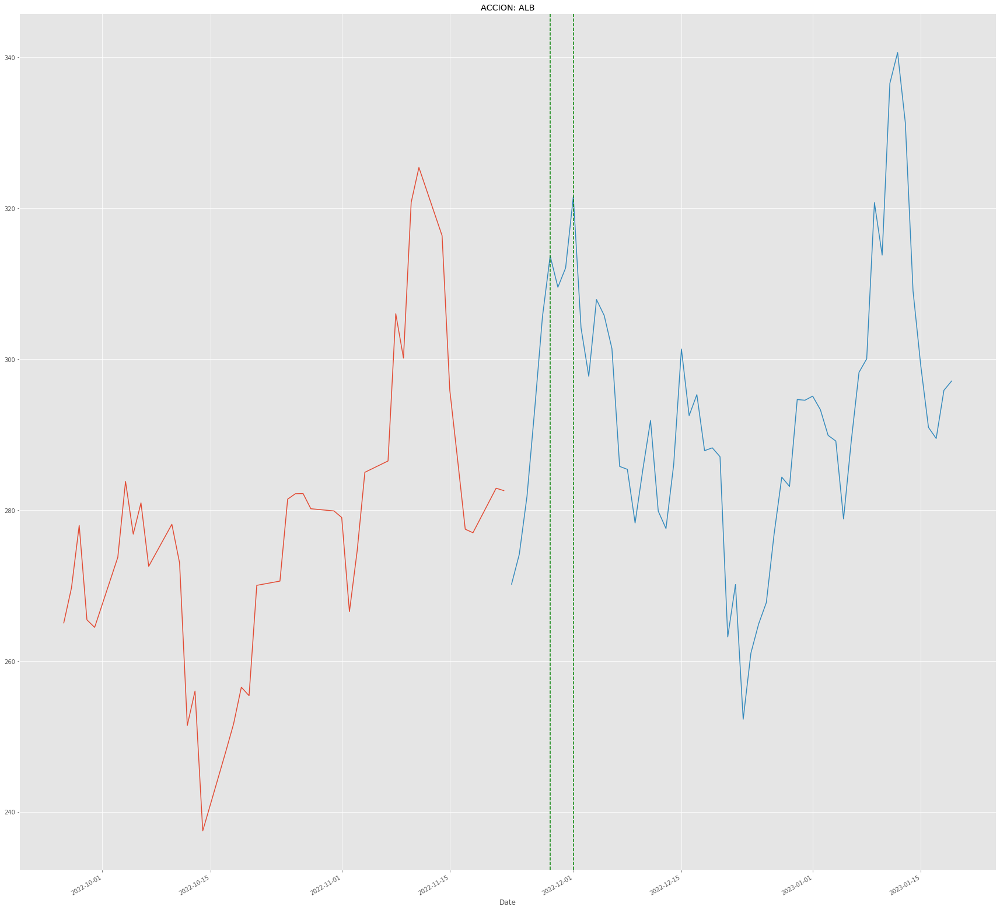


BABA
Date
2022-11-10          NaN
2022-11-11          NaN
2022-11-14          NaN
2022-11-15          NaN
2022-11-16          NaN
2022-11-17          NaN
2022-11-18          NaN
2022-11-21          NaN
2022-11-22          NaN
2022-11-23    66.446527
2022-11-24    71.902227
2022-11-25    68.637950
2022-11-26    66.458921
2022-11-27    66.775869
2022-11-28    69.048899
2022-11-29    67.474652
2022-11-30    66.490883
2022-12-01    72.583030
2022-12-02    72.064364
2022-12-03    70.172453
2022-12-04    67.620097
2022-12-05    71.581664
2022-12-06    73.173168
2022-12-07    73.504823
2022-12-08    81.915365
2022-12-09    80.937776
2022-12-10    86.171599
2022-12-11    82.845477
2022-12-12    79.137545
2022-12-13    77.246693
Name: Forecast, dtype: float64
----------------------


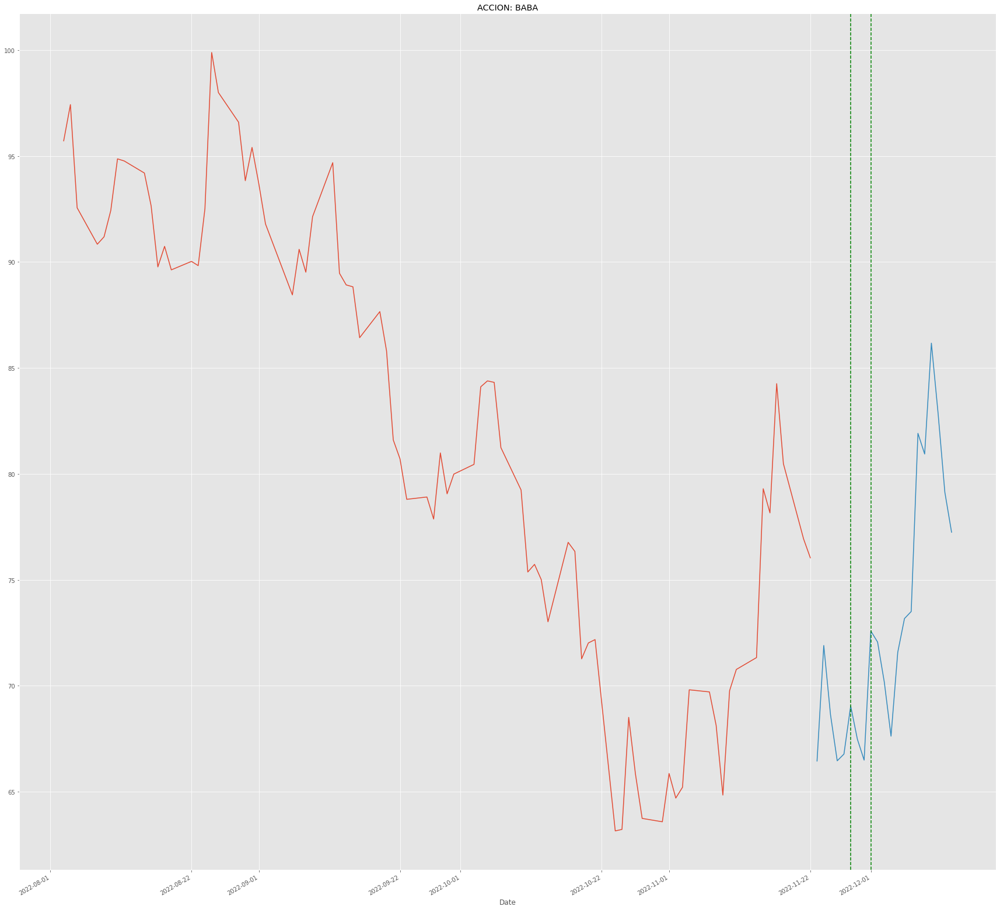


MELI
Date
2022-12-02     815.201775
2022-12-03     820.269702
2022-12-04     760.540501
2022-12-05     845.302022
2022-12-06     848.885330
2022-12-07     807.331348
2022-12-08     834.770572
2022-12-09     841.773723
2022-12-10     820.652645
2022-12-11     855.568474
2022-12-12     825.204789
2022-12-13     829.672042
2022-12-14     873.552985
2022-12-15     898.230784
2022-12-16     915.784229
2022-12-17     843.485094
2022-12-18     866.857677
2022-12-19     926.717946
2022-12-20     930.886111
2022-12-21     928.731446
2022-12-22     888.505743
2022-12-23     926.122860
2022-12-24     963.711044
2022-12-25     950.062827
2022-12-26    1007.181995
2022-12-27     959.466699
2022-12-28     918.587197
2022-12-29     950.343988
2022-12-30     952.683664
2022-12-31     949.454321
Name: Forecast, dtype: float64
----------------------


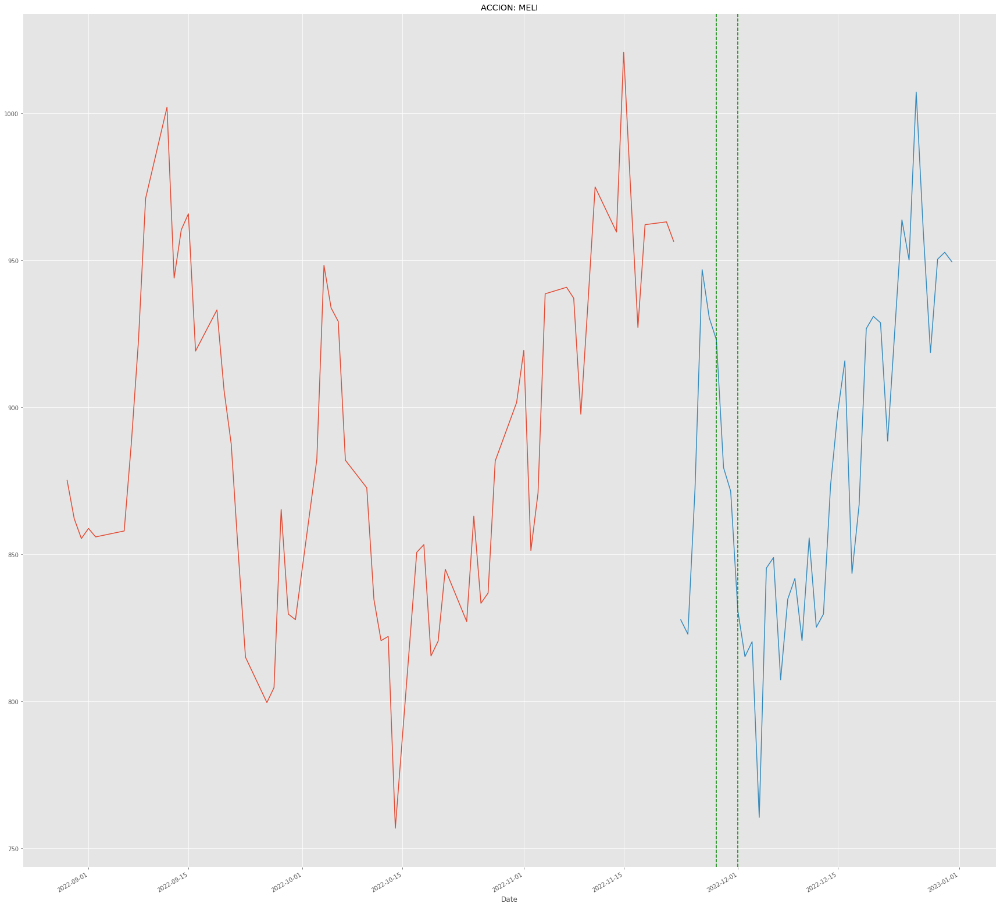


GPS
Date
2022-12-21    10.227617
2022-12-22    10.410600
2022-12-23    10.347902
2022-12-24    10.577410
2022-12-25    10.890647
2022-12-26    10.623272
2022-12-27     9.959321
2022-12-28    10.802414
2022-12-29    11.083685
2022-12-30    11.322310
2022-12-31    11.507444
2023-01-01    11.712423
2023-01-02    11.735517
2023-01-03    12.802407
2023-01-04    12.931576
2023-01-05    11.408837
2023-01-06    11.310682
2023-01-07    11.510398
2023-01-08    11.642525
2023-01-09    11.877482
2023-01-10    11.222667
2023-01-11    12.250831
2023-01-12    12.854520
2023-01-13    12.932548
2023-01-14    13.468827
2023-01-15    12.543983
2023-01-16    13.349823
2023-01-17    14.618400
2023-01-18    14.751664
2023-01-19    14.809621
Name: Forecast, dtype: float64
----------------------


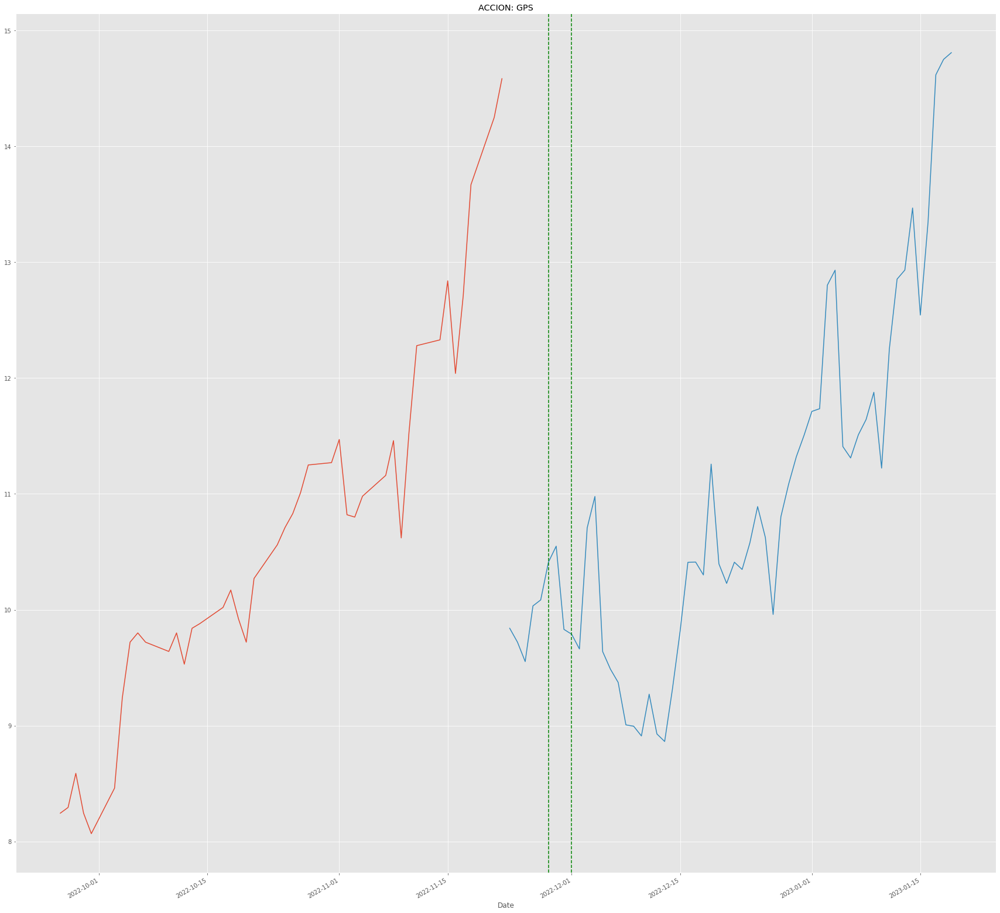


JNJ
Date
2022-12-21    164.054762
2022-12-22    166.725817
2022-12-23    166.058719
2022-12-24    168.140586
2022-12-25    167.752376
2022-12-26    166.283150
2022-12-27    166.975993
2022-12-28    170.375087
2022-12-29    172.495597
2022-12-30    172.177631
2022-12-31    173.668941
2023-01-01    173.759299
2023-01-02    176.380777
2023-01-03    175.704686
2023-01-04    174.780560
2023-01-05    171.943856
2023-01-06    172.234939
2023-01-07    172.932802
2023-01-08    174.510818
2023-01-09    175.330803
2023-01-10    173.936395
2023-01-11    176.107813
2023-01-12    170.970101
2023-01-13    173.443672
2023-01-14    174.024529
2023-01-15    174.890328
2023-01-16    176.323299
2023-01-17    177.720810
2023-01-18    178.603950
2023-01-19    179.576980
Name: Forecast, dtype: float64
----------------------


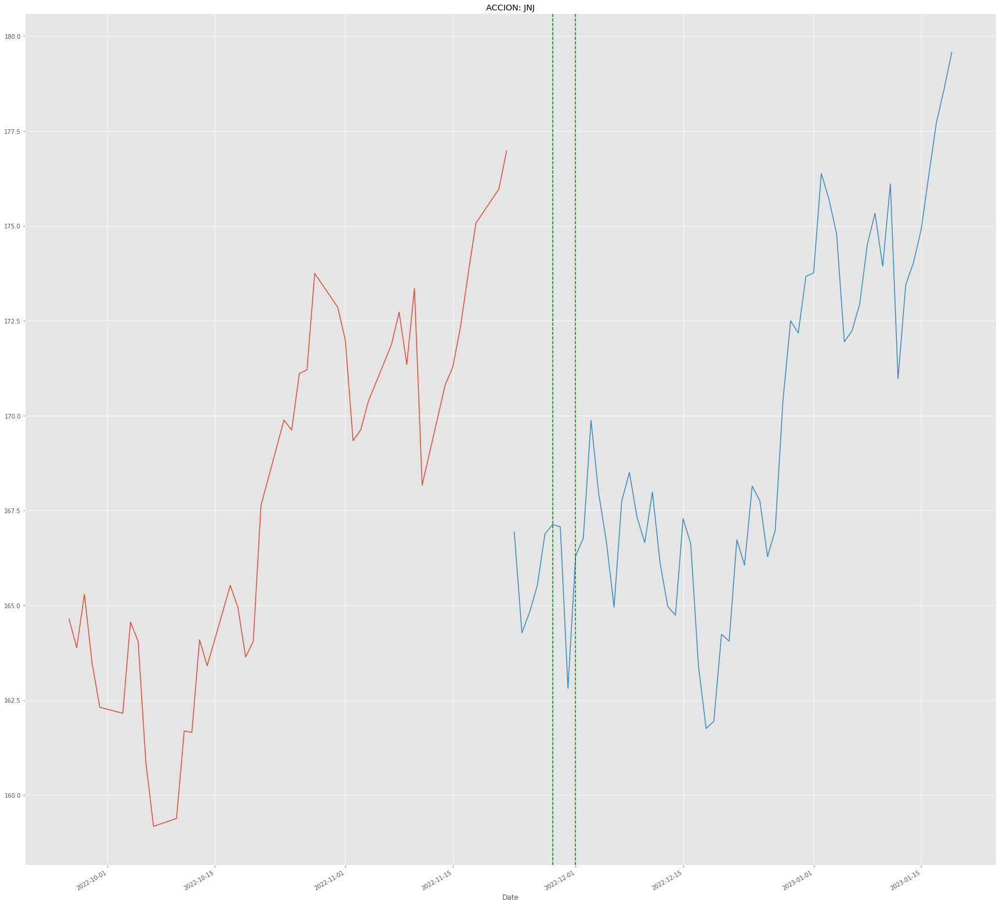


WMT
Date
2022-12-21    132.953153
2022-12-22    134.025817
2022-12-23    132.028968
2022-12-24    133.114195
2022-12-25    135.911570
2022-12-26    135.559778
2022-12-27    135.411005
2022-12-28    138.609010
2022-12-29    141.358677
2022-12-30    141.967928
2022-12-31    143.172024
2023-01-01    142.674958
2023-01-02    144.427190
2023-01-03    145.590342
2023-01-04    144.836964
2023-01-05    142.673559
2023-01-06    142.481232
2023-01-07    142.878874
2023-01-08    144.329042
2023-01-09    144.698854
2023-01-10    141.386741
2023-01-11    144.316546
2023-01-12    144.561823
2023-01-13    140.548151
2023-01-14    150.287504
2023-01-15    150.806393
2023-01-16    150.117626
2023-01-17    152.353786
2023-01-18    153.304570
2023-01-19    153.649644
Name: Forecast, dtype: float64
----------------------


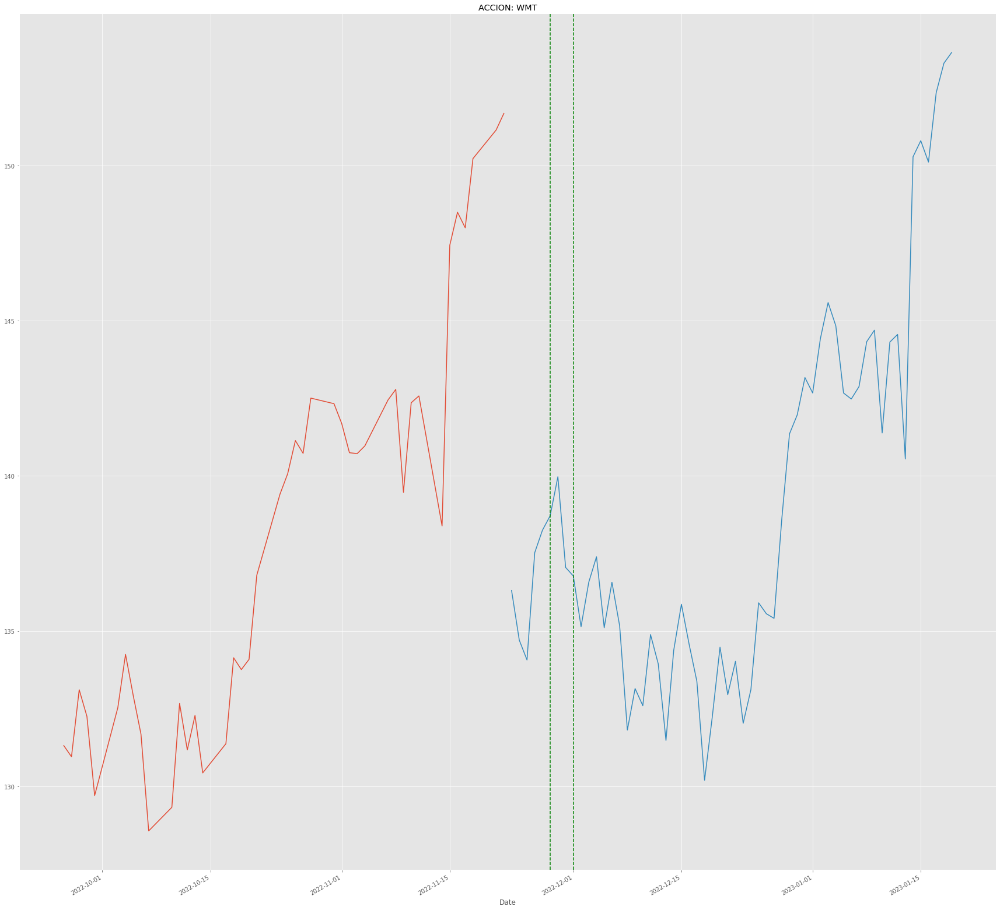

In [60]:
for i in ipsa:
  globals()[str('dfreg')+str(i).replace(".","")]['Adj Close'].tail(100).plot()
  globals()[str('dfreg')+str(i).replace(".","")]['Forecast'].tail(100).plot()

  print(i)
  #print(globals()[str('dfreg')+str(i).replace(".","")]['Adj Close'])
  print(globals()[str('dfreg')+str(i).replace(".","")]['Forecast'].tail(30))
  print("----------------------")
  plt.title("ACCION: "+ str(i))
  plt.axvline(x = '2022-12-01', ymin = 0, ymax = 1, linestyle="--",color ='green')
  plt.axvline(x = '2022-11-28', ymin = 0, ymax = 1, linestyle="--",color ='green')

  plt.show()
  print()



In [46]:
for i in ipsa:
  print(i)
  #print(globals()[str('dfreg')+str(i).replace(".","")])
  #print(globals()[str('dfreg')+str(i).replace(".","")]['Adj Close'])
  print(globals()[str('dfreg')+str(i).replace(".","")]['Forecast'])
  

  







HLAG.DE
Date
2015-11-06           NaN
2015-11-09           NaN
2015-11-10           NaN
2015-11-11           NaN
2015-11-12           NaN
                 ...    
2022-12-06    186.504455
2022-12-07    188.094176
2022-12-08    186.214676
2022-12-09    189.437815
2022-12-10    193.097067
Name: Forecast, Length: 1808, dtype: float64
MAERSK-B.CO
Date
2000-01-03             NaN
2000-01-04             NaN
2000-01-05             NaN
2000-01-06             NaN
2000-01-07             NaN
                  ...     
2023-01-15    14802.094088
2023-01-16    14947.803112
2023-01-17    14982.637516
2023-01-18    14856.050622
2023-01-19    14936.102815
Name: Forecast, Length: 5850, dtype: float64
VALE
Date
2002-03-21          NaN
2002-03-22          NaN
2002-03-25          NaN
2002-03-26          NaN
2002-03-27          NaN
                ...    
2023-01-10    14.861581
2023-01-11    14.916356
2023-01-12    14.862217
2023-01-13    14.553633
2023-01-14    14.439361
Name: Forecast, Length: 5260, dtyp

# Challenges (To Be Continued):
* Assuming economic qualitative factors such as news (news sourcing and sentimental analysis)
* Assuming economic quantitative factors such as HPI of a certain country, economic inequality among origin of company
* Cleaning out the data
* Importing data files

# Next lesson:
## Lesson 4 Basic Python for Data Analytics (Predicting Employee Retention)

# Python: How to Get Live Market Data (Less Than 0.1-Second Lag).
This article is going to be a bit special. I am going to test the latest release from Yahoo Finance API for Python, which provide the possibility to get live data with less than a second lag for free.

Before to start
First of all, if you want to track my progress and before to start, you will need to have installed on your machine a Python 3 version and the following packages:
Pandas
NumPy
Yfinance
Plotly (Not mandatory, but useful for plotting)
If any of these packages are not already installed, you can use the pip command, as shown below.

In [47]:
!pip install yfinance
!pip install plotly

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Once you have ensured that the following packages are installed, we can start.
If you already have experience with Python, you can jump to the second step. The first step will consist of importing data.
I. Import package
The first step will consist of importing the necessary packages.
You will start by importing your packages previously installed by using the following lines of code:

In [48]:
# Raw Package
import numpy as np
import pandas as pd

#Data Source
import yfinance as yf

#Data viz
import plotly.graph_objs as go


def print_real_time(accion_predecirss):
  #Interval required 1 minute
  accion = accion_predecirss
  data = yf.download(tickers=accion, period='1d', interval='1m')

  #declare figure
  fig = go.Figure()


  #Candlestick
  fig.add_trace(go.Candlestick(x=data.index,
                  open=data['Open'],
                  high=data['High'],
                  low=data['Low'],
                  close=data['Close'], name = 'market data'))

  # Add titles
  fig.update_layout(
      title='EVOLUCIÓN EN VIVO DEL PRECIO DE LA ACCIÓN: '+accion,
      yaxis_title='PRECIO DE LAS ACCION ' + accion)

  # X-Axes
  fig.update_xaxes(
      rangeslider_visible=True,
      rangeselector=dict(
          buttons=list([
              dict(count=15, label="15m", step="minute", stepmode="backward"),
              dict(count=45, label="45m", step="minute", stepmode="backward"),
              dict(count=1, label="HTD", step="hour", stepmode="todate"),
              dict(count=3, label="3h", step="hour", stepmode="backward"),
              dict(step="all")
          ])
      )
  )

  #Show
  fig.show()

  #while True:
    #print(data)

for count, value in enumerate(ipsa):
  print("*********************************************************")
  print(count, value)
  print_real_time(value)
  print("*********************************************************")


*********************************************************
0 HLAG.DE
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
1 MAERSK-B.CO
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
2 VALE
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
3 INVERCAP.SN
[*********************100%***********************]  1 of 1 completed

1 Failed download:
- INVERCAP.SN: No data found for this date range, symbol may be delisted


*********************************************************
*********************************************************
4 SQM-B.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
5 CHILE.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
6 BSANTANDER.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
7 COPEC.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
8 CENCOSUD.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
9 FALABELLA.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
10 ENELAM.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
11 CMPC.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
12 BCI.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
13 VAPORES.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
14 CAP.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
15 CCU.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
16 ENELCHILE.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
17 ANDINA-B.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
18 CONCHATORO.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
19 PARAUCO.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
20 ITAUCORP.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
21 AGUAS-A.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
22 COLBUN.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
23 CENCOSHOPP.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
24 ENTEL.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
25 MALLPLAZA.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
26 IAM.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
27 SMU.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
28 ECL.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
29 SONDA.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
30 RIPLEY.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
31 SECURITY.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
32 QUINENCO.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
33 BESALCO.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
34 MASISA.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
35 LTM.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
36 ENJOY.SN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
37 NVDA
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
38 AMD
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
39 TSLA
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
40 LMT
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
41 AMZN
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
42 FB
[*********************100%***********************]  1 of 1 completed

1 Failed download:
- FB: No data found, symbol may be delisted


*********************************************************
*********************************************************
43 AAPL
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
44 ALB
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
45 BABA
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
46 MELI
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
47 GPS
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
48 JNJ
[*********************100%***********************]  1 of 1 completed


*********************************************************
*********************************************************
49 WMT
[*********************100%***********************]  1 of 1 completed


*********************************************************


In [49]:
def make_forecast(ticker, periods, hist='max'):
    """
    forecast the given ticker (stock) period days into the future (from today)

    inputs
    ------
    > ticker
        >> ticker of stock to forecast
    > periods
        >> number of days into the future to forecast (from today's date)
    > hist
        >> amount of historical data to consider
            > default: max
            > options: 1d, 5d, 1mo, 3mo, 6mo, 1y, 2y, 5y, 10y, ytd, max
    """
    # pull historical data from yahoo finance
    stock_data = yf.Ticker(ticker)

    hist_data = stock_data.history(hist, auto_adjust=True)

    # create new dataframe to hold dates (ds) & adjusted closing prices (y)
    df = pd.DataFrame()

    df['ds'] = hist_data.index.values
    df['y'] = hist_data['Close'].values

    # create a Prophet model from that data
    m = Prophet(daily_seasonality=False)
    m.fit(df)

    future = m.make_future_dataframe(periods, freq='D')

    forecast = m.predict(future)

    m.plot(forecast)

    #return forecast